# TO DO:

- Automate for multiple config-files.
- Histogram of angle(substrate segments, z) - or angle(substrate segments, theta_z)?

In [38]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [39]:
! gpustat

comp-gpu07          Sun Mar 24 17:37:29 2024  550.67
[0] Quadro RTX 5000 | 22°C,   0 % |   155 / 16384 MB | siwin(152M)
[1] Quadro RTX 5000 | 24°C,   0 % |     0 / 16384 MB |
[2] Quadro RTX 5000 | 23°C,   0 % |     0 / 16384 MB |
[3] Quadro RTX 5000 | 24°C,   0 % |     0 / 16384 MB |
[4] Quadro RTX 5000 | 22°C,   0 % |     0 / 16384 MB |
[5] Quadro RTX 5000 | 23°C,   0 % |     0 / 16384 MB |
[6] Quadro RTX 5000 | 22°C,   0 % |     0 / 16384 MB |
[7] Quadro RTX 5000 | 25°C,   0 % |     0 / 16384 MB |


In [40]:
# Make GPU visible. Must be done before torch is imported.
import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "0" #index of gpu of interest

# import
import numpy as np
import torch
import pytorch3d.io
import os
import sys
import matplotlib.pyplot as plt
from matplotlib import colors
from tqdm.auto import tqdm
import pickle
import scipy.stats
from scipy.optimize import curve_fit
import sklearn.metrics

sys.path.append('../../')
from MCDC_analysis.src.MCDCExperimentWithSusceptibility import MCDCExperimentWithSusceptibility
from ISMRM2020.src.PathPolice_ISMRM2020 import PathPolice_ISMRM2020 as PathPolice

import warnings
warnings.filterwarnings("ignore")

In [41]:
torch.set_default_dtype(torch.float64)

# DEVICE

Check available devices. Choose GPU if one is available. Else choose cpu.

In [42]:
# device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
device = 'cpu'

print(f'number of devices: {torch.cuda.device_count()}')
print(f'device: {device}')

number of devices: 1
device: cpu


# PLOTTING SPECS

In [43]:
size_font = 11

plt.rc('font', family='serif')
plt.rc('font', size=size_font)        # controls default text sizes
plt.rc('axes', titlesize=size_font)   # fontsize of the axes title
plt.rc('axes', labelsize=size_font)   # fontsize of the x and y labels
plt.rc('xtick', labelsize=size_font)  # fontsize of the tick labels
plt.rc('ytick', labelsize=size_font)  # fontsize of the tick labels
plt.rc('legend', fontsize=size_font)  # legend fontsize
plt.rc('figure', titlesize=size_font) # fontsize of the figure title

plt.rcParams['figure.dpi'] = 400

# #### center plots
# from IPython.core.display import HTML as Center

# Center(""" <style>
# .output_png {
   
#     text-align: center;
#     vertical-align: middle;
# }
# </style> """)

In [44]:
figsize_ADC_3x1 = (7.5, 3)
figsize_e1_1x1 = (2.5, 3)


lw = 2
s = 36#13

marker_intra = 'o'
marker_extra = 'x'#'o'
marker_intra_extra = 's'#'o'

In [45]:
plotting_specs = {}

plotting_specs['synchrotron-G1-z_aligned'] = {}
plotting_specs['synchrotron-G1-z_aligned']['marker'] = 'o'
plotting_specs['synchrotron-G1-z_aligned']['color'] = 'tab:olive'

plotting_specs['synchrotron-G3-z_aligned'] = {}
plotting_specs['synchrotron-G3-z_aligned']['marker'] = 'o'
plotting_specs['synchrotron-G3-z_aligned']['color'] = 'tab:green'

plotting_specs['synchrotron-G4-z_aligned'] = {}
plotting_specs['synchrotron-G4-z_aligned']['marker'] = 'o'
plotting_specs['synchrotron-G4-z_aligned']['color'] = 'tab:cyan'

plotting_specs['synchrotron-G5-z_aligned'] = {}
plotting_specs['synchrotron-G5-z_aligned']['marker'] = 'o'
plotting_specs['synchrotron-G5-z_aligned']['color'] = 'tab:blue'

plotting_specs['synchrotron-G6-z_aligned'] = {}
plotting_specs['synchrotron-G6-z_aligned']['marker'] = 'o'
plotting_specs['synchrotron-G6-z_aligned']['color'] = 'tab:purple'

In [46]:
colors = ['tab:blue', 'tab:orange', 'tab:green', 'tab:purple', 'tab:red', 
          'tab:brown', 'tab:pink', 'tab:grey', 'tab:olive', 'tab:cyan',
          'yellow', 'lime',
          'tab:blue', 'tab:orange', 'tab:green', 'tab:purple', 'tab:red', 
          'tab:brown', 'tab:pink', 'tab:grey', 'tab:olive', 'tab:cyan',
          'yellow', 'lime',
          'tab:blue', 'tab:orange', 'tab:green', 'tab:purple', 'tab:red', 
          'tab:brown', 'tab:pink', 'tab:grey', 'tab:olive', 'tab:cyan',
          'yellow', 'lime',
          'tab:blue', 'tab:orange', 'tab:green', 'tab:purple', 'tab:red', 
          'tab:brown', 'tab:pink', 'tab:grey', 'tab:olive', 'tab:cyan',
          'yellow', 'lime',
          'tab:blue', 'tab:orange', 'tab:green', 'tab:purple', 'tab:red', 
          'tab:brown', 'tab:pink', 'tab:grey', 'tab:olive', 'tab:cyan',
          'yellow', 'lime',
          'tab:blue', 'tab:orange', 'tab:green', 'tab:purple', 'tab:red', 
          'tab:brown', 'tab:pink', 'tab:grey', 'tab:olive', 'tab:cyan',
          'yellow', 'lime',
         ]

In [47]:
tags_axons_oi = ['axon06', 'axon12', 'axon14', 'axon17']
tags_axons_not_oi = ['axon17', 'axon28', 'axon33']
# tags_axons_not_oi = ['axon17', 'axon33']

# PATHS

In [48]:
#### home dir
path_home = '/dtu-compute/siwin/'

#### 
name_project = 'susceptibility_in_silico'
path_project = os.path.join(path_home, 'projects', name_project)
path_substrates = os.path.join(path_home, 'projects', name_project, 'substrates')
types_substrates = ['synchrotron-G1-z_aligned', 'synchrotron-G3-z_aligned', 'synchrotron-G4-z_aligned', 'synchrotron-G5-z_aligned', 'synchrotron-G6-z_aligned']
# types_substrates = ['synchrotron-G3-z_aligned',]
# types_substrates = ['from_Mariam-synchrotron-G3-z_aligned',]
# types_substrates = ['hexagonal_helix_undulated-n_trims=1-MWF-r_tube_outer=1.50']
path_figures = os.path.join(path_project.replace('dtu-compute', 'home'), 'figures')

#### MCDC path specs
name_experiment = 'microdispersion'
path_pattern_out = os.path.join(path_project, 'data', 'MCDC', name_experiment)

####
keys_oi_config = []

In [49]:
# name_scheme_file = 'n_shells=9-n_directions=21-TE=0.036.scheme'
# # name_scheme_file = 'n_shells=8-n_directions=21-TE=0.022.scheme'

# path_scheme_file = os.path.join(path_project, 'resources/DWI/schemes/', name_scheme_file)

# small_delta = np.loadtxt(path_scheme_file, skiprows=1)[1, -2]
# big_delta = np.loadtxt(path_scheme_file, skiprows=1)[1, -1]

# print('small_delta', small_delta)
# print('big_delta', big_delta)

In [50]:
# ! cat {path_scheme_file}

# SRC

In [51]:
def get_angles_between_vectors(vecs, vec, symmetry_around_90=False):

    dot = np.sum(vecs*vec, axis=-1)

    radians = np.arccos(dot / (np.linalg.norm(vecs, axis=-1) * np.linalg.norm(vec)))

    angles = radians * 180. / np.pi

    if symmetry_around_90:
        angles[angles > 90.] = 180. - angles[angles > 90.]

    return angles

# LOAD SIGNALS

In [52]:
# tag_signal = '-max_iter_rough=5000-max_iter_fine=15000.'
# tag_signal = '-max_iter_rough=15000-max_iter_fine=5000.'
# tag_signal = '-max_iter_rough=50000-max_iter_fine=150000.'
# tag_signal = '-max_iter_rough=50000-max_iter_fine=15000.' #### helix
tag_signal = 'delta=0.0072-Delta=0.0202-max_iter_rough=50000-max_iter_fine=15000' #### synchrotron
# tag_signal = '-max_iter_rough=75000-max_iter_fine=5000.'

In [53]:
signals_per_substrate_type = {}

for type_substrate in types_substrates:
    
    print(type_substrate)
    
    signals_per_substrate_type[type_substrate] = {}
    
    path_signals = os.path.join(path_pattern_out, type_substrate)
    
    print(path_signals)
    
#     names_substrates_unique = np.unique([n.split('-inner')[0].split('-outer')[0] for n in os.listdir(path_signals) if ('.signal' in n) and ('quick.signal' not in n)])
#     names_substrates_unique = np.unique([n.split('-inner')[0].split('-outer')[0] for n in os.listdir(path_signals) if ('quick.signal' in n)])
    names_substrates_unique = np.unique([n.split('-inner')[0].split('-outer')[0] for n in os.listdir(path_signals) if (tag_signal in n)])
    
    for name_substrate in names_substrates_unique:
        
        if any([n in name_substrate for n in tags_axons_not_oi]):
            continue
        
#         if not any([t in name_substrate for t in ['axon24',]]):
#             continue
#         print(name_substrate)
        
        signals_per_substrate_type[type_substrate][name_substrate] = {}

#         paths_signals = [os.path.join(path_signals, n) for n in os.listdir(path_signals) if ('.signal' in n) and ('quick.signal' not in n) and (name_substrate in n)]
#         paths_signals = [os.path.join(path_signals, n) for n in os.listdir(path_signals) if ('quick.signal' in n) and (name_substrate in n)]
        paths_signals = [os.path.join(path_signals, n) for n in os.listdir(path_signals) if (tag_signal in n) and (name_substrate in n)]
    
#         print(paths_signals)
        
        if 'synchrotron' in type_substrate:
            assert len(paths_signals) == 1
        elif 'helix' in type_substrate:
            assert len(paths_signals) == 2
        
        for path_signal in paths_signals:
            
            with open(path_signal, 'rb') as file:
                signals = pickle.load(file)
            
            path_scheme_file = signals['path_scheme_file']
            
            if path_scheme_file not in signals_per_substrate_type[type_substrate][name_substrate].keys():
                signals_per_substrate_type[type_substrate][name_substrate][path_scheme_file] = {}
            
            if 'inner' in path_signal:
                signals_per_substrate_type[type_substrate][name_substrate][path_scheme_file]['intra'] = signals
            elif 'outer' in path_signal:
                signals_per_substrate_type[type_substrate][name_substrate][path_scheme_file]['extra'] = signals

synchrotron-G1-z_aligned
/dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/synchrotron-G1-z_aligned
synchrotron-G3-z_aligned
/dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/synchrotron-G3-z_aligned
synchrotron-G4-z_aligned
/dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/synchrotron-G4-z_aligned
synchrotron-G5-z_aligned
/dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/synchrotron-G5-z_aligned
synchrotron-G6-z_aligned
/dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/synchrotron-G6-z_aligned


### COMBINE COMPARTMENTS: INTRA+EXTRA

In [54]:
for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):
    
    for name_substrate, per_scheme in tqdm(per_name_substrate.items()):
        
        for scheme, per_compartment in per_scheme.items():
            
            # if both an intra and an extra compartment exists, compute signal for the combined compartments
            if ('intra' in per_compartment.keys()) and ('extra' in per_compartment.keys()):
                
                per_compartment['intra+extra'] = {}
                
                per_compartment['intra+extra']['only_diffusion_gradients'] = per_compartment['intra']['only_diffusion_gradients'] + per_compartment['extra']['only_diffusion_gradients']
                
                per_compartment['intra+extra']['only_susceptibility_gradients'] = {k: per_compartment['intra']['only_susceptibility_gradients'][k] + per_compartment['extra']['only_susceptibility_gradients'][k] for k in per_compartment['intra']['only_susceptibility_gradients'].keys()}
                per_compartment['intra+extra']['all_gradients'] = {k: per_compartment['intra']['all_gradients'][k] + per_compartment['extra']['all_gradients'][k] for k in per_compartment['intra']['all_gradients'].keys()}

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

  0%|          | 0/29 [00:00<?, ?it/s]

### COMBINE SUBSTRATES: ALL AXONS

In [55]:
for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):
    
    signals_per_substrate_type[type_substrate]['all'] = {}
    
#     print(per_name_substrate.keys())
    
    for name_substrate, per_scheme in tqdm(per_name_substrate.items()):
        
#         print(per_scheme.keys())

        for scheme, per_compartment in per_scheme.items():
            
#             print(per_compartment.keys())
            
            if scheme not in signals_per_substrate_type[type_substrate]['all']: 
                signals_per_substrate_type[type_substrate]['all'][scheme] = {}
            
            for compartment, per_contribution in per_compartment.items():
                
#                 print(per_contribution.keys())
                
                if compartment == 'path_scheme_file':
                    continue
                
                if compartment not in signals_per_substrate_type[type_substrate]['all'][scheme]: 
                    signals_per_substrate_type[type_substrate]['all'][scheme][compartment] = {}
                
                for contribution, per_Bfield in per_contribution.items():
                    
                    if contribution == 'only_diffusion_gradients':
                        
                        if contribution not in signals_per_substrate_type[type_substrate]['all'][scheme][compartment]: 
                            signals_per_substrate_type[type_substrate]['all'][scheme][compartment][contribution] = signals_per_substrate_type[type_substrate][name_substrate][scheme][compartment][contribution].clone().detach()
                        else:
                            signals_per_substrate_type[type_substrate]['all'][scheme][compartment][contribution] += signals_per_substrate_type[type_substrate][name_substrate][scheme][compartment][contribution]
                        
                        continue
                    
                    if contribution == 'path_scheme_file':
                        continue
                        
#                     print(per_Bfield.keys())
                        
                    else:
                        if contribution not in signals_per_substrate_type[type_substrate]['all'][scheme][compartment]:
                            signals_per_substrate_type[type_substrate]['all'][scheme][compartment][contribution] = {}

                        for Bfield, signals in per_Bfield.items():
                            
                            tag_Bfield = '-'.join(Bfield.split('-')[-2:])

                            if tag_Bfield not in signals_per_substrate_type[type_substrate]['all'][scheme][compartment][contribution]: 
                                signals_per_substrate_type[type_substrate]['all'][scheme][compartment][contribution][tag_Bfield] = signals_per_substrate_type[type_substrate][name_substrate][scheme][compartment][contribution][Bfield].clone().detach()
                            else:
                                signals_per_substrate_type[type_substrate]['all'][scheme][compartment][contribution][tag_Bfield] += signals_per_substrate_type[type_substrate][name_substrate][scheme][compartment][contribution][Bfield]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

### INSPECT SIGNALS: RAW

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

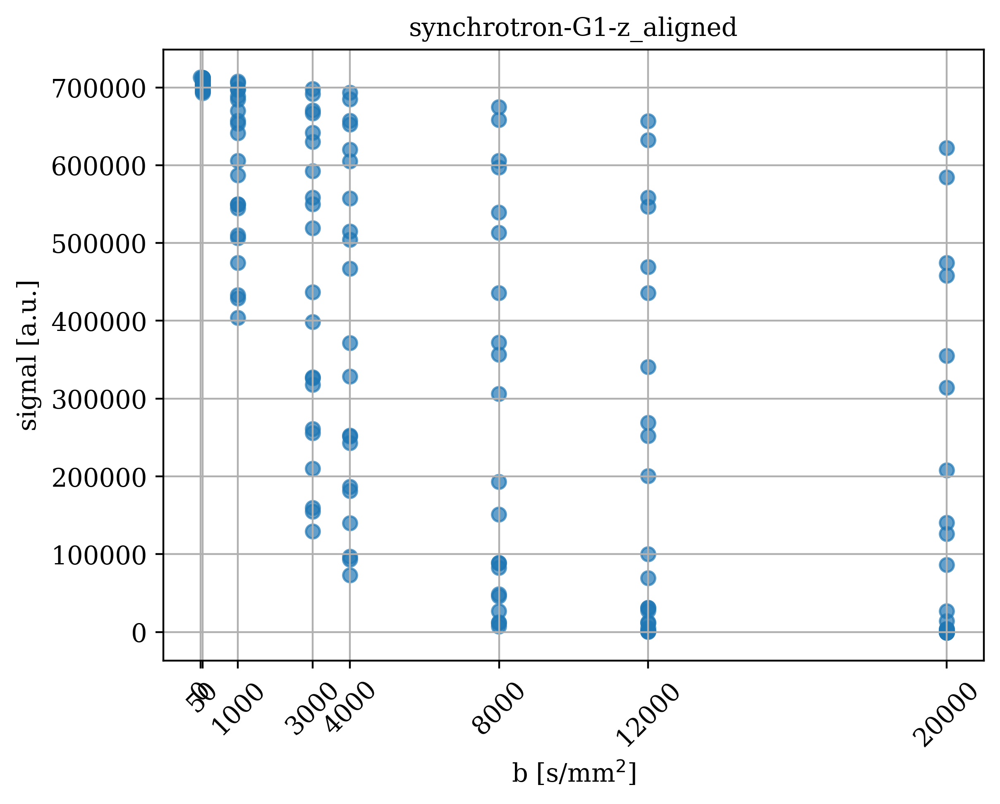

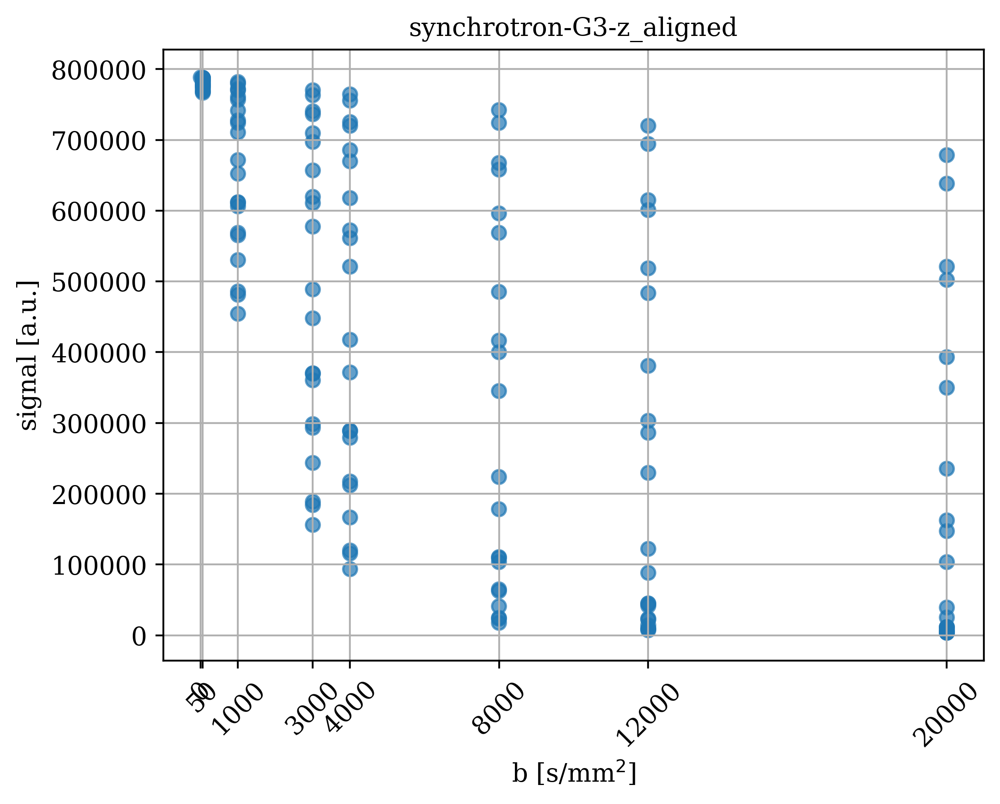

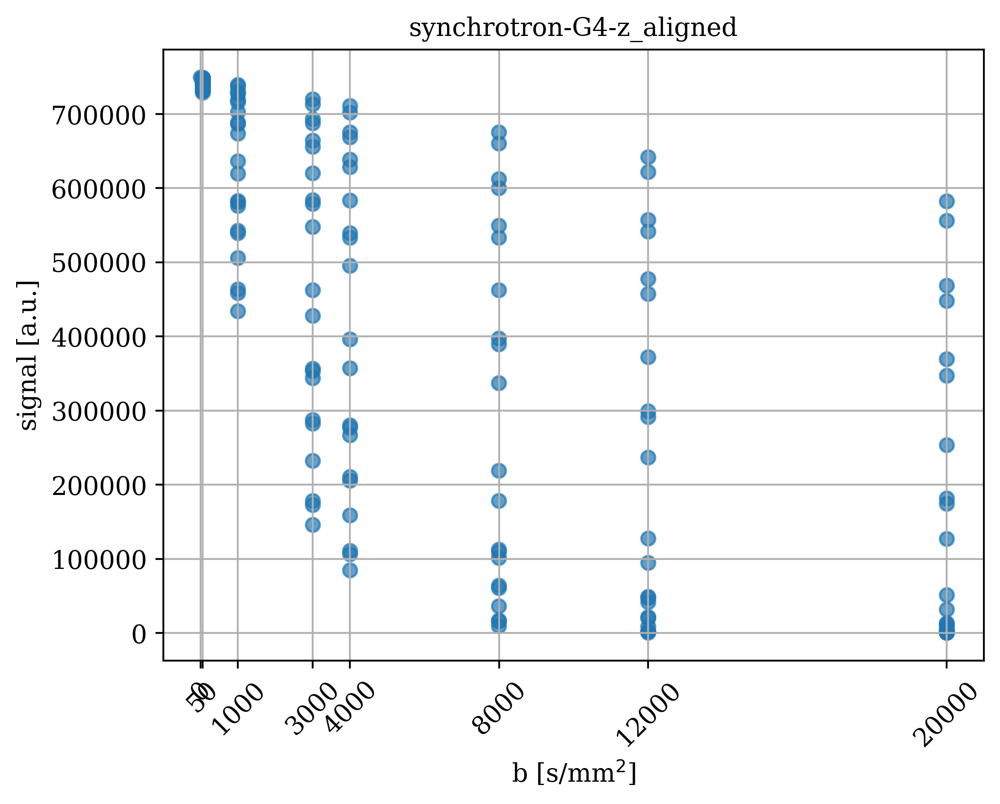

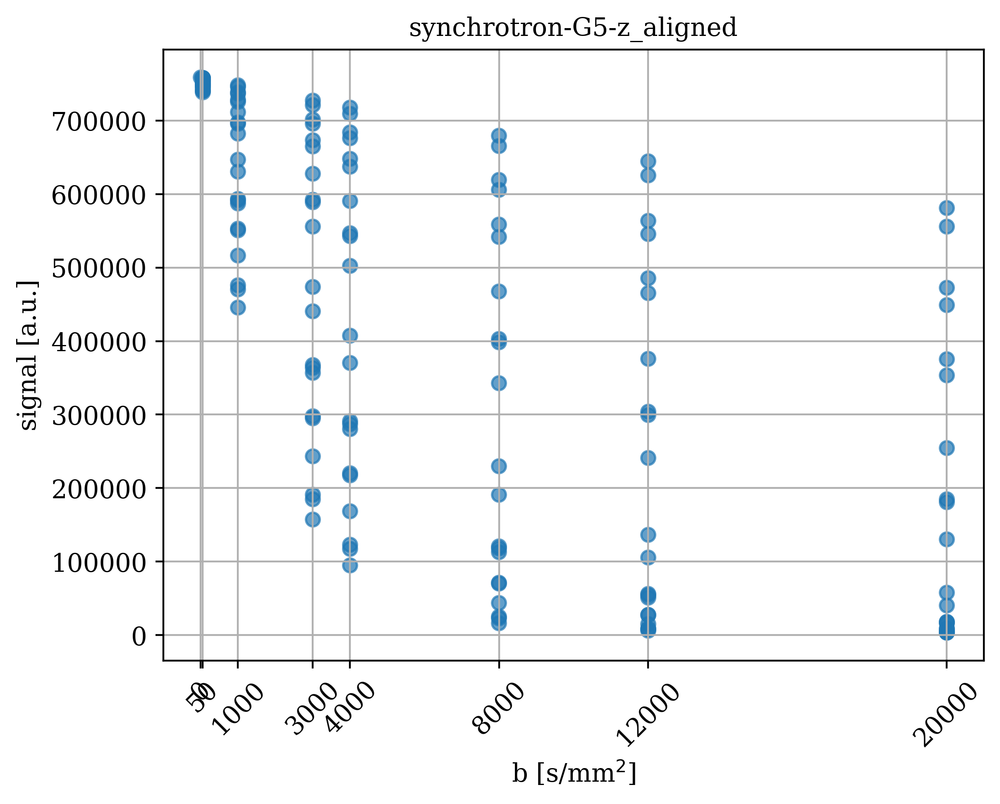

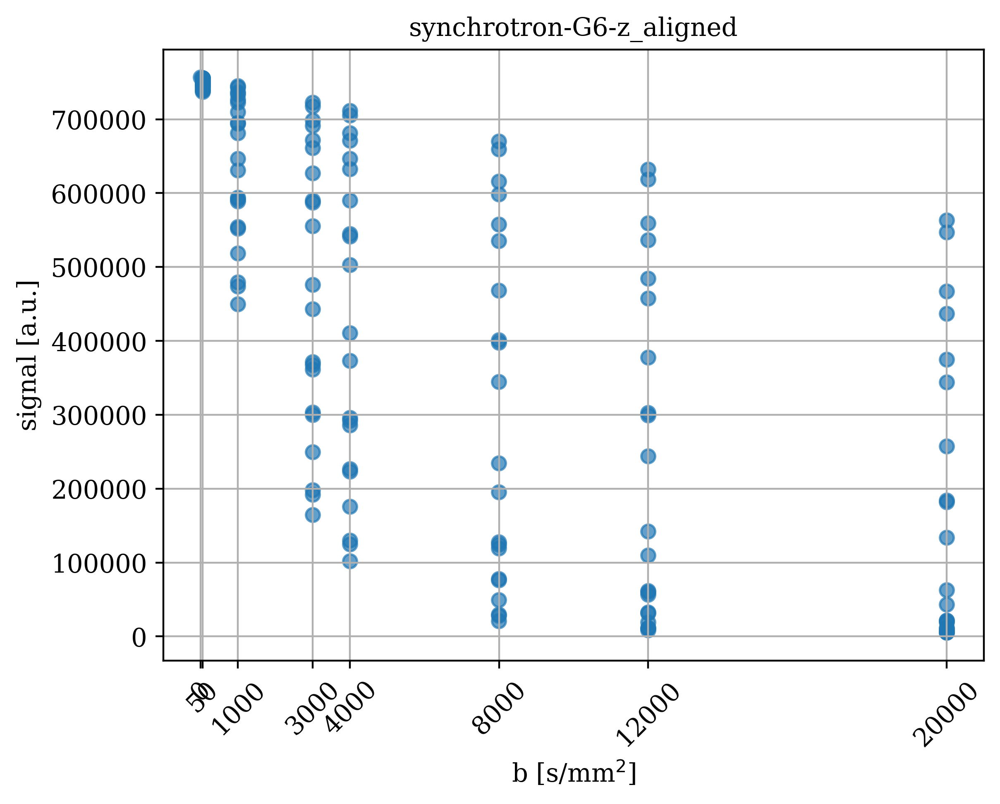

In [56]:
for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):
    
    plt.figure()
    
    for name_substrate, per_scheme in tqdm(per_name_substrate.items()):
        
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue

        if name_substrate != 'all':
            continue
        
        for _path_scheme_file, per_compartment in per_scheme.items():
            
            scheme = np.loadtxt(path_scheme_file, skiprows=1)
            
            small_delta = scheme[1, 5]
            big_delta = scheme[1, 4]
            b_vectors = scheme[:, :3]
            Gs = scheme[:, 3]
            gamma = 267.513 * 10**6 # [rad/(sT)] # gyromagnetic ratio for Hydrogen # 42.58 * 10**6 [Hz/T]
            b_values = (gamma * Gs * small_delta)**2 * (big_delta - small_delta/3) * 1e-6
            b_values_unique = np.unique(b_values)
            
            #signals = per_compartment['intra+extra']['only_diffusion_gradients'].cpu()
            signals = per_compartment['intra']['only_diffusion_gradients'].cpu()
            
            plt.scatter(b_values, signals, alpha=0.7)
            
    plt.xlabel('b [s/mm$^2$]')
    plt.ylabel('signal [a.u.]')
    plt.grid(True)
    xticks = np.round(b_values_unique, -1).astype(int)
    plt.xticks(xticks, rotation=45)
    plt.title(type_substrate)

### INSPECT SIGNALS: PA

In [57]:
# # tag_compartment = 'extra'
# tag_compartment = 'intra'

# for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):
    
#     plt.figure()
    
#     for idx_substrate, (name_substrate, per_scheme) in enumerate(tqdm(per_name_substrate.items())):
        
# #         print(name_substrate)
        
# #         if not any([t in name_substrate for t in tags_axons_oi]):
# #             continue

#         if name_substrate == 'all':
#             continue
        
#         for _path_scheme_file, per_compartment in per_scheme.items():
            
#             scheme = np.loadtxt(path_scheme_file, skiprows=1)
            
#             small_delta = scheme[1, 5]
#             big_delta = scheme[1, 4]
#             b_vectors = scheme[:, :3]
#             Gs = scheme[:, 3]
#             gamma = 267.513 * 10**6 # [rad/(sT)] # gyromagnetic ratio for Hydrogen # 42.58 * 10**6 [Hz/T]
#             b_values = (gamma * Gs * small_delta)**2 * (big_delta - small_delta/3) * 1e-6
#             b_values_unique = np.unique(b_values)
            
#             #signals = per_compartment['intra+extra']['only_diffusion_gradients'].cpu()
#             #signals = per_compartment['intra']['only_diffusion_gradients'].cpu()
#             #signals = per_compartment['extra']['only_diffusion_gradients'].cpu()
#             _key = list(per_compartment[tag_compartment]['all_gradients'].keys())[-1]
#             signals = per_compartment[tag_compartment]['all_gradients'][_key].cpu()
            
#             for b_value in b_values_unique:
                
#                 PA = torch.mean(signals[b_values == b_value])
                
#                 if PA > 10**6:
#                     print(name_substrate)
                    
#                 if 'helix' in name_substrate:
#                     if b_value == 0.0:
#                         label = name_substrate.split('-')[3]
#                     else:
#                         label = None
#                 else:
#                     label = None
            
#                 plt.scatter(b_value, PA, color=colors[idx_substrate], label=label)
            
#     plt.xlabel('b [s/mm$^2$]')
#     plt.ylabel('PA [a.u.]')
# #     plt.yscale('log')
#     plt.ylim(0, 18000)
#     plt.grid(True, 'both')
#     xticks = np.round(b_values_unique, -1).astype(int)
#     plt.xticks(xticks, rotation=45)
#     plt.title(tag_compartment + ': ' + type_substrate)
#     plt.legend(loc='upper right')
#     plt.show()

In [58]:
# plt.figure()

# #for compartment, m in zip(['intra', 'extra'], ['o', 'x']):
# for compartment, m in zip(['intra'], ['o']):
    
#     for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):

#         for idx_substrate, (name_substrate, per_scheme) in enumerate(tqdm(per_name_substrate.items())):

# #             print(name_substrate)

#     #         if not any([t in name_substrate for t in tags_axons_oi]):
#     #             continue

#             if name_substrate == 'all':
#                 continue

#             for _path_scheme_file, per_compartment in per_scheme.items():

#                 scheme = np.loadtxt(path_scheme_file, skiprows=1)

#                 small_delta = scheme[1, 5]
#                 big_delta = scheme[1, 4]
#                 b_vectors = scheme[:, :3]
#                 Gs = scheme[:, 3]
#                 gamma = 267.513 * 10**6 # [rad/(sT)] # gyromagnetic ratio for Hydrogen # 42.58 * 10**6 [Hz/T]
#                 b_values = (gamma * Gs * small_delta)**2 * (big_delta - small_delta/3) * 1e-6
#                 b_values_unique = np.unique(b_values)

#                 #signals = per_compartment['intra+extra']['only_diffusion_gradients'].cpu()
#                 #signals = per_compartment['intra']['only_diffusion_gradients'].cpu()
#                 #signals = per_compartment['extra']['only_diffusion_gradients'].cpu()
#                 _key = list(per_compartment[compartment]['all_gradients'].keys())[-1]
#                 signals = per_compartment[compartment]['all_gradients'][_key].cpu()

#                 for b_value in b_values_unique:

#                     PA = torch.mean(signals[b_values == b_value])

#                     if PA > 10**6:
#                         print(name_substrate)

#                     if 'helix' in name_substrate:
#                         if b_value == 0.0:
#                             label = name_substrate.split('-')[3]
#                         else:
#                             label = None

#                     plt.scatter(b_value, PA, color=colors[idx_substrate], label=label, marker=m)

# plt.xlabel('b [s/mm$^2$]')
# plt.ylabel('PA [a.u.]')
# #     plt.yscale('log')
# plt.ylim(0, 18000)
# plt.grid(True, 'both')
# xticks = np.round(b_values_unique, -1).astype(int)
# plt.xticks(xticks, rotation=45)
# plt.title(type_substrate)
# plt.legend(loc='upper right')
# plt.show()

# T2

In [59]:
L = np.sqrt(np.pi*np.sqrt(3) / (6 * 0.8))
a = np.sqrt(L**2 - (L/2)**2)

L, 2*a

(1.0647180859957184, 1.8441458206820733)

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

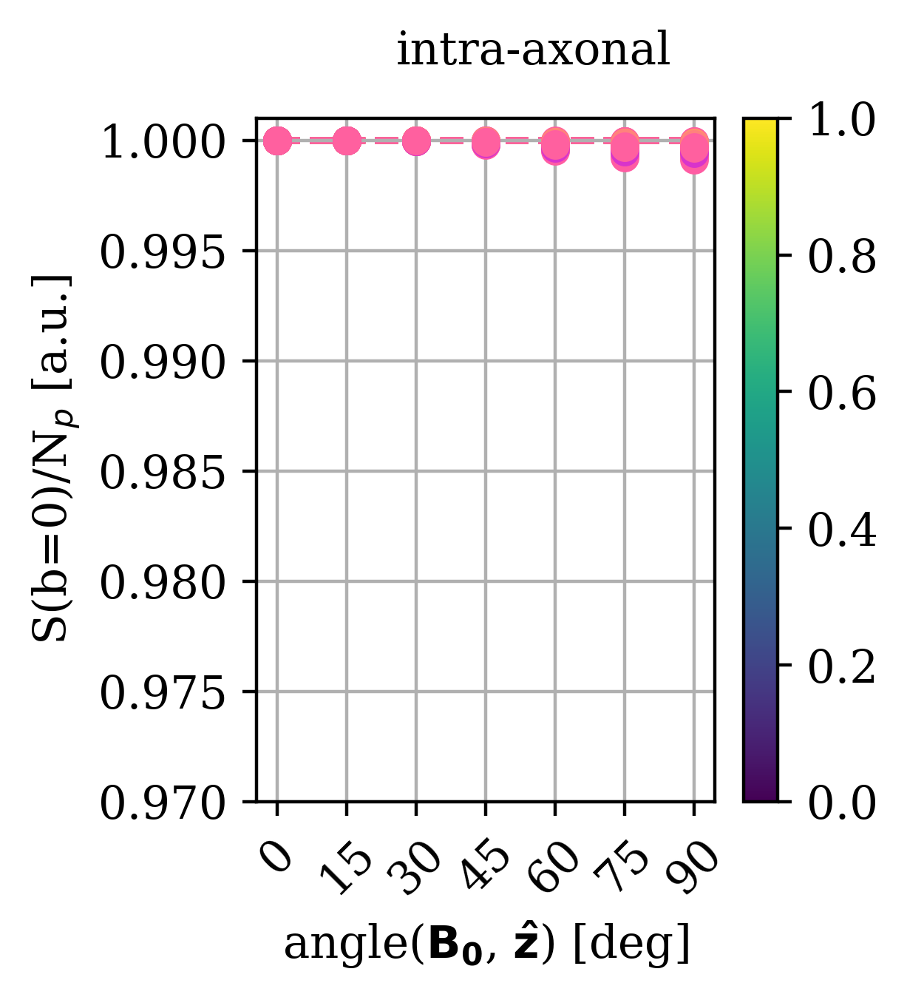

type_substrate:  synchrotron-G3-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

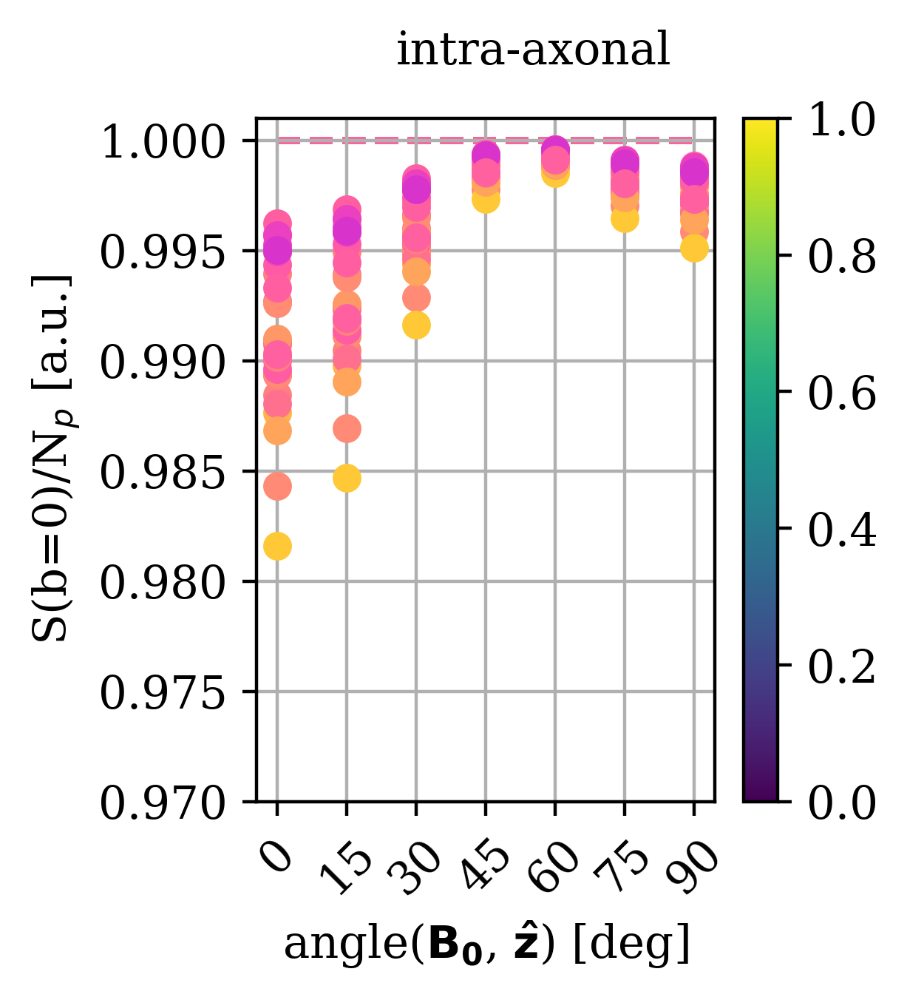

type_substrate:  synchrotron-G4-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

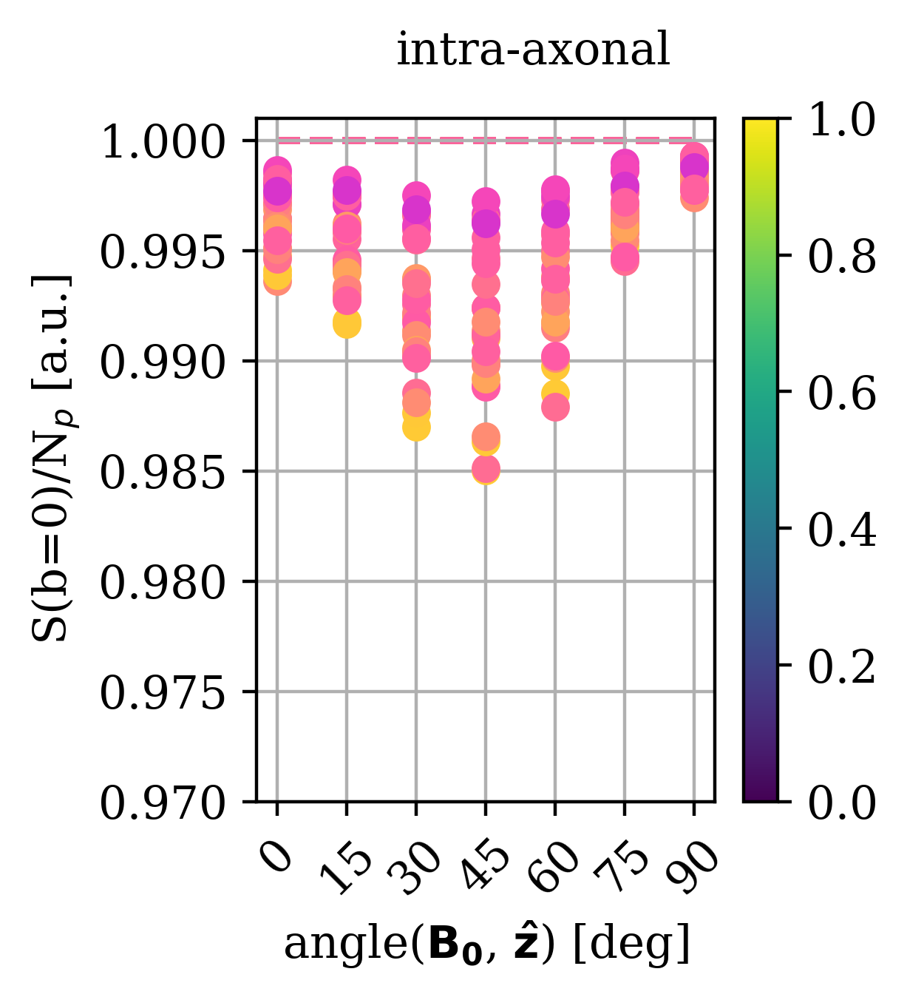

type_substrate:  synchrotron-G5-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

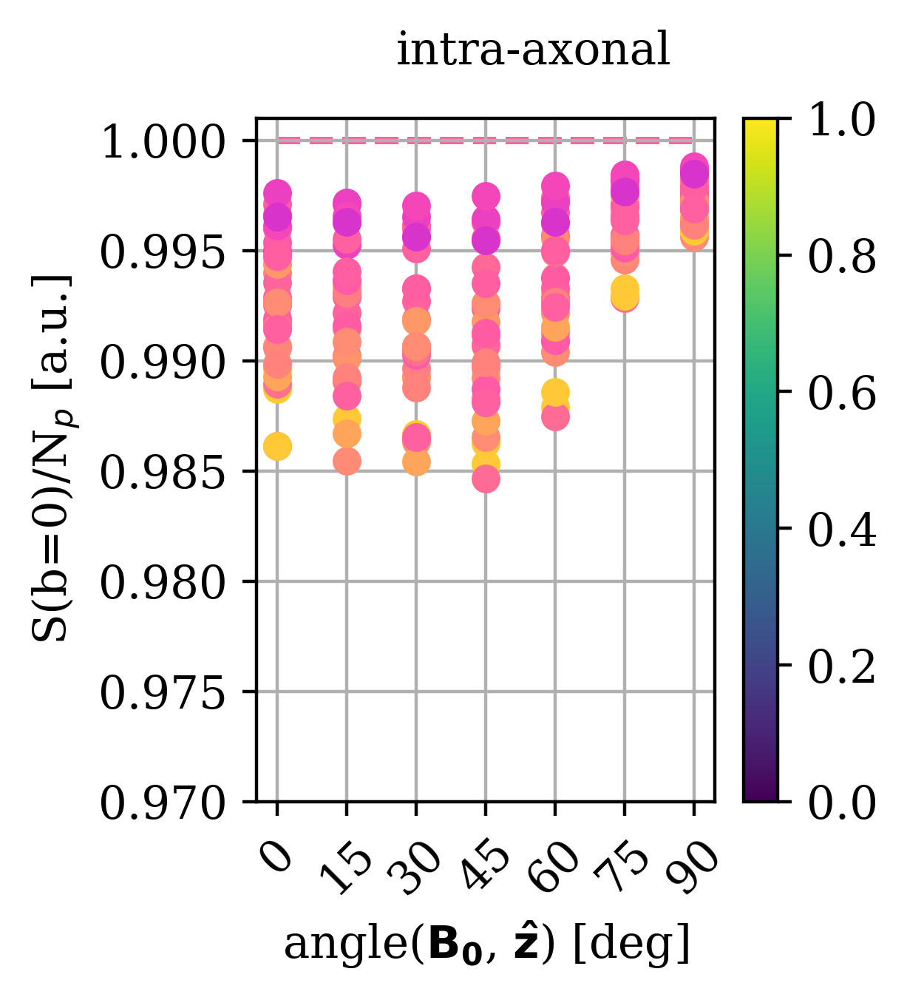

type_substrate:  synchrotron-G6-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

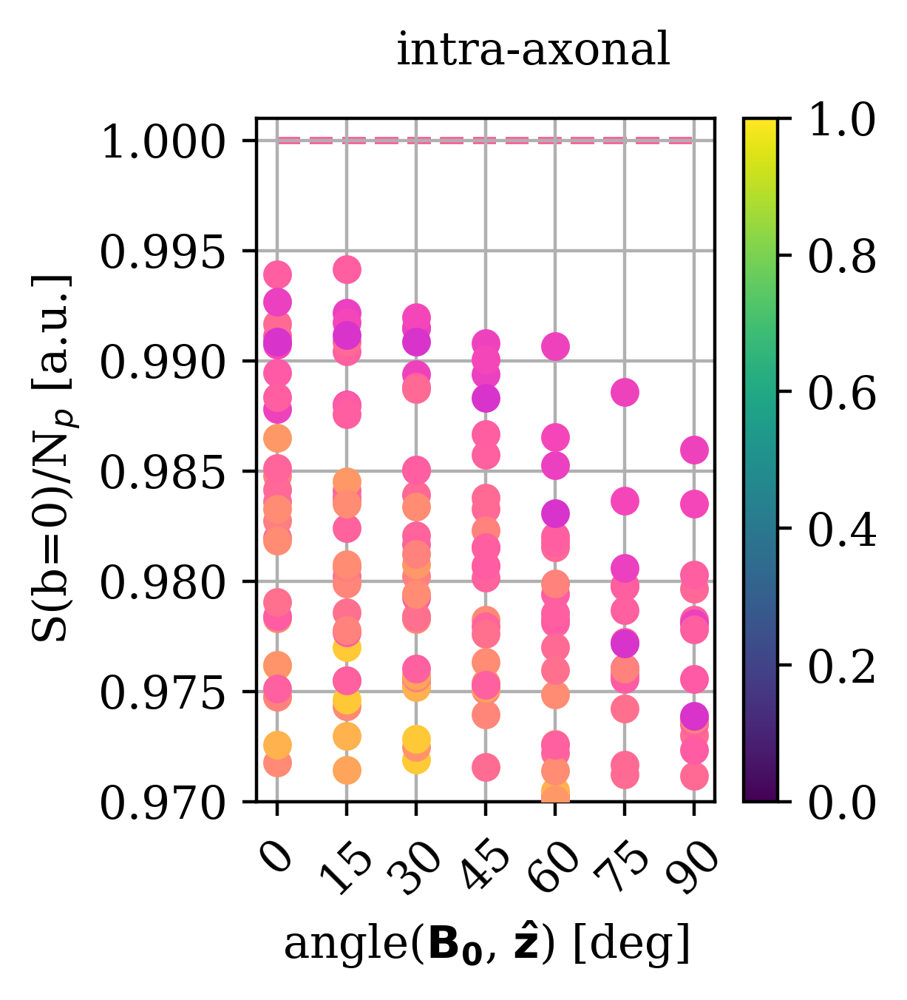

In [60]:
# normalizer = 8836 + 17319

cmap = plt.cm.get_cmap('gnuplot2')
alpha = 1.0

diameters = []

# for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):

for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if len(per_name_substrate.keys()) == 0:
        continue
    
    axs_all = []
    figs = []
    
    if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra, ax_intra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_intra)
        figs.append(fig_intra)
        fig_intra.suptitle('intra-axonal')

    if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_extra, ax_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_extra)
        figs.append(fig_extra)
        fig_extra.suptitle('extra-axonal')

    if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra_extra, ax_intra_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_intra_extra)
        figs.append(fig_intra_extra)
        fig_intra_extra.suptitle('intra- and extra-axonal')
    
    #for nam_substrate, per_scheme in tqdm(per_name_substrate.items()):
    for idx_substrate, (name_substrate, per_scheme) in enumerate(tqdm(per_name_substrate.items())):
        
        if name_substrate == 'all':
            continue
            
#         if ('axon17' not in name_substrate) and ('axon28' not in name_substrate) and ('axon33' not in name_substrate):
#             continue
            
        path_oi = os.path.join(path_substrates, 'synchrotron-G1-z_aligned', 'meshes', name_substrate+'-inner.ply')
        vertices, _ = pytorch3d.io.load_ply(path_oi)
        diameter = np.abs(vertices[:, 0].max()) + np.abs(vertices[:, 0].min())
        diameter = diameter.numpy()
        if '-G1-' in type_substrate:
            diameters.append(diameter)
#         print('diameter: ', diameter)
                
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            scheme = np.loadtxt(path_scheme_file, skiprows=1)

            small_delta = scheme[1, 5]
            big_delta = scheme[1, 4]
            b_vectors = scheme[:, :3]
            Gs = scheme[:, 3]
            gamma = 267.513 * 10**6 # [rad/(sT)] # gyromagnetic ratio for Hydrogen # 42.58 * 10**6 [Hz/T]
            b_values = (gamma * Gs * small_delta)**2 * (big_delta - small_delta/3) * 1e-6
            b_values_unique = np.unique(b_values)
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    marker = 'o'
                    ls = '--'
                    ax = ax_intra
                    fig = fig_intra
                elif compartment == 'extra':
                    marker = 'x'
                    ls = ':'
                    ax = ax_extra
                    fig = fig_extra
                if compartment == 'intra+extra':
                    marker = 's'
                    ls = '-'
                    ax = ax_intra_extra
                    fig = fig_intra_extra
                    
                #### coloring
                if 'helix' in type_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                    label = name_substrate.split('-')[3] 
                else:
                    label = None
                    if name_substrate == 'all':
                        color = 'black'
                    elif 'G' in type_substrate:
                        weight_color = diameter / 4.
                        color = cmap(weight_color)
                    else:
                        color = None
        
                #### plot including only_diffusion_gradients
                S0_nf = per_contribution['only_diffusion_gradients'][b_values == 0.0].cpu() * 0.5
                
                normalizer = S0_nf
                
                p = ax.plot([0, 90], 
                            [S0_nf/normalizer, S0_nf/normalizer],
#                             [S0_nf, S0_nf],
                            color=color, 
                            ls=ls,
                            zorder=1,
                            label=label)
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['all_gradients'].items():
                    
                    S0 = per_contribution['all_gradients'][name_Bfield][b_values == 0.0].cpu() * 0.5
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
            
                    cax = ax.scatter(B_z_angle, 
                               S0/normalizer, 
#                                S0,
#                                S0-S0_nf,
                               marker=marker, 
                               color=p[0].get_color(),
                               #color=color
                               alpha=alpha,
                               zorder=10,
                               cmap=cmap
                               )
                
#             if compartment == 'intra+extra':
#                 ax.legend()

    if 'helix' in name_substrate: ax.set_ylim(0.7, 1)
    if 'synchrotron' in name_substrate: ax.set_ylim(0.85, 1)
    ax.grid(True, zorder=0)
    ax.set_xticks(np.arange(0, 91, 15))
    ax.set_xticklabels(np.arange(0, 91, 15), rotation=45)
    # ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
    ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
    ax.set_ylabel('S(b=0)/N$_{p}$ [a.u.]')
    fig.colorbar(cax, ax=ax, cmap=cmap)
    ax.set_ylim(0.97, 1.001)
    #         ax.set_ylim(0.69, 1.01)

    #     for fig in figs:

    #         fig.tight_layout()

    plt.show()

In [61]:
np.array(diameters).mean() #mean of G1 diameters

2.5999875

In [62]:
np.round(0.0655/np.array(diameters).mean(), 4)

0.0252

In [63]:
1.9*0.7

1.3299999999999998

In [64]:
np.round(0.0655/1.33, 4)

0.0492

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned


0it [00:00, ?it/s]

type_substrate:  synchrotron-G3-z_aligned


0it [00:00, ?it/s]

type_substrate:  synchrotron-G4-z_aligned


0it [00:00, ?it/s]

type_substrate:  synchrotron-G5-z_aligned


0it [00:00, ?it/s]

type_substrate:  synchrotron-G6-z_aligned


0it [00:00, ?it/s]

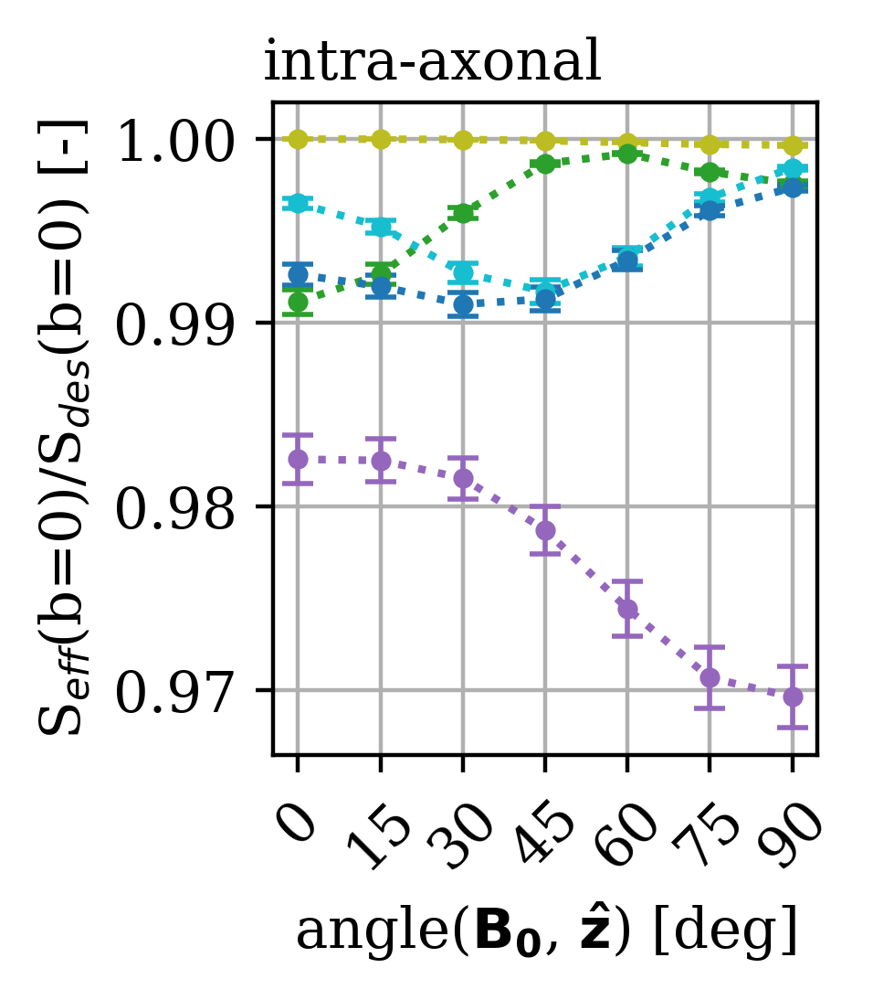

In [103]:
cmap = plt.cm.get_cmap('gnuplot2')

axs_all = []
figs = []

if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_intra, ax_intra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
    axs_all.append(ax_intra)
    figs.append(fig_intra)
    fig_intra.suptitle('intra-axonal', y=0.9)
    #fig_intra.suptitle('intra-axonal', y=1.0)

if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_extra, ax_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
    axs_all.append(ax_extra)
    figs.append(fig_extra)
    fig_extra.suptitle('extra-axonal', y=0.9)

if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_intra_extra, ax_intra_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
    axs_all.append(ax_intra_extra)
    figs.append(fig_intra_extra)
    fig_intra_extra.suptitle('intra- and extra-axonal', y=0.9)    

# for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
#     if 'G1' in type_substrate:
#         continue
    
    if len(per_name_substrate.keys()) == 0:
        continue
        
    S0s = []
    B_z_angles = []
    
    S0s_nf = []
    
    for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
        if name_substrate == 'all':
            continue
        
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    axs = ax_intra
                    marker = marker_intra
                elif compartment == 'extra':
                    fig = fig_extra
                    axs = ax_extra
                    marker = marker_extra
                if compartment == 'intra+extra':
                    fig = fig_intra_extra
                    axs = ax_intra_extra
                    marker = marker_intra_extra
                    
                #### coloring
                if 'helix' in name_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    color = plotting_specs[type_substrate]['color']
        
                S0_nf = per_contribution['only_diffusion_gradients'][b_values == 0.0].cpu().item()
                
                normalizer = S0_nf
                
                S0s_nf.append(S0_nf/normalizer)
                #S0s_nf.append(S0_nf)
                
#                 ADC = np.mean(fit_dt.evals)
#                 ADCs_nf.append(ADC)
#                 #axs[0].plot([0, 90], [ADC, ADC], color=color, 
#                 #            lw=lw, alpha=0.7, zorder=zorder)

#                 ADC_para = fit_dt.evals[0][0][0][0]
#                 ADCs_para_nf.append(ADC_para)
#                 #axs[1].plot([0, 90], [ADC_para, ADC_para], color=color,
#                 #                               lw=lw, alpha=alpha, zorder=zorder)

#                 ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])
#                 ADCs_perp_nf.append(ADC_perp)
#                 #axs[2].plot([0, 90], [ADC_perp, ADC_perp], color=color,
#                 #                               lw=lw, alpha=alpha, zorder=zorder, 
#                 #            #label=type_substrate.split('-')[1],
#                 #           )
            
                label_switch = True
            
                #### plot including susceptibility contributions
                #for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                for name_Bfield, fit_dt in per_contribution['all_gradients'].items():
                    
                    if label_switch:
                        if 'helix' in name_substrate:
                            r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
                            label = 'r$_{helix}$' + f' = {r_helix}'
                        elif 'axon' in name_substrate:
                            label = name_substrate.split('-')[0]
                        label_switch = False
                    else:
                        label = None
                    
                    S0 = per_contribution['all_gradients'][name_Bfield][b_values == 0.0].cpu().item()
                    S0s.append(S0/normalizer)
                    #S0s.append(S0)
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
                    B_z_angles.append(B_z_angle)
            
    capsize = 3
    elinewidth = 1
    markeredgewidth = 1
    ls_err = ':'
    marker_err = '.'
    
    n_Bfields = 7
    n_axons = len(S0s)//7
    
    #### S0s
    S0s = np.reshape(S0s, (n_axons, 7))
    S0s_mean = np.mean(S0s, axis=0)
    S0s_err = np.std(S0s, axis=0) / np.sqrt(n_axons)

    axs.errorbar(B_z_angles[:n_Bfields], S0s_mean, yerr=S0s_err, color=color, capsize=capsize, elinewidth=elinewidth, markeredgewidth=markeredgewidth, ls=ls_err, marker=marker_err)
    
    S0s_mean_nf = np.mean(S0s_nf, axis=0)
    S0s_err_nf = np.std(S0s_nf, axis=0) / np.sqrt(n_axons)
    axs.fill_between([0, 90], S0s_mean_nf-S0s_err_nf, S0s_mean_nf+S0s_err_nf, color=color, 
                        alpha=0.5, ec=None, label=type_substrate.split('-')[1]+f', n={n_axons}')

    #### fix legend
#     _handles, _labels = ax_intra.get_legend_handles_labels()
#     mask_legend = np.argsort(_labels)
#     ax_intra.legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], 
#                        loc='lower left', ncol=1, fontsize=8) # fontsize=10

for axs in axs_all:
    
    #axs.set_ylim(0.9655, 1.001)
    axs.set_ylim(0.9665, 1.002)

    #axs.set_ylabel('S(b=0 | B$_{bg}$) / S(b=0) [-]')
    #axs.set_ylabel('S(b=0)/N$_p$ [-]')
    #axs.set_ylabel('S$_{eff}$(b=50)/S$_{d}$(b=50) [-]')
    axs.set_ylabel('S$_{eff}$(b=0)/S$_{des}$(b=0) [-]')

    axs.grid(True)
    axs.set_xticks(np.arange(0, 91, 15))
    axs.set_xticklabels(np.arange(0, 91, 15), rotation=45)
    #axs.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
    axs.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
    #axs.ticklabel_format(axis='y', style='sci', scilimits=(-1,-1))
    
    
# #### check cos^2 vs cos^4
# xs = np.linspace(0, np.pi/2)

# _a = 0.013
# _b = 0.97

# plt.plot(np.rad2deg(xs), _a*np.cos(xs)**2 + _b, color='tab:blue')
# plt.plot(np.rad2deg(xs), _a*np.cos(xs)**4 + _b, color='tab:orange')

for fig in figs:

    fig.tight_layout()


path_figure = path_figures + f'/orientation_dependencies/XNH-T2'
plt.savefig(path_figure, dpi=400)

#### TEST COS^2 VS. COS^4 FOR C5 TREND

In [76]:
#### MODELS

def model_b(x, a, b):
    x = np.deg2rad(x)
    return a + b*np.cos(x)**2

def model_e(x, a, b):
    x = np.deg2rad(x)
    return a + b*np.cos(x)**4


models = [model_b, model_e]

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned
type_substrate:  synchrotron-G3-z_aligned
type_substrate:  synchrotron-G4-z_aligned
type_substrate:  synchrotron-G5-z_aligned
type_substrate:  synchrotron-G6-z_aligned


0it [00:00, ?it/s]

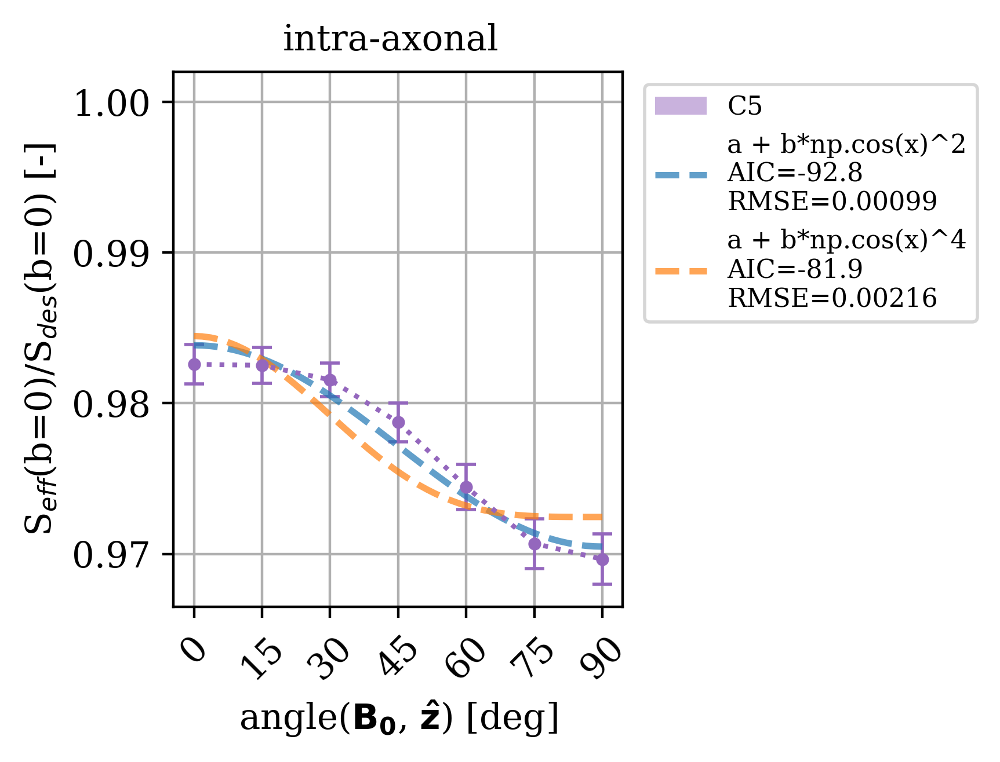

In [105]:
cmap = plt.cm.get_cmap('gnuplot2')

axs_all = []
figs = []

if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_intra, ax_intra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
    axs_all.append(ax_intra)
    figs.append(fig_intra)
#     fig_intra.suptitle('intra-axonal', y=0.9)
#     fig_intra.suptitle('intra-axonal', y=1.0)
    fig_intra.suptitle('intra-axonal', y=0.95)

# for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if 'G6' not in type_substrate:
        continue
    
    if len(per_name_substrate.keys()) == 0:
        continue
        
    S0s = []
    B_z_angles = []
    
    S0s_nf = []
    
    for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
        if name_substrate == 'all':
            continue
        
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    axs = ax_intra
                    marker = marker_intra
                    
                #### coloring
                if 'helix' in name_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    color = plotting_specs[type_substrate]['color']
        
                S0_nf = per_contribution['only_diffusion_gradients'][b_values == 0.0].cpu().item()
                
                normalizer = S0_nf
                
                S0s_nf.append(S0_nf/normalizer)
                #S0s_nf.append(S0_nf)
            
                label_switch = True
            
                #### plot including susceptibility contributions
                #for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                for name_Bfield, fit_dt in per_contribution['all_gradients'].items():
                    
                    if label_switch:
                        if 'helix' in name_substrate:
                            r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
                            label = 'r$_{helix}$' + f' = {r_helix}'
                        elif 'axon' in name_substrate:
                            label = name_substrate.split('-')[0]
                        label_switch = False
                    else:
                        label = None
                    
                    S0 = per_contribution['all_gradients'][name_Bfield][b_values == 0.0].cpu().item()
                    S0s.append(S0/normalizer)
                    #S0s.append(S0)
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
                    B_z_angles.append(B_z_angle)
            
    capsize = 3
    elinewidth = 1
    markeredgewidth = 1
    ls_err = ':'
    marker_err = '.'
    
    n_Bfields = 7
    n_axons = len(S0s)//7
    
    #### S0s
    S0s = np.reshape(S0s, (n_axons, 7))
    S0s_mean = np.mean(S0s, axis=0)
    S0s_err = np.std(S0s, axis=0) / np.sqrt(n_axons)

    axs.errorbar(B_z_angles[:n_Bfields], S0s_mean, yerr=S0s_err, color=color, capsize=capsize, elinewidth=elinewidth, markeredgewidth=markeredgewidth, ls=ls_err, marker=marker_err)
    
    S0s_mean_nf = np.mean(S0s_nf, axis=0)
    S0s_err_nf = np.std(S0s_nf, axis=0) / np.sqrt(n_axons)
    axs.fill_between([0, 90], S0s_mean_nf-S0s_err_nf, S0s_mean_nf+S0s_err_nf, color=color, 
#                         alpha=0.5, ec=None, label=type_substrate.split('-')[1]+f', n={n_axons}')
                     alpha=0.5, ec=None, label='C5')
    
    for model in models:
        x_fit = np.linspace(0, 90)
        
        #### FIT
        maxfev = 5000
        p0 = None
        bounds = None
        #p0 = (2e-5, 3e-4)
        bounds = ([-np.inf, 0], [np.inf, np.inf])
        
        K = 2

        #### ADC
        popt, pcov = curve_fit(model, B_z_angles[:n_Bfields], S0s_mean, maxfev=maxfev, bounds=bounds)#, p0=p0, bounds=bounds)
        a, b = popt
        a_std, b_std = np.sqrt(np.diag(pcov))
        
        rmse = sklearn.metrics.mean_squared_error(S0s_mean, model(B_z_angles[:n_Bfields], a, b), squared=False)
#         RMSEs['MD'][marker][model.__name__] = rmse
        RSS = np.sum((S0s_mean - model(B_z_angles[:n_Bfields], a, b))**2)
        AIC = 2 * K + len(S0s_mean) * np.log(RSS / len(S0s_mean))
#         AICs['MD'][marker][model.__name__] = AIC

#         plt.plot(np.rad2deg(xs), _a*np.cos(xs)**2 + _b, color='tab:blue')
    
        tag_model = model.__name__.split('_')[-1].upper()
        
        if 'B' in tag_model:
            _label = 'a + b*np.cos(x)^2'
        elif 'E' in tag_model:
            _label = 'a + b*np.cos(x)^4'
        
        plt.plot(x_fit, model(x_fit, a, b), alpha=0.7, lw=lw, ls=ls, label=_label+f'\nAIC={np.round(AIC, 1)}'+f'\nRMSE={np.round(rmse, 5)}')

    #### fix legend
#     _handles, _labels = ax_intra.get_legend_handles_labels()
#     mask_legend = np.argsort(_labels)
#     ax_intra.legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], 
#                        loc='lower left', ncol=1, fontsize=8) # fontsize=10

plt.legend(fontsize=8, bbox_to_anchor=(1.02, 1), loc="upper left")

for axs in axs_all:
    
    #axs.set_ylim(0.9655, 1.001)
    axs.set_ylim(0.9665, 1.002)

    #axs.set_ylabel('S(b=0 | B$_{bg}$) / S(b=0) [-]')
    #axs.set_ylabel('S(b=0)/N$_p$ [-]')
    #axs.set_ylabel('S$_{eff}$(b=50)/S$_{d}$(b=50) [-]')
    axs.set_ylabel('S$_{eff}$(b=0)/S$_{des}$(b=0) [-]')

    axs.grid(True)
    axs.set_xticks(np.arange(0, 91, 15))
    axs.set_xticklabels(np.arange(0, 91, 15), rotation=45)
    #axs.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
    axs.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
    #axs.ticklabel_format(axis='y', style='sci', scilimits=(-1,-1))
    
    
# #### check cos^2 vs cos^4
# xs = np.linspace(0, np.pi/2)

# _a = 0.013
# _b = 0.97

# plt.plot(np.rad2deg(xs), _a*np.cos(xs)**2 + _b, color='tab:blue')
# plt.plot(np.rad2deg(xs), _a*np.cos(xs)**4 + _b, color='tab:orange')

for fig in figs:

    fig.tight_layout()


# path_figure = path_figures + f'/orientation_dependencies/XNH-T2'
# plt.savefig(path_figure, dpi=400)

#### CREATE TABLE

In [106]:
for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if len(per_name_substrate.keys()) == 0:
        continue
        
    S0s = []
    B_z_angles = []
    
    S0s_nf = []
    
    for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
        if name_substrate == 'all':
            continue
            
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                #### coloring
                if 'helix' in name_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    color = plotting_specs[type_substrate]['color']
        
                S0_nf = per_contribution['only_diffusion_gradients'][b_values == 0.0].cpu().item()
                
                normalizer = S0_nf
                
                S0s_nf.append(S0_nf/normalizer)
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['all_gradients'].items():
                    
                    S0 = per_contribution['all_gradients'][name_Bfield][b_values == 0.0].cpu().item()
                    S0s.append(S0/normalizer)
                    #S0s.append(S0)
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
                    B_z_angles.append(B_z_angle)
            
    capsize = 3
    elinewidth = 1
    markeredgewidth = 1
    ls_err = ':'
    marker_err = '.'
    
    n_Bfields = 7
    n_axons = len(S0s)//7
    
    #### S0s
    S0s = np.reshape(S0s, (n_axons, 7))
    S0s_mean = np.mean(S0s, axis=0)
    S0s_err = np.std(S0s, axis=0) / np.sqrt(n_axons)
    
    idx_max = np.argmax(S0s_mean)
    idx_min = np.argmin(S0s_mean)
    print('min', B_z_angles[idx_min])
    print('%.3f \pm %.3f' %(S0s_mean[idx_min], S0s_err[idx_min]))
    print('max', B_z_angles[idx_max])
    print('%.3f \pm %.3f' %(S0s_mean[idx_max], S0s_err[idx_max]))
#     print(S0s_mean[idx_max], S0s_mean[idx_min])
#     print('err')
#     print(S0s_err[idx_max], S0s_err[idx_min])

    S0s_mean_nf = np.mean(S0s_nf, axis=0)
    S0s_err_nf = np.std(S0s_nf, axis=0) / np.sqrt(n_axons)
    


  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned


0it [00:00, ?it/s]

min 90
1.000 \pm 0.000
max 0
1.000 \pm 0.000
type_substrate:  synchrotron-G3-z_aligned


0it [00:00, ?it/s]

min 0
0.991 \pm 0.001
max 60
0.999 \pm 0.000
type_substrate:  synchrotron-G4-z_aligned


0it [00:00, ?it/s]

min 45
0.992 \pm 0.001
max 90
0.998 \pm 0.000
type_substrate:  synchrotron-G5-z_aligned


0it [00:00, ?it/s]

min 30
0.991 \pm 0.001
max 90
0.997 \pm 0.000
type_substrate:  synchrotron-G6-z_aligned


0it [00:00, ?it/s]

min 90
0.970 \pm 0.002
max 0
0.983 \pm 0.001


  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

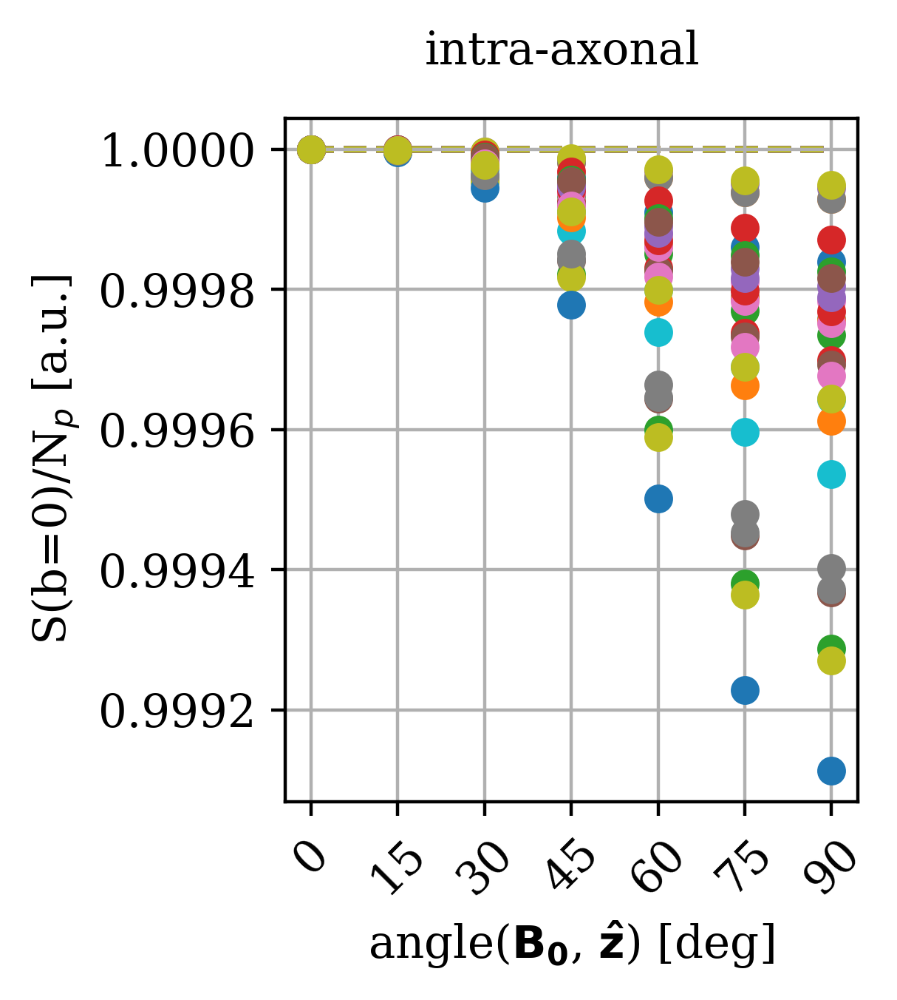

type_substrate:  synchrotron-G3-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

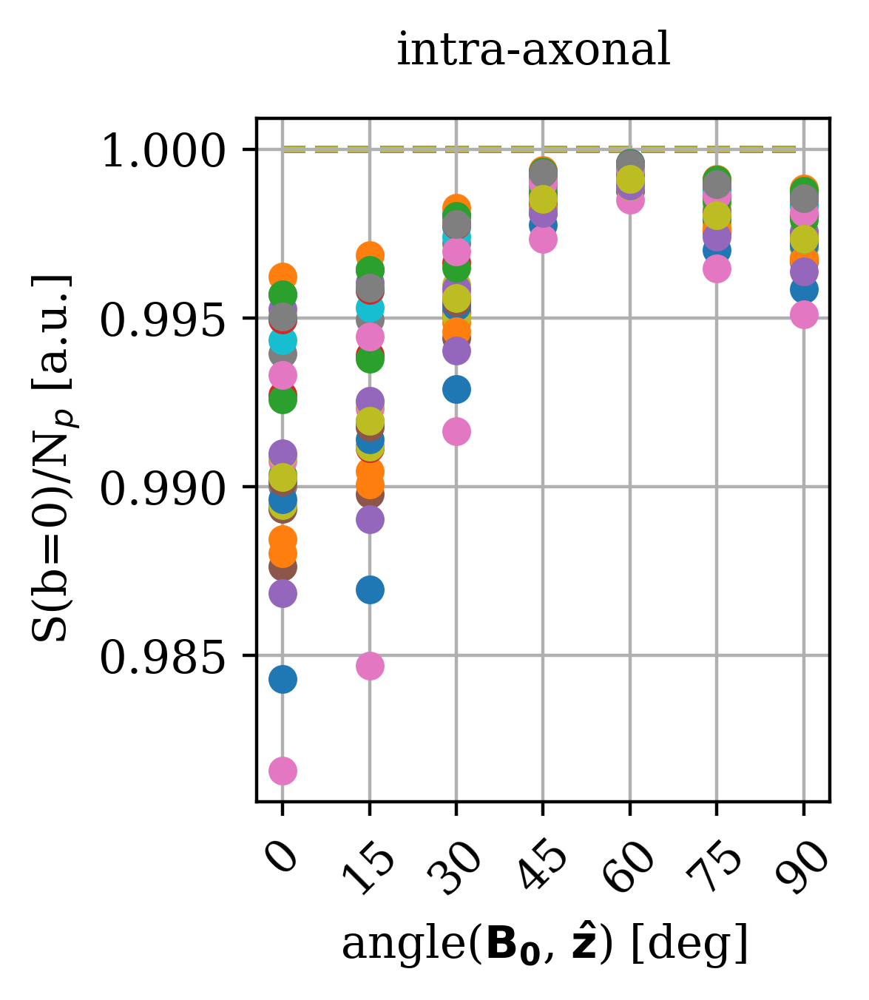

type_substrate:  synchrotron-G4-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

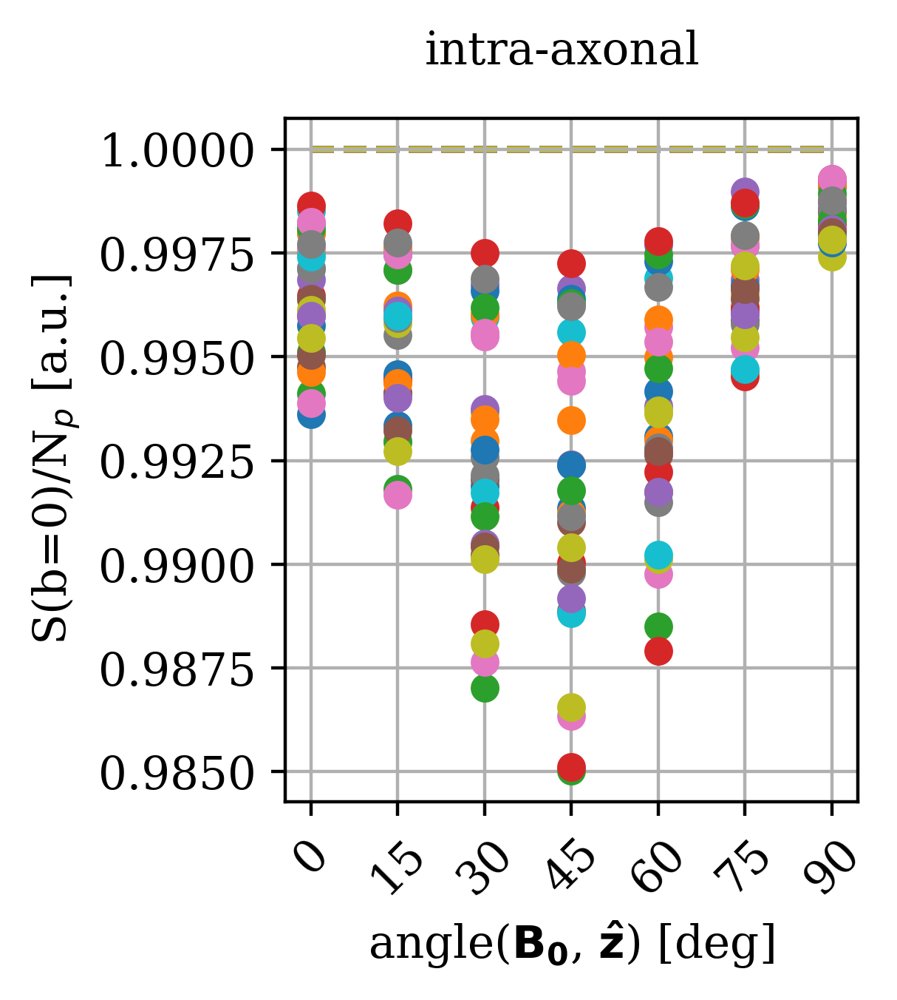

type_substrate:  synchrotron-G5-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

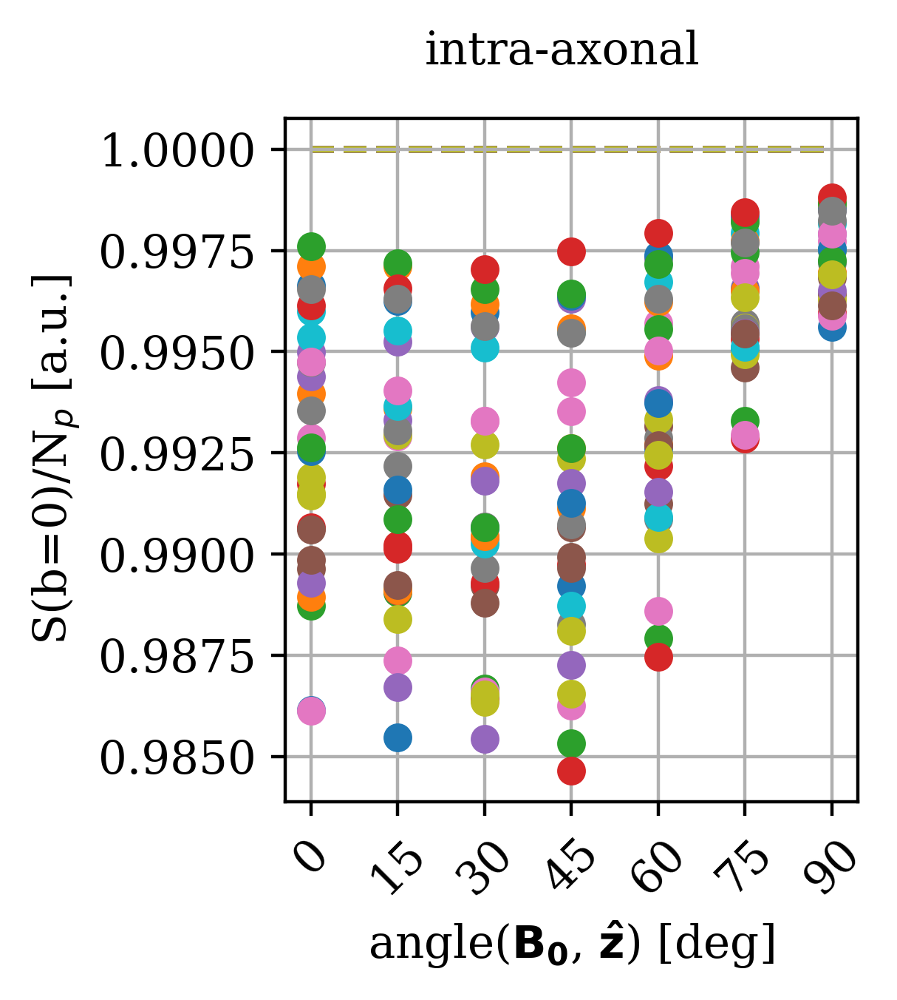

type_substrate:  synchrotron-G6-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

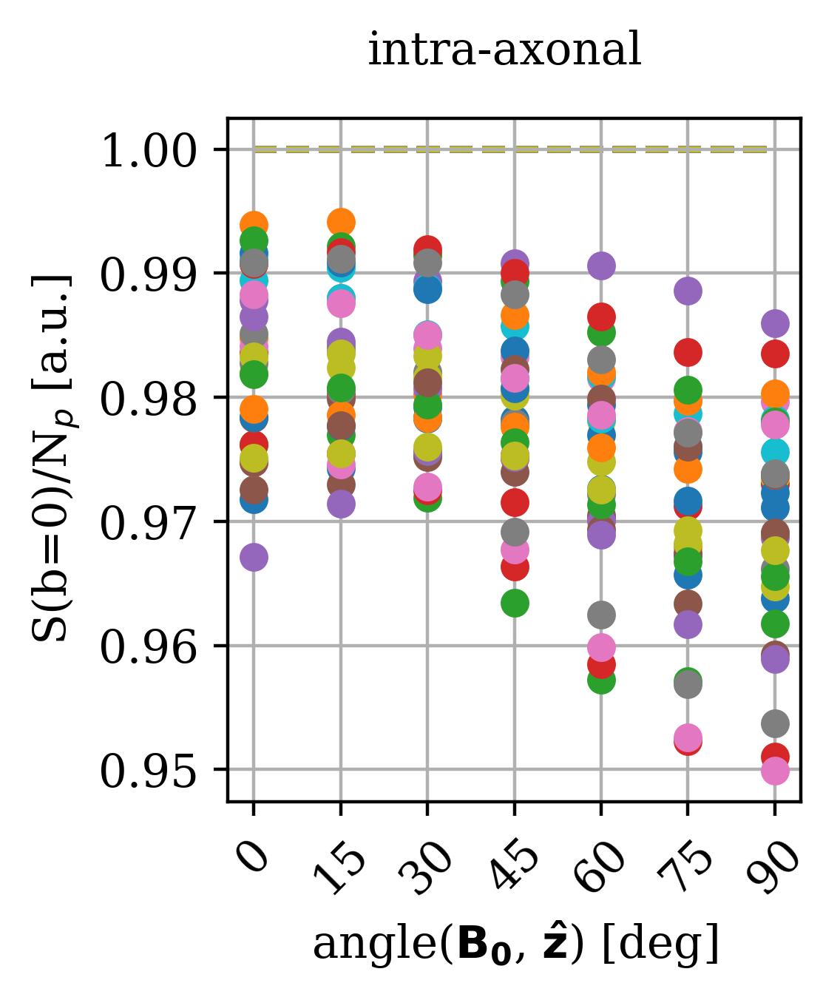

In [107]:
# normalizer = 8836 + 17319

cmap = plt.cm.get_cmap('gnuplot2')
alpha = 1.0

# for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):

for type_substrate, per_name_substrate in tqdm(signals_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if len(per_name_substrate.keys()) == 0:
        continue
    
    axs_all = []
    figs = []
    
    if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra, ax_intra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_intra)
        figs.append(fig_intra)
        fig_intra.suptitle('intra-axonal')

    if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_extra, ax_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_extra)
        figs.append(fig_extra)
        fig_extra.suptitle('extra-axonal')

    if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra_extra, ax_intra_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_intra_extra)
        figs.append(fig_intra_extra)
        fig_intra_extra.suptitle('intra- and extra-axonal')
    
    #for nam_substrate, per_scheme in tqdm(per_name_substrate.items()):
    for idx_substrate, (name_substrate, per_scheme) in enumerate(tqdm(per_name_substrate.items())):
        
        if name_substrate == 'all':
            continue
                
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            scheme = np.loadtxt(path_scheme_file, skiprows=1)

            small_delta = scheme[1, 5]
            big_delta = scheme[1, 4]
            b_vectors = scheme[:, :3]
            Gs = scheme[:, 3]
            gamma = 267.513 * 10**6 # [rad/(sT)] # gyromagnetic ratio for Hydrogen # 42.58 * 10**6 [Hz/T]
            b_values = (gamma * Gs * small_delta)**2 * (big_delta - small_delta/3) * 1e-6
            b_values_unique = np.unique(b_values)
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    marker = 'o'
                    ls = '--'
                    ax = ax_intra
                elif compartment == 'extra':
                    marker = 'x'
                    ls = ':'
                    ax = ax_extra
                if compartment == 'intra+extra':
                    marker = 's'
                    ls = '-'
                    ax = ax_intra_extra
                    
                #### coloring
                if 'helix' in type_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                    label = name_substrate.split('-')[3] 
                else:
                    label = None
                    if name_substrate == 'all':
                        color = 'black'
                    else:
                        color = None
        
                #### plot including only_diffusion_gradients
                S0_nf = per_contribution['only_diffusion_gradients'][b_values == 0.0].cpu()
                
                normalizer = S0_nf
                
                p = ax.plot([0, 90], 
                            [S0_nf/normalizer, S0_nf/normalizer],
#                             [S0_nf, S0_nf],
                            color=color, 
                            ls=ls,
                            zorder=1,
                            label=label)
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['all_gradients'].items():
                    
                    S0 = per_contribution['all_gradients'][name_Bfield][b_values == 0.0].cpu()
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
            
                    ax.scatter(B_z_angle, 
                               S0/normalizer, 
#                                S0,
#                                S0-S0_nf,
                               marker=marker, 
                               color=p[0].get_color(),
                               #color=color
                               alpha=alpha,
                               zorder=10
                               )
                
#             if compartment == 'intra+extra':
#                 ax.legend()

    if 'helix' in name_substrate: ax.set_ylim(0.7, 1)
    if 'synchrotron' in name_substrate: ax.set_ylim(0.85, 1)
    ax.grid(True, zorder=0)
    ax.set_xticks(np.arange(0, 91, 15))
    ax.set_xticklabels(np.arange(0, 91, 15), rotation=45)
    # ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
    ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
    ax.set_ylabel('S(b=0)/N$_{p}$ [a.u.]')
    #         ax.set_ylim(0.69, 1.01)

    #     for fig in figs:

    #         fig.tight_layout()

    plt.show()

# TENSOR MODELING

### FITTING

In [108]:
# ! rm /dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/synchrotron-G6-z_aligned/axon10*

In [109]:
import dipy.reconst.dti as dti
import dipy.data
from dipy.reconst.dti import fractional_anisotropy, color_fa

def fit_DTI(volume, bvals, bvecs, big_delta, small_delta, bs_oi, min_signal=None):

    b0_threshold = np.min(bs_oi) + 500

    mask_b = np.zeros(bvals.shape).astype(bool)

    for b_oi in bs_oi:
        mask_b = mask_b + (bvals > b_oi-500) * (bvals < b_oi+500)

    gtab = dipy.data.gradient_table(bvals[mask_b], bvecs=bvecs[mask_b, :],
                                    big_delta=big_delta, small_delta=small_delta,
                                    b0_threshold=b0_threshold)


    #### Instantiate the Tensor model
    tenmodel = dti.TensorModel(gtab, return_S0_hat=True, min_signal=min_signal)

    #### Fit the data
    tenfit = tenmodel.fit(volume[:, :, :, mask_b])
    
    return tenfit

In [110]:
bs_oi = [50, 1000, 3000, 4000]
# bs_oi = [4000, 8000, 12000]
# bs_oi = [8000, 12000, 20000]

In [111]:
tensorfits_per_substrate_type = {}

for type_substrate in signals_per_substrate_type.keys():
    
    tensorfits_per_substrate_type[type_substrate] = {}
    
    for name_substrate in signals_per_substrate_type[type_substrate].keys():
        
        tensorfits_per_substrate_type[type_substrate][name_substrate] = {}
        
        for path_scheme_file in signals_per_substrate_type[type_substrate][name_substrate].keys():
            
            tensorfits_per_substrate_type[type_substrate][name_substrate][path_scheme_file] = {}
            
            scheme = np.loadtxt(path_scheme_file, skiprows=1)
            
            small_delta = scheme[1, 5]
            big_delta = scheme[1, 4]
            b_vectors = scheme[:, :3]
            Gs = scheme[:, 3]
            gamma = 267.513 * 10**6 # [rad/(sT)] # gyromagnetic ratio for Hydrogen # 42.58 * 10**6 [Hz/T]
            b_values = (gamma * Gs * small_delta)**2 * (big_delta - small_delta/3)
            b_values = b_values * 1e-6
        
            for compartment in signals_per_substrate_type[type_substrate][name_substrate][path_scheme_file].keys():
                
                tensorfits_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment] = {}
                
                tensorfits_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['signals_only_diffusion_gradients'] = {}
                tensorfits_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['signals_only_susceptibility_gradients'] = {}
                tensorfits_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['signals_all_gradients'] = {}
                
                # no background field
                signals_only_diffusion_gradients = signals_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['only_diffusion_gradients'].cpu().numpy()
                signals_only_diffusion_gradients /= signals_only_diffusion_gradients[b_values == 0]
                
                fit = fit_DTI(signals_only_diffusion_gradients.reshape((1, 1, 1, signals_only_diffusion_gradients.shape[0])), 
                              b_values, b_vectors, big_delta, small_delta, 
                              bs_oi, min_signal=None)

                tensorfits_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['signals_only_diffusion_gradients'] = fit
                
                # with background fields
                for path_Bfield in signals_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['only_susceptibility_gradients'].keys():
                    
                    signals_only_susceptibility_gradients = signals_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['only_susceptibility_gradients'][path_Bfield].cpu().numpy()
                    signals_only_susceptibility_gradients /= signals_only_susceptibility_gradients[b_values == 0]
                            
                    fit = fit_DTI(signals_only_susceptibility_gradients.reshape((1, 1, 1, signals_only_diffusion_gradients.shape[0])), 
                              b_values, b_vectors, big_delta, small_delta, 
                              bs_oi, min_signal=None)

                    tensorfits_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['signals_only_susceptibility_gradients'][path_Bfield] = fit
                    
                    signals_all_gradients = signals_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['all_gradients'][path_Bfield].cpu().numpy()
                    signals_all_gradients /= signals_all_gradients[b_values == 0]
            
                    fit = fit_DTI(signals_all_gradients.reshape((1, 1, 1, signals_only_diffusion_gradients.shape[0])), 
                              b_values, b_vectors, big_delta, small_delta, 
                              bs_oi, min_signal=None)
                
                    tensorfits_per_substrate_type[type_substrate][name_substrate][path_scheme_file][compartment]['signals_all_gradients'][path_Bfield] = fit            

### PLOT: FA

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

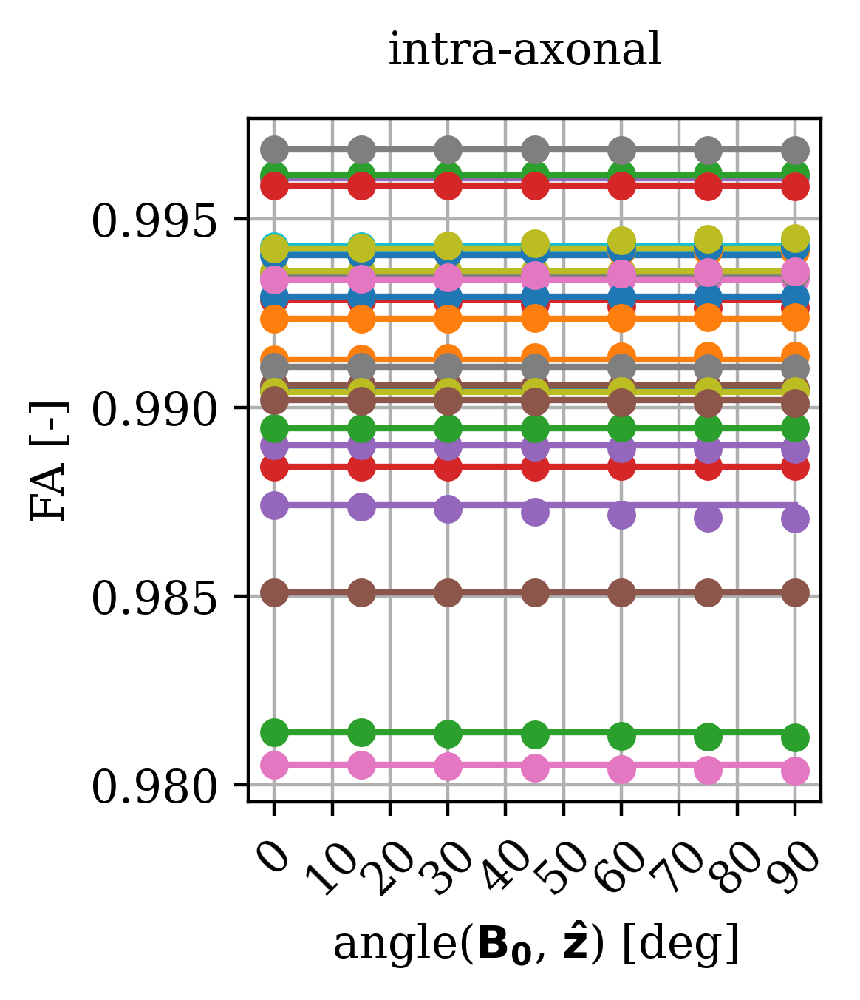

type_substrate:  synchrotron-G3-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

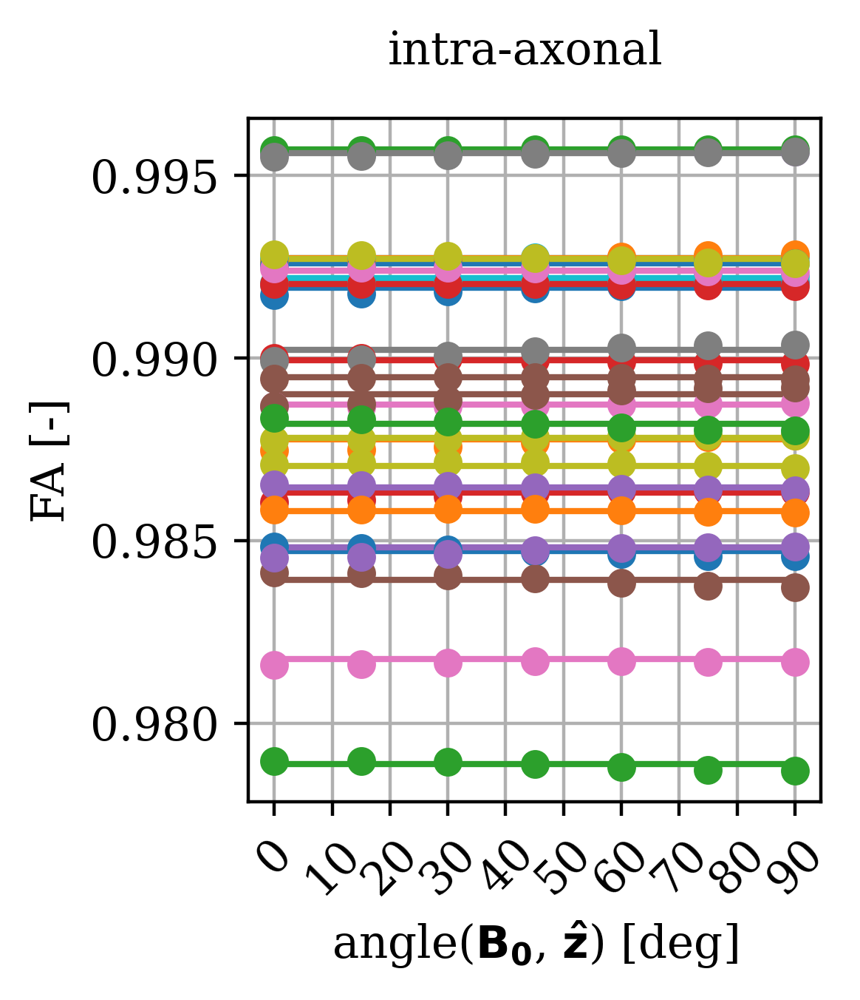

type_substrate:  synchrotron-G4-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

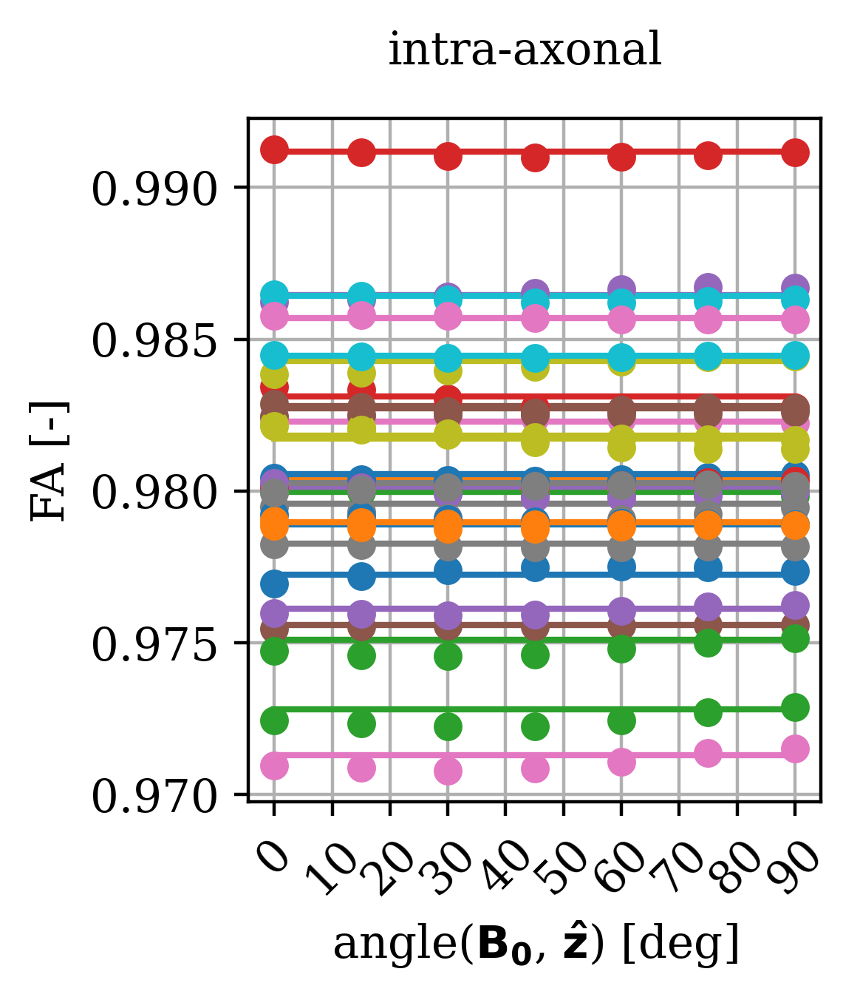

type_substrate:  synchrotron-G5-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

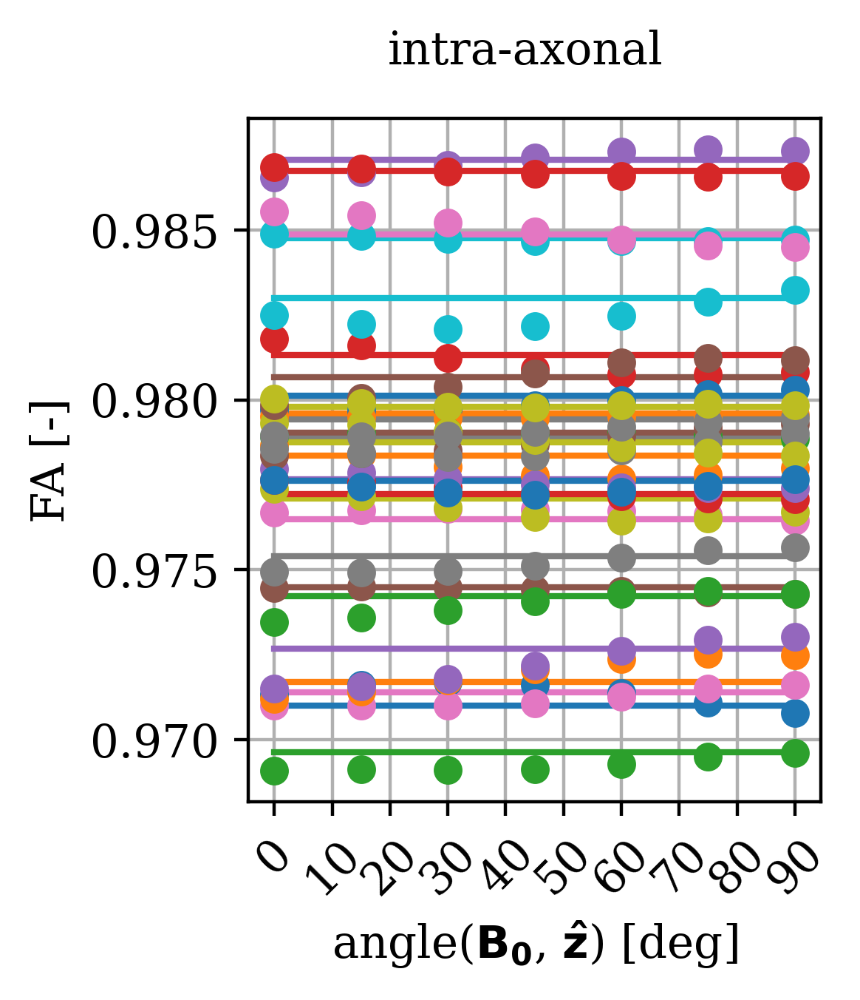

type_substrate:  synchrotron-G6-z_aligned


  0%|          | 0/30 [00:00<?, ?it/s]

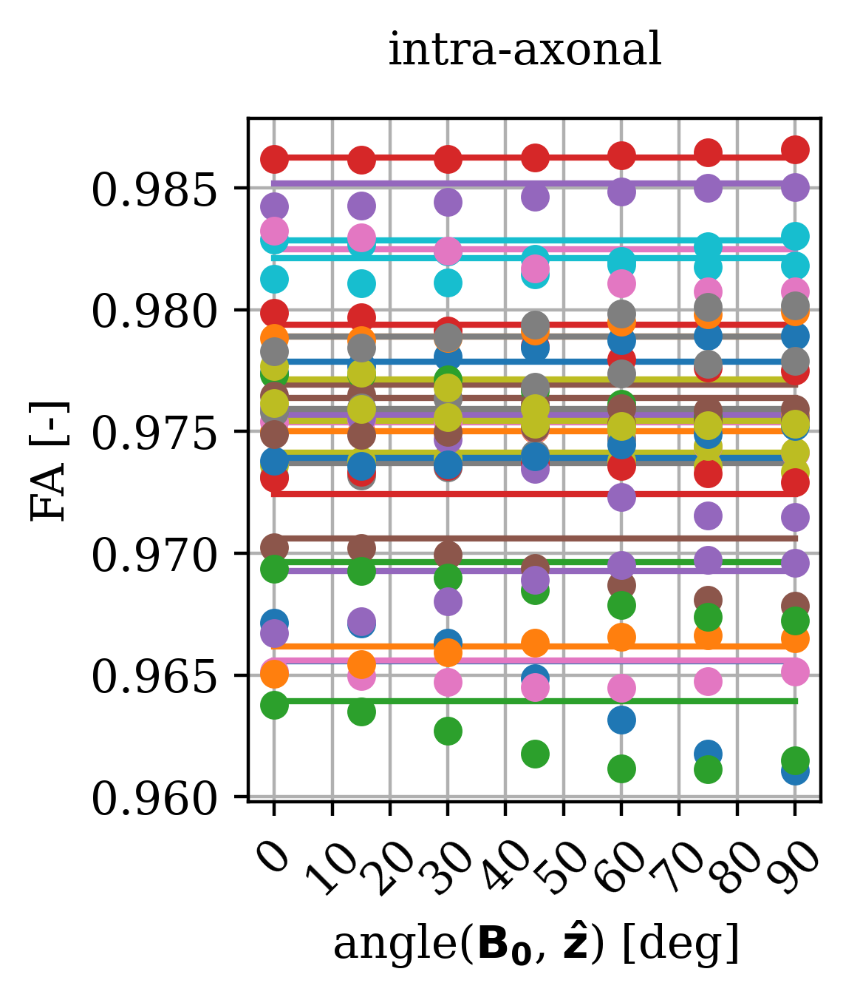

In [112]:
cmap = plt.cm.get_cmap('gnuplot2')

for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if len(per_name_substrate.keys()) == 0:
        continue
    
    axs_all = []
    figs = []
    
    if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra, ax_intra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_intra)
        figs.append(fig_intra)
        fig_intra.suptitle('intra-axonal')

    if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_extra, ax_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_extra)
        figs.append(fig_extra)
        fig_extra.suptitle('extra-axonal')

    if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra_extra, ax_intra_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_intra_extra)
        figs.append(fig_intra_extra)
        fig_intra_extra.suptitle('intra- and extra-axonal')
    
    for name_substrate, per_scheme in tqdm(per_name_substrate.items()):
        
        if name_substrate == 'all':
            continue
                
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    ax = ax_intra
                    marker = marker_intra
                elif compartment == 'extra':
                    fig = fig_extra
                    ax = ax_extra
                    marker = marker_extra
                if compartment == 'intra+extra':
                    fig = fig_intra_extra
                    ax = ax_intra_extra
                    marker = marker_intra_extra
                    
                #### coloring
                if 'helix' in type_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    if name_substrate == 'all':
                        color = 'black'
                    else:
                        color = None
        
                #### plot including only_diffusion_gradients
                fit_dt = per_contribution['signals_only_diffusion_gradients']
            
                p = ax.plot([0, 90], [fit_dt.fa[0][0][0], fit_dt.fa[0][0][0]],
                            color=color, 
                            label=name_substrate.split('_')[0])
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
            
                    ax.scatter(B_z_angle, fit_dt.fa[0][0][0], 
                               marker=marker, 
                               color=p[0].get_color(),
                               #color=color,
                               zorder=100
                               )

    for ax in axs_all:

        if 'helix' in name_substrate: ax.set_ylim(0.7, 1)
        if 'synchrotron' in name_substrate: ax.set_ylim(0.85, 1)
        ax.grid(True)
        ax.set_xticks(np.arange(0, 91, 10))
        ax.set_xticklabels(np.arange(0, 91, 10), rotation=45)
        #ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
        ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
        ax.set_ylabel('FA [-]')

#     for fig in figs:

#         fig.tight_layout()
    
    plt.show()

### PLOT: EVEC1 vs. $\hat{z}$

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned


0it [00:00, ?it/s]

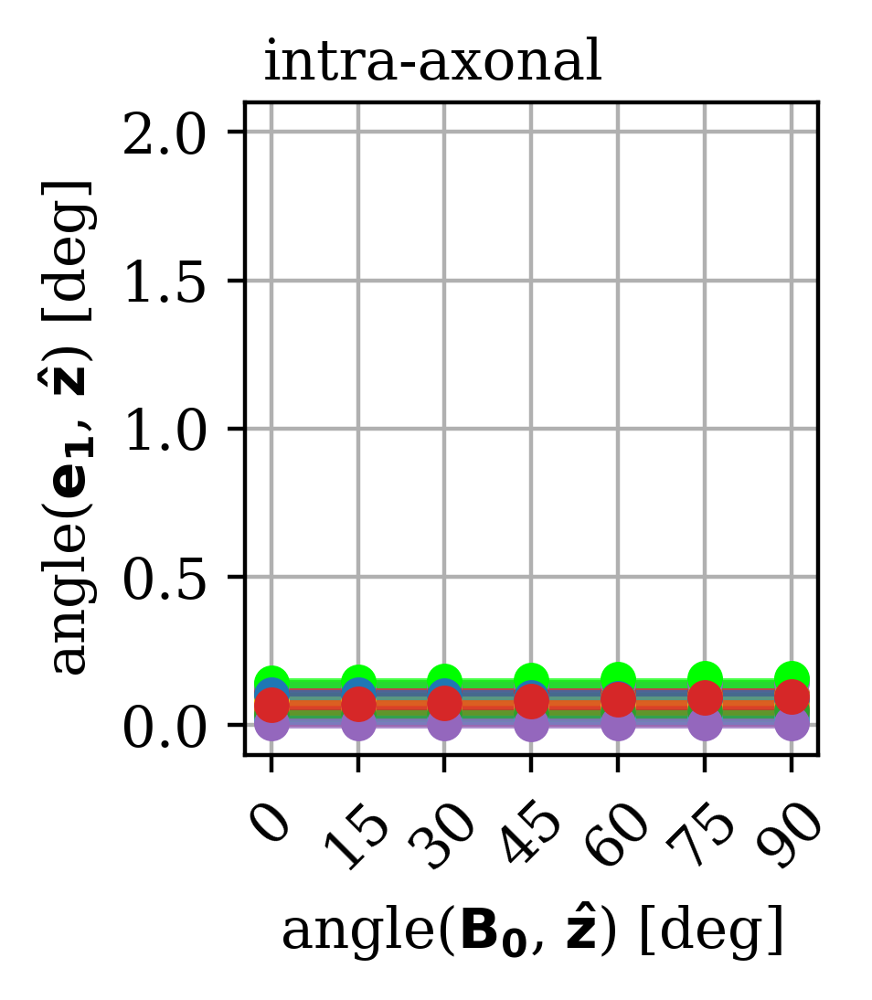

type_substrate:  synchrotron-G3-z_aligned


0it [00:00, ?it/s]

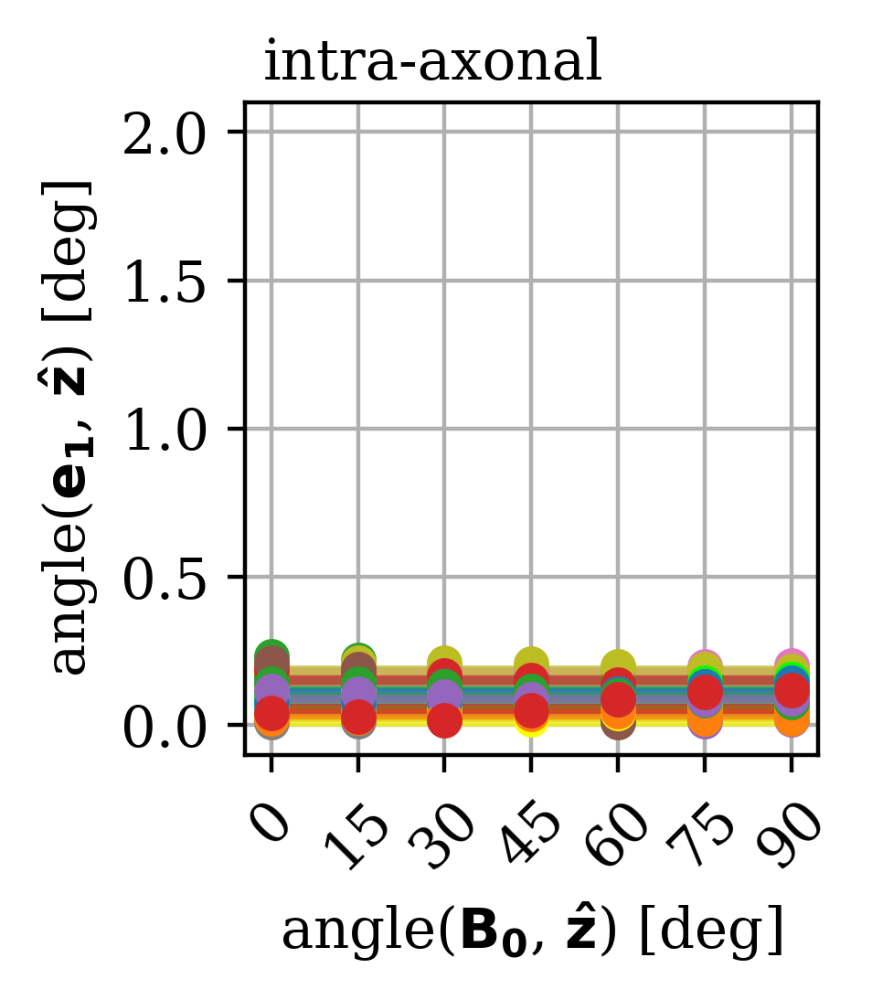

type_substrate:  synchrotron-G4-z_aligned


0it [00:00, ?it/s]

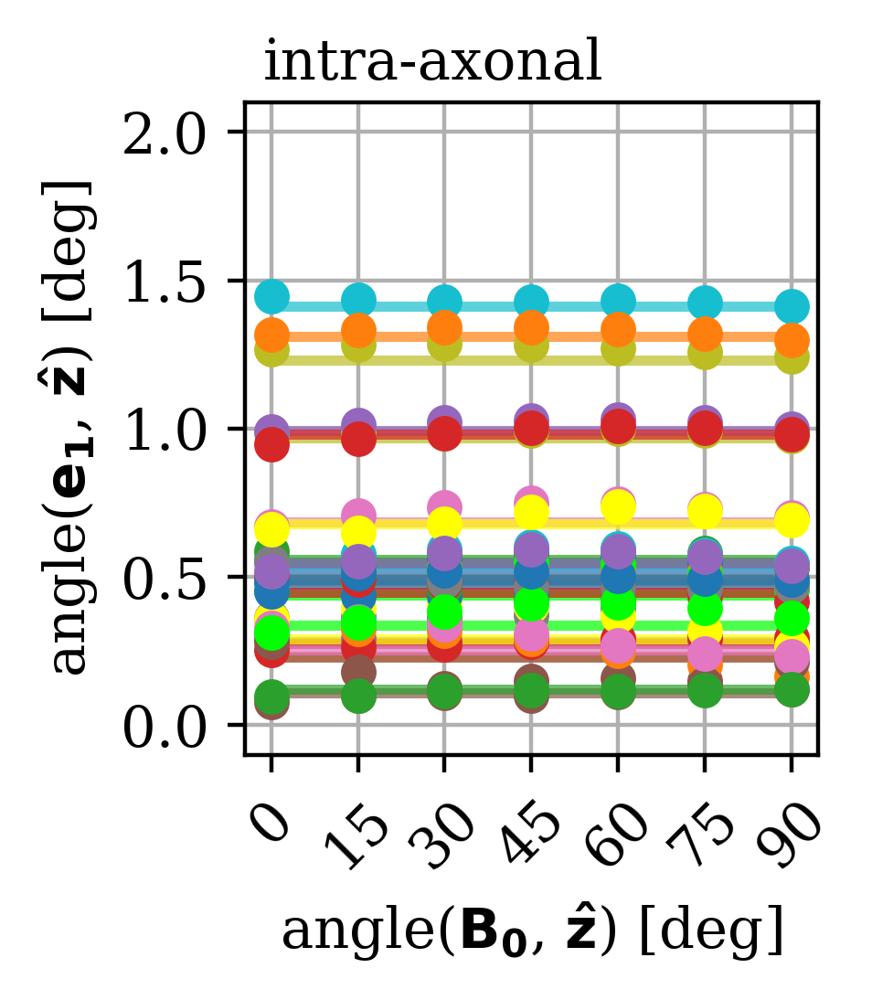

type_substrate:  synchrotron-G5-z_aligned


0it [00:00, ?it/s]

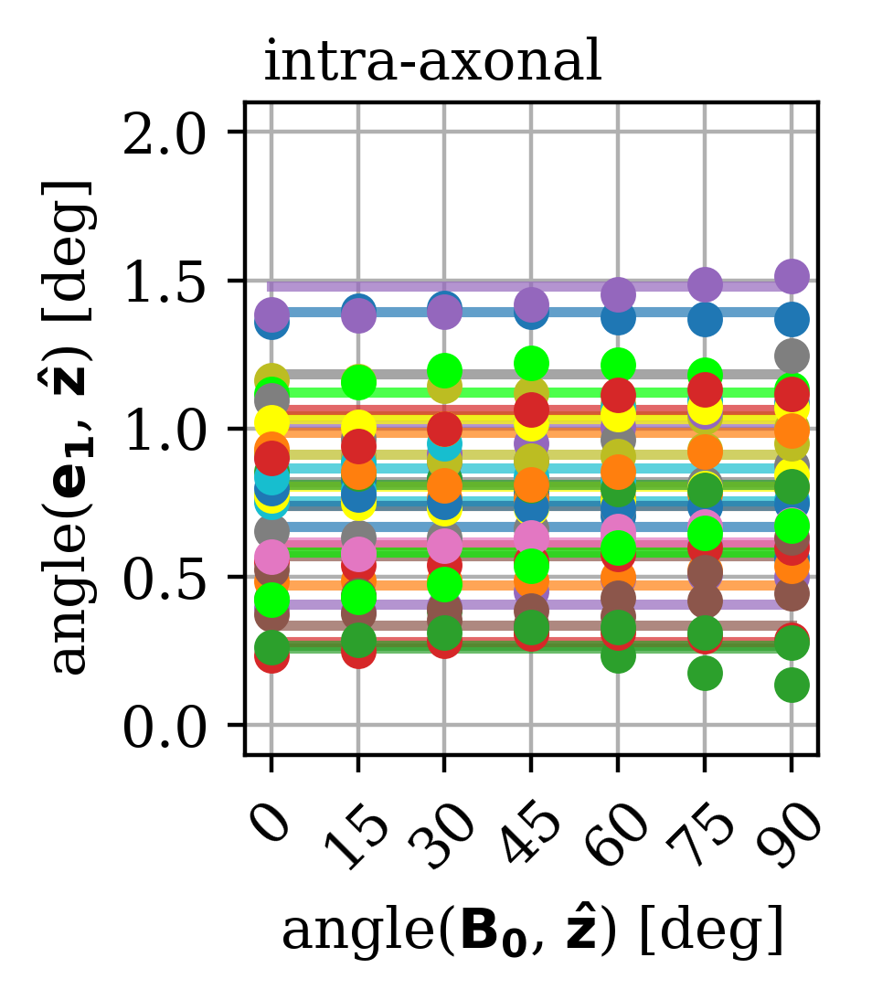

type_substrate:  synchrotron-G6-z_aligned


0it [00:00, ?it/s]

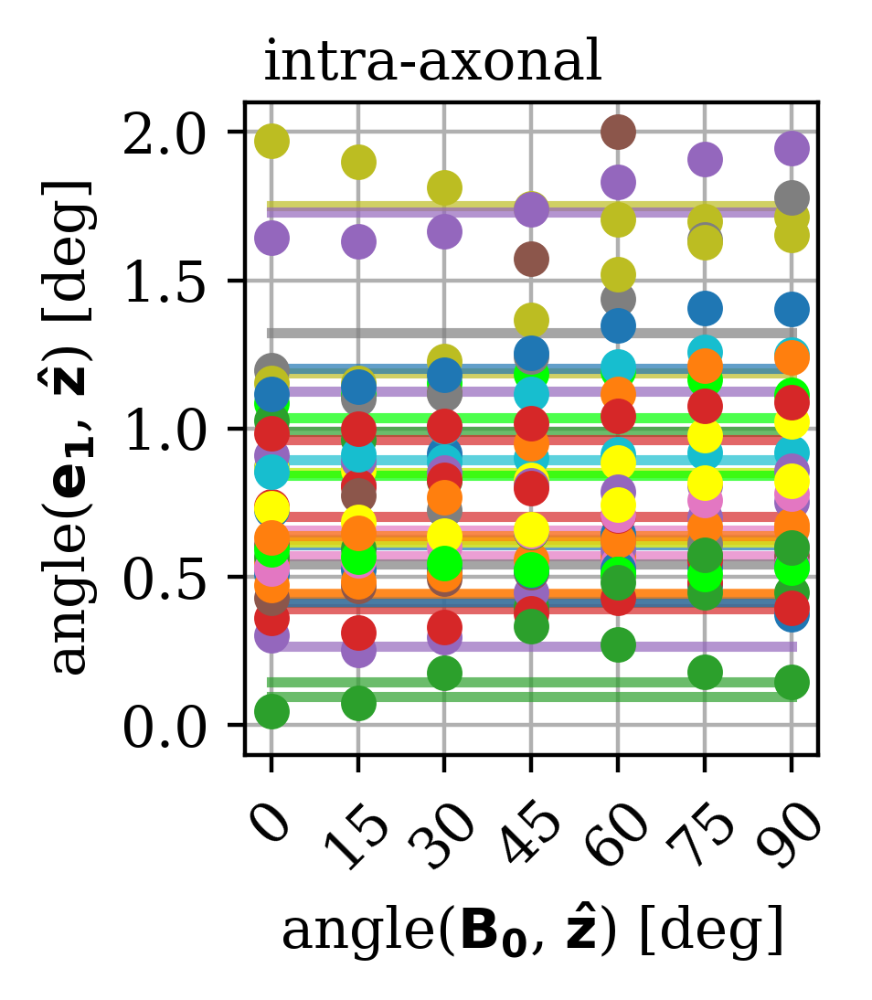

In [113]:
cmap = plt.cm.get_cmap('gnuplot2')

for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if len(per_name_substrate.keys()) == 0:
        continue
    
    axs_all = []
    figs = []
    
    if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra, ax_intra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_intra)
        figs.append(fig_intra)
        fig_intra.suptitle('intra-axonal', y=0.9)

    if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_extra, ax_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_extra)
        figs.append(fig_extra)
        fig_extra.suptitle('extra-axonal', y=0.9)

    if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra_extra, ax_intra_extra = plt.subplots(1, 1, figsize=figsize_e1_1x1)
        axs_all.append(ax_intra_extra)
        figs.append(fig_intra_extra)
        fig_intra_extra.suptitle('intra- and extra-axonal', y=0.9)
    
    for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
        if name_substrate == 'all':
            continue
        
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    ax = ax_intra
                    marker = marker_intra
                elif compartment == 'extra':
                    fig = fig_extra
                    ax = ax_extra
                    marker = marker_extra
                if compartment == 'intra+extra':
                    fig = fig_intra_extra
                    ax = ax_intra_extra
                    marker = marker_intra_extra
                    
                #### coloring
                if 'helix' in name_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    if name_substrate == 'all':
                        color = 'black'
                    else:
                        color = colors[idx_substrate]
        
                #### plot including only_diffusion_gradients
                fit_dt = per_contribution['signals_only_diffusion_gradients']
        
                evec1 = fit_dt.evecs[0][0][0][:, 0]

                angle_evec1_z = get_angles_between_vectors([evec1], np.array([0., 0., 1.]), 
                                                    symmetry_around_90=True,)

                p = ax.plot([0, 90], [angle_evec1_z, angle_evec1_z], color=color, 
                            lw=lw, alpha=0.7)
            
                label_switch = True
                
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                    
                    if label_switch:
                        if 'helix' in name_substrate:
                            r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
                            label = 'r$_{helix}$' + f' = {int(float(r_helix))} $\mu$m'
                        elif 'axon' in name_substrate:
                            label = name_substrate.split('-')[0]
                        label_switch = False
                    else:
                        label = None
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
            
                    evec1 = fit_dt.evecs[0][0][0][:, 0]

                    angle_evec1_z = get_angles_between_vectors([evec1], np.array([0., 0., 1.]), 
                                                        symmetry_around_90=True,)

                    ax.scatter(B_z_angle, angle_evec1_z, marker=marker, color=color, alpha=1, s=s, label=label, zorder=100)
                    
    #### fix legend
#     try:
#         _handles, _labels = ax_intra_extra.get_legend_handles_labels()
#         mask_legend = np.argsort(_labels)
#         ax_intra_extra.legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend],
#                               #bbox_to_anchor=(-0.27, -0.02, 1.17, .102), loc='lower left', ncol=2, borderaxespad=0.
#                               #bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.
#                               loc='upper right'
#                              )
#     except:
#         _handles, _labels = ax_intra.get_legend_handles_labels()
#         mask_legend = np.argsort(_labels)
#         ax_intra.legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend],
#                               #bbox_to_anchor=(-0.27, -0.02, 1.17, .102), loc='lower left', ncol=2, borderaxespad=0.
#                               #bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.
#                         loc='upper right'
#                              )

    for ax in axs_all:

        if 'synchrotron' in name_substrate: ax.set_ylim(0, 2)
        ax.grid(True)
        ax.set_xticks(np.arange(0, 91, 15))
        ax.set_xticklabels(np.arange(0, 91, 15), rotation=45)
        #ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
        ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
        ax.set_ylabel('angle($\mathbf{e_1}$, $\mathbf{\hat{z}}$) [deg]')
        if 'helix' in type_substrate: ax.set_ylim(-1.5, 41.5)
        if 'synchrotron' in type_substrate: ax.set_ylim(-0.1, 2.1)
    
    for fig in figs:

        fig.tight_layout()
    
    plt.show()

### PLOT: ADC

In [114]:
# cmap = plt.cm.get_cmap('gnuplot2')

# for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
    
#     print('type_substrate: ', type_substrate)
    
#     if len(per_name_substrate.keys()) == 0:
#         continue
    
#     axs_all = []
#     figs = []
    
#     if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
#         fig_intra, ax_intra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
#         axs_all.append(ax_intra)
#         figs.append(fig_intra)
#         fig_intra.suptitle('intra-axonal', y=0.9)

#     if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
#         fig_extra, ax_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
#         axs_all.append(ax_extra)
#         figs.append(fig_extra)
#         fig_extra.suptitle('extra-axonal', y=0.9)

#     if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
#         fig_intra_extra, ax_intra_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
#         axs_all.append(ax_intra_extra)
#         figs.append(fig_intra_extra)
#         fig_intra_extra.suptitle('intra- and extra-axonal', y=0.9)    
    
#     for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
#         if name_substrate == 'all':
#             continue
        
# #         if not any([t in name_substrate for t in tags_axons_oi]):
# #             continue
        
#         for scheme, per_compartment in per_scheme.items():
            
#             for compartment, per_contribution in per_compartment.items():
                
#                 if compartment == 'intra':
#                     fig = fig_intra
#                     axs = ax_intra
#                     marker = marker_intra
#                 elif compartment == 'extra':
#                     fig = fig_extra
#                     axs = ax_extra
#                     marker = marker_extra
#                 if compartment == 'intra+extra':
#                     fig = fig_intra_extra
#                     axs = ax_intra_extra
#                     marker = marker_intra_extra
                    
#                 #### coloring
#                 if 'helix' in type_substrate:
#                     weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
#                     color = cmap(weight_color)
#                     alpha = None
#                     zorder = 100
#                 else:
#                     if name_substrate == 'all':
#                         color = 'black'
#                         alpha = 1.0
#                         zorder = 100
#                     else:
#                         color = colors[idx_substrate]
#                         alpha = 0.5
#                         zorder = None
        
#                 #### plot including only_diffusion_gradients
#                 fit_dt = per_contribution['signals_only_diffusion_gradients']
                
#                 ADC = np.mean(fit_dt.evals)
#                 axs[0].plot([0, 90], [ADC, ADC], color=color, 
#                             lw=lw, alpha=0.7, zorder=zorder)

#                 ADC_para = fit_dt.evals[0][0][0][0]
#                 axs[1].plot([0, 90], [ADC_para, ADC_para], color=color,
#                                                lw=lw, alpha=alpha, zorder=zorder)

#                 ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])
#                 axs[2].plot([0, 90], [ADC_perp, ADC_perp], color=color,
#                                                lw=lw, alpha=alpha, zorder=zorder)
            
#                 label_switch = True
                
#                 ADCs = []
#                 ADCs_para = []
#                 ADCs_perp = []
#                 B_z_angles = []
            
#                 #### plot including susceptibility contributions
#                 for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                    
#                     if label_switch:
#                         if 'helix' in name_substrate:
#                             r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
#                             label = 'r$_{helix}$' + f' = {r_helix}'
#                         elif 'axon' in name_substrate:
#                             label = name_substrate.split('-')[0]
#                         label_switch = False
#                     else:
#                         label = None
                    
#                     B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
#                     B_z_angles.append(B_z_angle)
            
#                     ADC = np.mean(fit_dt.evals)
#                     ADCs.append(ADC)
#                     axs[0].scatter(B_z_angle, ADC, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder)

#                     ADC_para = fit_dt.evals[0][0][0][0]
#                     ADCs_para.append(ADC_para)
#                     axs[1].scatter(B_z_angle, ADC_para, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder)

#                     ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])            
#                     ADCs_perp.append(ADC_perp)
#                     axs[2].scatter(B_z_angle, ADC_perp, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder, label=label)

# #     #### fix legend
# #     if 'helix' in type_substrate:
# #         try:
# #             _handles, _labels = ax_extra[2].get_legend_handles_labels()
# #             mask_legend = np.argsort(_labels)
# #             ax_extra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], loc='lower right')
# #         except:
# #             _handles, _labels = ax_intra[2].get_legend_handles_labels()
# #             mask_legend = np.argsort(_labels)
# #             ax_intra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], loc='upper right')

#     for axs in axs_all:
        
#         # helix
#         if 'helix' in type_substrate:
#             axs[0].set_ylim(1.0e-4, 5.0e-4)
#             axs[1].set_ylim(2.5e-4, 6.5e-4)
#             axs[2].set_ylim(0.0e-4, 4.0e-4)

#         # synchrotron
#         if 'synchrotron' in name_substrate:
#             axs[0].set_ylim(1.5e-4, 2.5e-4)
#             axs[1].set_ylim(5.1e-4, 6.1e-4)
#             axs[2].set_ylim(0.0e-4, 1.0e-4)

#         axs[0].set_ylabel('MD [mm$^2$/s]')
#         axs[1].set_ylabel('AD [mm$^2$/s]')
#         axs[2].set_ylabel('RD [mm$^2$/s]')

#         for ax in axs:

#             ax.grid(True)
#             ax.set_xticks(np.arange(0, 91, 15))
#             ax.set_xticklabels(np.arange(0, 91, 15), rotation=45)
#             #ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
#             ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
#             ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))
    
#     for fig in figs:

#         fig.tight_layout()
    
#     plt.show()

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned


0it [00:00, ?it/s]

NameError: name 'zorder' is not defined

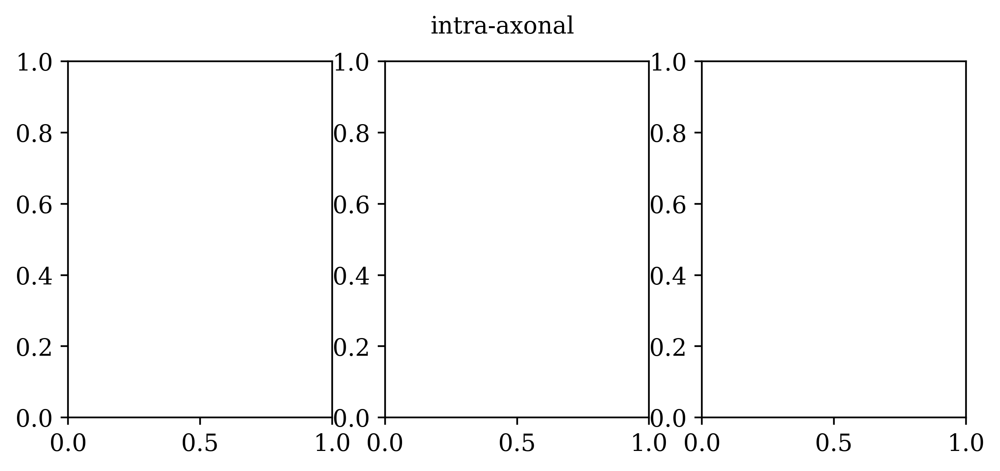

In [115]:
cmap = plt.cm.get_cmap('gnuplot2')

axs_all = []
figs = []

if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_intra, ax_intra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
    axs_all.append(ax_intra)
    figs.append(fig_intra)
    fig_intra.suptitle('intra-axonal')

if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_extra, ax_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
    axs_all.append(ax_extra)
    figs.append(fig_extra)
    fig_extra.suptitle('extra-axonal')

if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_intra_extra, ax_intra_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
    axs_all.append(ax_intra_extra)
    figs.append(fig_intra_extra)
    fig_intra_extra.suptitle('intra- and extra-axonal')    

for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if len(per_name_substrate.keys()) == 0:
        continue
    
    for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
        
        if name_substrate != 'all':
            continue
        
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    axs = ax_intra
                    marker = marker_intra
                elif compartment == 'extra':
                    fig = fig_extra
                    axs = ax_extra
                    marker = marker_extra
                if compartment == 'intra+extra':
                    fig = fig_intra_extra
                    axs = ax_intra_extra
                    marker = marker_intra_extra
                    
                #### coloring
                alpha = 1.0
                if 'helix' in type_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    color = plotting_specs[type_substrate]['color']
        
                #### plot including only_diffusion_gradients
                fit_dt = per_contribution['signals_only_diffusion_gradients']
                
                ADC = np.mean(fit_dt.evals)
                axs[0].plot([0, 90], [ADC, ADC], color=color, 
                            lw=lw, alpha=0.7, zorder=zorder)

                ADC_para = fit_dt.evals[0][0][0][0]
                axs[1].plot([0, 90], [ADC_para, ADC_para], color=color,
                                               lw=lw, alpha=alpha, zorder=zorder)

                ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])
                axs[2].plot([0, 90], [ADC_perp, ADC_perp], color=color,
                                               lw=lw, alpha=alpha, zorder=zorder, 
                            label=type_substrate.split('-')[1],
                           )
            
                label_switch = True
                
                ADCs = []
                ADCs_para = []
                ADCs_perp = []
                B_z_angles = []
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                    
                    if label_switch:
                        if 'helix' in type_substrate:
                            r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
                            label = 'r$_{helix}$' + f' = {r_helix}'
                        elif 'axon' in name_substrate:
                            label = name_substrate.split('-')[0]
                        label_switch = False
                    else:
                        label = None
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
                    B_z_angles.append(B_z_angle)
            
                    ADC = np.mean(fit_dt.evals)
                    ADCs.append(ADC)
                    axs[0].scatter(B_z_angle, ADC, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder)

                    ADC_para = fit_dt.evals[0][0][0][0]
                    ADCs_para.append(ADC_para)
                    axs[1].scatter(B_z_angle, ADC_para, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder)

                    ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])            
                    ADCs_perp.append(ADC_perp)
                    axs[2].scatter(B_z_angle, ADC_perp, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder, label=label)

    #### fix legend
    try:
        _handles, _labels = ax_extra[2].get_legend_handles_labels()
        mask_legend = np.argsort(_labels)
        ax_extra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], loc='lower right', ncol=1)
    except:
        _handles, _labels = ax_intra[2].get_legend_handles_labels()
        mask_legend = np.argsort(_labels)
        ax_intra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], loc='upper right', ncol=1)

for axs in axs_all:

    # helix
#         axs[0].set_ylim(1.0e-4, 5.0e-4)
#         axs[1].set_ylim(2.5e-4, 6.5e-4)
#         axs[2].set_ylim(0.0e-4, 4.0e-4)

    # synchrotron
    axs[0].set_ylim(1.5e-4, 2.5e-4)
#     axs[0].set_ylim(1.3e-4, 2.3e-4)
#     axs[0].set_ylim(1.9e-4, 2.2e-4)
    axs[1].set_ylim(5.1e-4, 6.1e-4)
#     axs[1].set_ylim(5.3e-4, 6.3e-4)
#     axs[2].set_ylim(0.0e-4, 1.0e-4)
    axs[2].set_ylim(0.1e-4, 1.1e-4)

    axs[0].set_ylabel('MD [mm$^2$/s]')
    axs[1].set_ylabel('AD [mm$^2$/s]')
    axs[2].set_ylabel('RD [mm$^2$/s]')

    for ax in axs:

        ax.grid(True)
        ax.set_xticks(np.arange(0, 91, 15))
        ax.set_xticklabels(np.arange(0, 91, 15), rotation=45)
        #ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
        ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
        ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

for fig in figs:

    fig.tight_layout()

plt.show()

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned


0it [00:00, ?it/s]

0.05 \pm 0.00
min 0
0.05 \pm 0.00
max 90
0.05 \pm 0.00
type_substrate:  synchrotron-G3-z_aligned


0it [00:00, ?it/s]

0.06 \pm 0.00
min 60
0.06 \pm 0.00
max 0
0.06 \pm 0.00
type_substrate:  synchrotron-G4-z_aligned


0it [00:00, ?it/s]

0.11 \pm 0.00
min 90
0.11 \pm 0.00
max 45
0.11 \pm 0.00
type_substrate:  synchrotron-G5-z_aligned


0it [00:00, ?it/s]

0.12 \pm 0.00
min 90
0.12 \pm 0.00
max 30
0.12 \pm 0.00
type_substrate:  synchrotron-G6-z_aligned


0it [00:00, ?it/s]

0.13 \pm 0.01
min 0
0.13 \pm 0.01
max 45
0.13 \pm 0.01


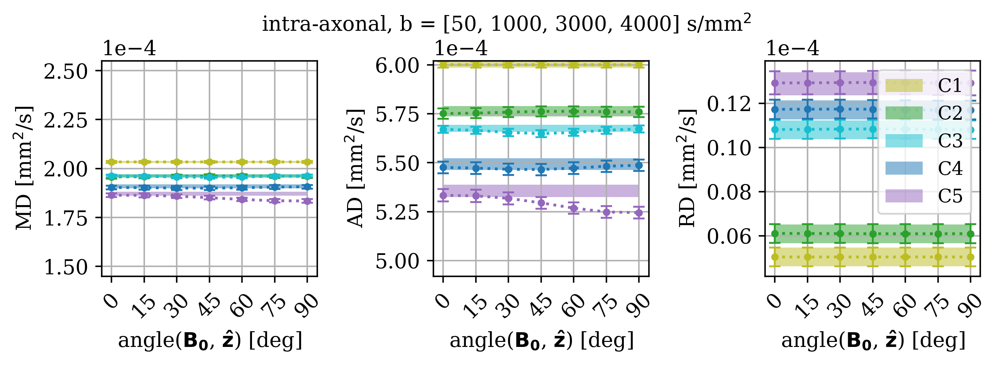

In [116]:
cmap = plt.cm.get_cmap('gnuplot2')

axs_all = []
figs = []

if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_intra, ax_intra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
    axs_all.append(ax_intra)
    figs.append(fig_intra)
    fig_intra.suptitle('intra-axonal'+f', b = {bs_oi} s/mm$^2$', y=0.9)

if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_extra, ax_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
    axs_all.append(ax_extra)
    figs.append(fig_extra)
    fig_extra.suptitle('extra-axonal', y=0.9)

if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_intra_extra, ax_intra_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
    axs_all.append(ax_intra_extra)
    figs.append(fig_intra_extra)
    fig_intra_extra.suptitle('intra- and extra-axonal', y=0.9)    

for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if len(per_name_substrate.keys()) == 0:
        continue
        
    ADCs = []
    ADCs_para = []
    ADCs_perp = []
    B_z_angles = []
    
    ADCs_nf = []
    ADCs_para_nf = []
    ADCs_perp_nf = []
    
    for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
        
        if 'G1' in type_substrate:
            label = 'C1'#+f', n={n_axons}'
        elif 'G3' in type_substrate:
            label = 'C2'#+f', n={n_axons}'
        elif 'G4' in type_substrate:
            label = 'C3'#+f', n={n_axons}'
        elif 'G5' in type_substrate:
            label = 'C4'#+f', n={n_axons}'
        elif 'G6' in type_substrate:
            label = 'C5'#+f', n={n_axons}'
        
        if name_substrate == 'all':
            continue
        
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    axs = ax_intra
                    marker = marker_intra
                elif compartment == 'extra':
                    fig = fig_extra
                    axs = ax_extra
                    marker = marker_extra
                if compartment == 'intra+extra':
                    fig = fig_intra_extra
                    axs = ax_intra_extra
                    marker = marker_intra_extra
                    
                #### coloring
                if 'helix' in name_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    color = plotting_specs[type_substrate]['color']
        
                #### plot including only_diffusion_gradients
                fit_dt = per_contribution['signals_only_diffusion_gradients']
                
                ADC = np.mean(fit_dt.evals)
                ADCs_nf.append(ADC)
                #axs[0].plot([0, 90], [ADC, ADC], color=color, 
                #            lw=lw, alpha=0.7, zorder=zorder)

                ADC_para = fit_dt.evals[0][0][0][0]
                ADCs_para_nf.append(ADC_para)
                #axs[1].plot([0, 90], [ADC_para, ADC_para], color=color,
                #                               lw=lw, alpha=alpha, zorder=zorder)

                ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])
                ADCs_perp_nf.append(ADC_perp)
                #axs[2].plot([0, 90], [ADC_perp, ADC_perp], color=color,
                #                               lw=lw, alpha=alpha, zorder=zorder, 
                #            #label=type_substrate.split('-')[1],
                #           )
            
                label_switch = True
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                    
                    if label_switch:
                        if 'helix' in name_substrate:
                            r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
                            label = 'r$_{helix}$' + f' = {r_helix}'
                        elif 'axon' in name_substrate:
                            label = name_substrate.split('-')[0]
                        label_switch = False
                    else:
                        label = None
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
                    B_z_angles.append(B_z_angle)
            
                    ADC = np.mean(fit_dt.evals)
                    ADCs.append(ADC)
                    #axs[0].scatter(B_z_angle, ADC, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder)

                    ADC_para = fit_dt.evals[0][0][0][0]
                    ADCs_para.append(ADC_para)
                    #axs[1].scatter(B_z_angle, ADC_para, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder)

                    ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])            
                    ADCs_perp.append(ADC_perp)
                    #axs[2].scatter(B_z_angle, ADC_perp, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder, label=label)
                    
    capsize = 3
    elinewidth = 1
    markeredgewidth = 1
    ls_err = ':'
    marker_err = '.'
    
    n_Bfields = 7
    n_axons = len(ADCs)//7
    
    #### ADCs
    ADCs = np.reshape(ADCs, (n_axons, 7))
    ADCs_mean = np.mean(ADCs, axis=0)
    ADCs_err = np.std(ADCs, axis=0) / np.sqrt(n_axons)

    axs[0].errorbar(B_z_angles[:n_Bfields], ADCs_mean, yerr=ADCs_err, color=color, capsize=capsize, elinewidth=elinewidth, markeredgewidth=markeredgewidth, ls=ls_err, marker=marker_err)
    
    ADCs_mean_nf = np.mean(ADCs_nf, axis=0)
    ADCs_err_nf = np.std(ADCs_nf, axis=0) / np.sqrt(n_axons)
    axs[0].fill_between([0, 90], ADCs_mean_nf-ADCs_err_nf, ADCs_mean_nf+ADCs_err_nf, color=color, 
                        alpha=0.5, ec=None)

    
    #### ADCs_para
    ADCs_para = np.reshape(ADCs_para, (n_axons, 7))
    ADCs_para_mean = np.mean(ADCs_para, axis=0)
    ADCs_para_err = np.std(ADCs_para, axis=0) / np.sqrt(n_axons)

    axs[1].errorbar(B_z_angles[:n_Bfields], ADCs_para_mean, yerr=ADCs_para_err, color=color, capsize=capsize, elinewidth=elinewidth, markeredgewidth=markeredgewidth, ls=ls_err, marker=marker_err)
    
    ADCs_para_mean_nf = np.mean(ADCs_para_nf, axis=0)
    ADCs_para_err_nf = np.std(ADCs_para_nf, axis=0) / np.sqrt(n_axons)
    axs[1].fill_between([0, 90], ADCs_para_mean_nf-ADCs_para_err_nf, ADCs_para_mean_nf+ADCs_para_err_nf, color=color, 
                        alpha=0.5, ec=None)
    
    #### ADCs_perp
    ADCs_perp = np.reshape(ADCs_perp, (n_axons, 7))
    ADCs_perp_mean = np.mean(ADCs_perp, axis=0)
    ADCs_perp_err = np.std(ADCs_perp, axis=0) / np.sqrt(n_axons)

    axs[2].errorbar(B_z_angles[:n_Bfields], ADCs_perp_mean, yerr=ADCs_perp_err, color=color, capsize=capsize, elinewidth=elinewidth, markeredgewidth=markeredgewidth, ls=ls_err, marker=marker_err)
    
    ADCs_perp_mean_nf = np.mean(ADCs_perp_nf, axis=0)
    ADCs_perp_err_nf = np.std(ADCs_perp_nf, axis=0) / np.sqrt(n_axons)
    axs[2].fill_between([0, 90], ADCs_perp_mean_nf-ADCs_perp_err_nf, ADCs_perp_mean_nf+ADCs_perp_err_nf, color=color, 
                        alpha=0.5, ec=None, 
                        #label=type_substrate.split('-')[1]+f', n={n_axons}',
#                         label=type_substrate.split('-')[1],
                        label=label
                       )

    #### table
#     # MD
#     print('%.2f \pm %.2f' %(ADCs_mean_nf*1e4, ADCs_err_nf*1e4))
#     idx_max = np.argmax(ADCs_mean)
#     idx_min = np.argmin(ADCs_mean)
#     print('min', B_z_angles[idx_min])
#     print('%.2f \pm %.2f' %(ADCs_mean[idx_min]*1e4, ADCs_err[idx_min]*1e4))
#     print('max', B_z_angles[idx_max])
#     print('%.2f \pm %.2f' %(ADCs_mean[idx_max]*1e4, ADCs_err[idx_max]*1e4))
    
#     # AD
#     print('%.2f \pm %.2f' %(ADCs_para_mean_nf*1e4, ADCs_para_err_nf*1e4))
#     idx_max = np.argmax(ADCs_para_mean)
#     idx_min = np.argmin(ADCs_para_mean)
#     print('min', B_z_angles[idx_min])
#     print('%.2f \pm %.2f' %(ADCs_para_mean[idx_min]*1e4, ADCs_para_err[idx_min]*1e4))
#     print('max', B_z_angles[idx_max])
#     print('%.2f \pm %.2f' %(ADCs_para_mean[idx_max]*1e4, ADCs_para_err[idx_max]*1e4))

    # RD
    print('%.2f \pm %.2f' %(ADCs_perp_mean_nf*1e4, ADCs_perp_err_nf*1e4))
    idx_max = np.argmax(ADCs_perp_mean)
    idx_min = np.argmin(ADCs_perp_mean)
    print('min', B_z_angles[idx_min])
    print('%.2f \pm %.2f' %(ADCs_perp_mean[idx_min]*1e4, ADCs_perp_err[idx_min]*1e4))
    print('max', B_z_angles[idx_max])
    print('%.2f \pm %.2f' %(ADCs_perp_mean[idx_max]*1e4, ADCs_perp_err[idx_max]*1e4))
    
    #### fix legend
    try:
        _handles, _labels = ax_extra[2].get_legend_handles_labels()
        mask_legend = np.argsort(_labels)
        ax_extra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], 
                           loc='lower right', ncol=1, fontsize=10)
    except:
        _handles, _labels = ax_intra[2].get_legend_handles_labels()
        mask_legend = np.argsort(_labels)
        ax_intra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], 
                           loc='upper right', ncol=1, fontsize=10)

for axs in axs_all:

    axs[0].set_ylim(1.45e-4, 2.55e-4)     
    if bs_oi == [50, 1000, 3000, 4000]:
        #axs[1].set_ylim(5.05e-4, 6.15e-4)
#         axs[1].set_ylim(4.95e-4, 6.05e-4)

        axs[1].set_ylim(4.92e-4, 6.02e-4)
        tag_fig = ''
    elif bs_oi == [4000, 8000, 12000]:
#         axs[1].set_ylim(4.92e-4, 6.02e-4)
#         tag_fig = 'a'

        axs[1].set_ylim(4.82e-4, 5.92e-4)
        tag_fig = 'b'
    else:
        #axs[1].set_ylim(4.5e-4, 5.6e-4)
#         axs[1].set_ylim(4.4e-4, 5.5e-4)
#         tag_fig = 'a'

        axs[1].set_ylim(4.92e-4, 6.02e-4)
        tag_fig = 'b'
    #axs[2].set_ylim(0.05e-4, 1.15e-4)
#     axs[2].set_ylim(0.00e-4, 1.10e-4)

    axs[0].set_ylabel('MD [mm$^2$/s]')
    axs[1].set_ylabel('AD [mm$^2$/s]')
    axs[2].set_ylabel('RD [mm$^2$/s]')

    for ax in axs:

        ax.grid(True)
        ax.set_xticks(np.arange(0, 91, 15))
        ax.set_xticklabels(np.arange(0, 91, 15), rotation=45)
        #ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
        ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
        ax.ticklabel_format(axis='y', style='sci', scilimits=(-4,-4))
        #ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

for fig in figs:

    fig.tight_layout()

path_figure = path_figures + f'/orientation_dependencies/XNH-bs_oi={bs_oi}' + tag_fig
plt.savefig(path_figure, dpi=400)
# plt.show()

#### CHECK COS^2 VS COS^4 FIT

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned
type_substrate:  synchrotron-G3-z_aligned
type_substrate:  synchrotron-G4-z_aligned
type_substrate:  synchrotron-G5-z_aligned
type_substrate:  synchrotron-G6-z_aligned


0it [00:00, ?it/s]

a, b:  0.0005244978678013196 9.231282847018529e-06
rmse:  2.7297984662244367e-07
AIC:  -207.59415012935125
a, b:  0.000525746215881518 8.571292146609704e-06
rmse:  1.0585339118739519e-06
AIC:  -188.62075992900222
0.13 \pm 0.01
min 0
0.13 \pm 0.01
max 45
0.13 \pm 0.01


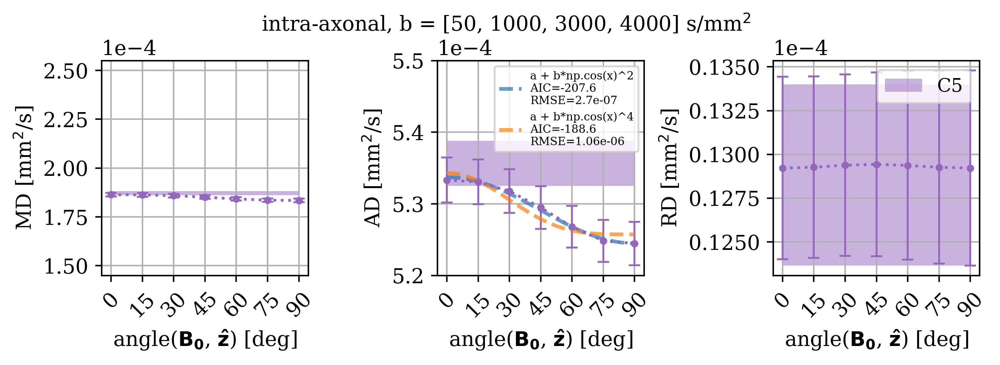

In [163]:
cmap = plt.cm.get_cmap('gnuplot2')

axs_all = []
figs = []

if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_intra, ax_intra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
    axs_all.append(ax_intra)
    figs.append(fig_intra)
    fig_intra.suptitle('intra-axonal'+f', b = {bs_oi} s/mm$^2$', y=0.9)

if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_extra, ax_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
    axs_all.append(ax_extra)
    figs.append(fig_extra)
    fig_extra.suptitle('extra-axonal', y=0.9)

if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
    fig_intra_extra, ax_intra_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
    axs_all.append(ax_intra_extra)
    figs.append(fig_intra_extra)
    fig_intra_extra.suptitle('intra- and extra-axonal', y=0.9)    

for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if 'G6' not in type_substrate:
        continue 
    
    if len(per_name_substrate.keys()) == 0:
        continue
        
    ADCs = []
    ADCs_para = []
    ADCs_perp = []
    B_z_angles = []
    
    ADCs_nf = []
    ADCs_para_nf = []
    ADCs_perp_nf = []
    
    for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
        
        if 'G1' in type_substrate:
            label = 'C1'#+f', n={n_axons}'
        elif 'G3' in type_substrate:
            label = 'C2'#+f', n={n_axons}'
        elif 'G4' in type_substrate:
            label = 'C3'#+f', n={n_axons}'
        elif 'G5' in type_substrate:
            label = 'C4'#+f', n={n_axons}'
        elif 'G6' in type_substrate:
            label = 'C5'#+f', n={n_axons}'
        
        if name_substrate == 'all':
            continue
        
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    axs = ax_intra
                    marker = marker_intra
                elif compartment == 'extra':
                    fig = fig_extra
                    axs = ax_extra
                    marker = marker_extra
                if compartment == 'intra+extra':
                    fig = fig_intra_extra
                    axs = ax_intra_extra
                    marker = marker_intra_extra
                    
                #### coloring
                if 'helix' in name_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    color = plotting_specs[type_substrate]['color']
        
                #### plot including only_diffusion_gradients
                fit_dt = per_contribution['signals_only_diffusion_gradients']
                
                ADC = np.mean(fit_dt.evals)
                ADCs_nf.append(ADC)
                #axs[0].plot([0, 90], [ADC, ADC], color=color, 
                #            lw=lw, alpha=0.7, zorder=zorder)

                ADC_para = fit_dt.evals[0][0][0][0]
                ADCs_para_nf.append(ADC_para)
                #axs[1].plot([0, 90], [ADC_para, ADC_para], color=color,
                #                               lw=lw, alpha=alpha, zorder=zorder)

                ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])
                ADCs_perp_nf.append(ADC_perp)
                #axs[2].plot([0, 90], [ADC_perp, ADC_perp], color=color,
                #                               lw=lw, alpha=alpha, zorder=zorder, 
                #            #label=type_substrate.split('-')[1],
                #           )
            
                label_switch = True
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                    
                    if label_switch:
                        if 'helix' in name_substrate:
                            r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
                            label = 'r$_{helix}$' + f' = {r_helix}'
                        elif 'axon' in name_substrate:
                            label = name_substrate.split('-')[0]
                        label_switch = False
                    else:
                        label = None
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
                    B_z_angles.append(B_z_angle)
            
                    ADC = np.mean(fit_dt.evals)
                    ADCs.append(ADC)
                    #axs[0].scatter(B_z_angle, ADC, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder)

                    ADC_para = fit_dt.evals[0][0][0][0]
                    ADCs_para.append(ADC_para)
                    #axs[1].scatter(B_z_angle, ADC_para, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder)

                    ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])            
                    ADCs_perp.append(ADC_perp)
                    #axs[2].scatter(B_z_angle, ADC_perp, marker=marker, color=color, alpha=alpha, s=s, zorder=zorder, label=label)
                    
    capsize = 3
    elinewidth = 1
    markeredgewidth = 1
    ls_err = ':'
    marker_err = '.'
    
    n_Bfields = 7
    n_axons = len(ADCs)//7
    
    #### ADCs
    ADCs = np.reshape(ADCs, (n_axons, 7))
    ADCs_mean = np.mean(ADCs, axis=0)
    ADCs_err = np.std(ADCs, axis=0) / np.sqrt(n_axons)

    axs[0].errorbar(B_z_angles[:n_Bfields], ADCs_mean, yerr=ADCs_err, color=color, capsize=capsize, elinewidth=elinewidth, markeredgewidth=markeredgewidth, ls=ls_err, marker=marker_err)
    
    ADCs_mean_nf = np.mean(ADCs_nf, axis=0)
    ADCs_err_nf = np.std(ADCs_nf, axis=0) / np.sqrt(n_axons)
    axs[0].fill_between([0, 90], ADCs_mean_nf-ADCs_err_nf, ADCs_mean_nf+ADCs_err_nf, color=color, 
                        alpha=0.5, ec=None)

    
    #### ADCs_para
    ADCs_para = np.reshape(ADCs_para, (n_axons, 7))
    ADCs_para_mean = np.mean(ADCs_para, axis=0)
    ADCs_para_err = np.std(ADCs_para, axis=0) / np.sqrt(n_axons)

    axs[1].errorbar(B_z_angles[:n_Bfields], ADCs_para_mean, yerr=ADCs_para_err, color=color, capsize=capsize, elinewidth=elinewidth, markeredgewidth=markeredgewidth, ls=ls_err, marker=marker_err)
    
    ADCs_para_mean_nf = np.mean(ADCs_para_nf, axis=0)
    ADCs_para_err_nf = np.std(ADCs_para_nf, axis=0) / np.sqrt(n_axons)
    axs[1].fill_between([0, 90], ADCs_para_mean_nf-ADCs_para_err_nf, ADCs_para_mean_nf+ADCs_para_err_nf, color=color, 
                        alpha=0.5, ec=None)
    
    if 'G6' in type_substrate:
        for model in models:
            x_fit = np.linspace(0, 90)

            #### FIT
            maxfev = 8000
            p0 = None
            bounds = None
#             p0 = (0.00052, 1e-05)
            bounds = ([-np.inf, 0], [np.inf, np.inf])
#             bounds = ([0.0005, 0], [0.00055, 2e-05])

            K = 2

            #### ADC
#             popt, pcov = curve_fit(model, B_z_angles[:n_Bfields], ADCs_para_mean, maxfev=maxfev, bounds=bounds)#, p0=p0, bounds=bounds)
            popt, pcov = curve_fit(model, B_z_angles[:n_Bfields], ADCs_para_mean, maxfev=maxfev, bounds=bounds, p0=p0, 
#                                    method='lm',
#                                    method='trf',
                                   method='dogbox',
                                  )
            a, b = popt
            print('a, b: ', a, b)
            a_std, b_std = np.sqrt(np.diag(pcov))

            rmse = sklearn.metrics.mean_squared_error(ADCs_para_mean, model(B_z_angles[:n_Bfields], a, b), squared=False)
            print('rmse: ', rmse)
    #         RMSEs['MD'][marker][model.__name__] = rmse
            RSS = np.sum((ADCs_para_mean - model(B_z_angles[:n_Bfields], a, b))**2)
            AIC = 2 * K + len(ADCs_para_mean) * np.log(RSS / len(ADCs_para_mean))
            print('AIC: ', AIC)
    #         AICs['MD'][marker][model.__name__] = AIC

    #         plt.plot(np.rad2deg(xs), _a*np.cos(xs)**2 + _b, color='tab:blue')

            tag_model = model.__name__.split('_')[-1].upper()

            if 'B' in tag_model:
                _label = 'a + b*np.cos(x)^2'
            elif 'E' in tag_model:
                _label = 'a + b*np.cos(x)^4'

            axs[1].plot(x_fit, model(x_fit, a, b), alpha=0.7, lw=lw, ls=ls, label=_label+f'\nAIC={np.round(AIC, 1)}'+f'\nRMSE={np.round(rmse, 8)}')
    
#     axs[1].legend(fontsize=8, bbox_to_anchor=(1, 0), loc="lower right")
    axs[1].legend(fontsize=6) 
    
    #### ADCs_perp
    ADCs_perp = np.reshape(ADCs_perp, (n_axons, 7))
    ADCs_perp_mean = np.mean(ADCs_perp, axis=0)
    ADCs_perp_err = np.std(ADCs_perp, axis=0) / np.sqrt(n_axons)

    axs[2].errorbar(B_z_angles[:n_Bfields], ADCs_perp_mean, yerr=ADCs_perp_err, color=color, capsize=capsize, elinewidth=elinewidth, markeredgewidth=markeredgewidth, ls=ls_err, marker=marker_err)
    
    ADCs_perp_mean_nf = np.mean(ADCs_perp_nf, axis=0)
    ADCs_perp_err_nf = np.std(ADCs_perp_nf, axis=0) / np.sqrt(n_axons)
    axs[2].fill_between([0, 90], ADCs_perp_mean_nf-ADCs_perp_err_nf, ADCs_perp_mean_nf+ADCs_perp_err_nf, color=color, 
                        alpha=0.5, ec=None, 
                        #label=type_substrate.split('-')[1]+f', n={n_axons}',
#                         label=type_substrate.split('-')[1],
                        label=label
                       )

    #### table
#     # MD
#     print('%.2f \pm %.2f' %(ADCs_mean_nf*1e4, ADCs_err_nf*1e4))
#     idx_max = np.argmax(ADCs_mean)
#     idx_min = np.argmin(ADCs_mean)
#     print('min', B_z_angles[idx_min])
#     print('%.2f \pm %.2f' %(ADCs_mean[idx_min]*1e4, ADCs_err[idx_min]*1e4))
#     print('max', B_z_angles[idx_max])
#     print('%.2f \pm %.2f' %(ADCs_mean[idx_max]*1e4, ADCs_err[idx_max]*1e4))
    
#     # AD
#     print('%.2f \pm %.2f' %(ADCs_para_mean_nf*1e4, ADCs_para_err_nf*1e4))
#     idx_max = np.argmax(ADCs_para_mean)
#     idx_min = np.argmin(ADCs_para_mean)
#     print('min', B_z_angles[idx_min])
#     print('%.2f \pm %.2f' %(ADCs_para_mean[idx_min]*1e4, ADCs_para_err[idx_min]*1e4))
#     print('max', B_z_angles[idx_max])
#     print('%.2f \pm %.2f' %(ADCs_para_mean[idx_max]*1e4, ADCs_para_err[idx_max]*1e4))

    # RD
    print('%.2f \pm %.2f' %(ADCs_perp_mean_nf*1e4, ADCs_perp_err_nf*1e4))
    idx_max = np.argmax(ADCs_perp_mean)
    idx_min = np.argmin(ADCs_perp_mean)
    print('min', B_z_angles[idx_min])
    print('%.2f \pm %.2f' %(ADCs_perp_mean[idx_min]*1e4, ADCs_perp_err[idx_min]*1e4))
    print('max', B_z_angles[idx_max])
    print('%.2f \pm %.2f' %(ADCs_perp_mean[idx_max]*1e4, ADCs_perp_err[idx_max]*1e4))
    
    #### fix legend
    try:
        _handles, _labels = ax_extra[2].get_legend_handles_labels()
        mask_legend = np.argsort(_labels)
        ax_extra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], 
                           loc='lower right', ncol=1, fontsize=10)
    except:
        _handles, _labels = ax_intra[2].get_legend_handles_labels()
        mask_legend = np.argsort(_labels)
        ax_intra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], 
                           loc='upper right', ncol=1, fontsize=10)

for axs in axs_all:

    axs[0].set_ylim(1.45e-4, 2.55e-4)     
    if bs_oi == [50, 1000, 3000, 4000]:
        #axs[1].set_ylim(5.05e-4, 6.15e-4)
#         axs[1].set_ylim(4.95e-4, 6.05e-4)

#         axs[1].set_ylim(4.92e-4, 6.02e-4)
        axs[1].set_ylim(5.2e-4, 5.5e-4)
        tag_fig = ''
    elif bs_oi == [4000, 8000, 12000]:
#         axs[1].set_ylim(4.92e-4, 6.02e-4)
#         tag_fig = 'a'

        axs[1].set_ylim(4.82e-4, 5.92e-4)
        tag_fig = 'b'
    else:
        #axs[1].set_ylim(4.5e-4, 5.6e-4)
#         axs[1].set_ylim(4.4e-4, 5.5e-4)
#         tag_fig = 'a'

        axs[1].set_ylim(4.92e-4, 6.02e-4)
        tag_fig = 'b'
    #axs[2].set_ylim(0.05e-4, 1.15e-4)
#     axs[2].set_ylim(0.00e-4, 1.10e-4)

    axs[0].set_ylabel('MD [mm$^2$/s]')
    axs[1].set_ylabel('AD [mm$^2$/s]')
    axs[2].set_ylabel('RD [mm$^2$/s]')

    for ax in axs:

        ax.grid(True)
        ax.set_xticks(np.arange(0, 91, 15))
        ax.set_xticklabels(np.arange(0, 91, 15), rotation=45)
        #ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
        ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
        ax.ticklabel_format(axis='y', style='sci', scilimits=(-4,-4))
        #ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

for fig in figs:

    fig.tight_layout()

path_figure = path_figures + f'/orientation_dependencies/XNH-bs_oi={bs_oi}' + tag_fig
plt.savefig(path_figure, dpi=400)
# plt.show()

In [153]:
?? curve_fit

In [ ]:
HEREHERE

In [305]:
path_figures

'/home/siwin/projects/susceptibility_in_silico/figures'

### PLOT: ADC AND FITS

In [29]:
def model0(x, a, b, c, d):
    x = np.deg2rad(x)
    #return a*np.cos(c * x + d)**2 + b
    return a*np.cos(c * x + d)**2 + b
    #return a*np.cos(c * x + d) + b

In [32]:
plotting_specs[type_substrate]

KeyError: 'hexagonal_helix_undulated-n_trims=1-MWF-r_tube_outer=1.50'

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G1-z_aligned


0it [00:00, ?it/s]

NameError: name 'model0' is not defined

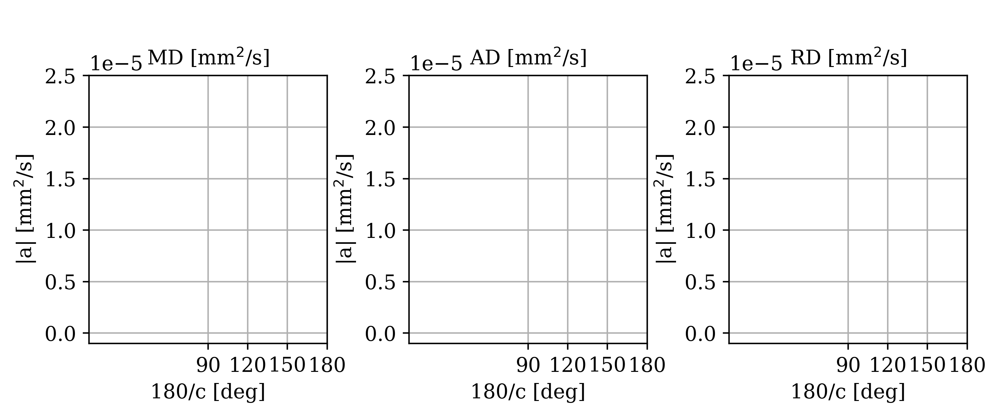

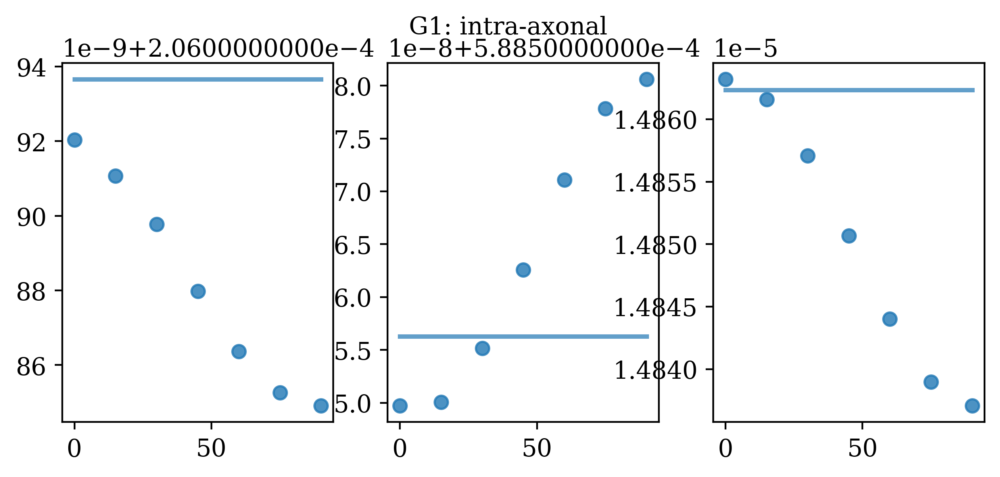

In [86]:
cmap = plt.cm.get_cmap('gnuplot2')

#### figure for fitting parameters
fig_intra_1, ax_intra_1 = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
fig_intra_1.suptitle(' ')
fig_intra_1.tight_layout()

for ax in ax_intra_1:
    ax.grid(True)
    ax.set_xticks(np.arange(90, 180+1, 30))
    ax.set_xticklabels(np.arange(90, 180+1, 30), rotation=0)
    ax.set_xlabel('180/c [deg]')
    ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))
    ax.set_ylabel('|a| [mm$^2$/s]')
    ax.set_ylim(-0.1e-5, 2.5e-5)
    
ax_intra_1[0].set_title('MD [mm$^2$/s]')
ax_intra_1[1].set_title('AD [mm$^2$/s]')
ax_intra_1[2].set_title('RD [mm$^2$/s]')

####

for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
    
    print('type_substrate: ', type_substrate)
    
    if len(per_name_substrate.keys()) == 0:
        continue
    
    axs_all = []
    figs = []
    
    if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra, ax_intra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
        axs_all.append(ax_intra)
        figs.append(fig_intra)
        if 'synchrotron' in type_substrate:
            fig_intra.suptitle(type_substrate.split('-')[1]+': intra-axonal')
        else:
            fig_intra.suptitle('intra-axonal')

    if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_extra, ax_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
        axs_all.append(ax_extra)
        figs.append(fig_extra)
        fig_extra.suptitle('extra-axonal')

    if 'intra+extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra_extra, ax_intra_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
        axs_all.append(ax_intra_extra)
        figs.append(fig_intra_extra)
        fig_intra_extra.suptitle('intra- and extra-axonal')    
    
    for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    axs = ax_intra
                    fig_1 = fig_intra_1
                    axs_1 = ax_intra_1
                    marker = marker_intra
                elif compartment == 'extra':
                    fig = fig_extra
                    axs = ax_extra
                    marker = marker_extra
                if compartment == 'intra+extra':
                    fig = fig_intra_extra
                    axs = ax_intra_extra
                    marker = marker_intra_extra
                    
                #### coloring
                if 'helix' in name_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    color = colors[idx_substrate]
        
                #### plot including only_diffusion_gradients
                fit_dt = per_contribution['signals_only_diffusion_gradients']
                
                ADC = np.mean(fit_dt.evals)
                axs[0].plot([0, 90], [ADC, ADC], color=color, 
                            lw=lw, alpha=0.7)

                ADC_para = fit_dt.evals[0][0][0][0]
                axs[1].plot([0, 90], [ADC_para, ADC_para], color=color,
                                               lw=lw, alpha=0.7)

                ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])
                axs[2].plot([0, 90], [ADC_perp, ADC_perp], color=color,
                                               lw=lw, alpha=0.7)
            
                label_switch = True
                
                ADCs = []
                ADCs_para = []
                ADCs_perp = []
                B_z_angles = []
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                    
                    if label_switch:
                        if 'helix' in name_substrate:
                            r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
                            label = 'r$_{helix}$' + f' = {r_helix}'
                        elif 'axon' in name_substrate:
                            label = name_substrate.split('-')[0]
                        label_switch = False
                    else:
                        label = None
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
                    if B_z_angle > 90:
                        continue
                    B_z_angles.append(B_z_angle)
            
                    ADC = np.mean(fit_dt.evals)
                    ADCs.append(ADC)
                    axs[0].scatter(B_z_angle, ADC, marker=marker, color=color, alpha=0.8, s=s)

                    ADC_para = fit_dt.evals[0][0][0][0]
                    ADCs_para.append(ADC_para)
                    axs[1].scatter(B_z_angle, ADC_para, marker=marker, color=color, alpha=0.8, s=s)

                    ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])            
                    ADCs_perp.append(ADC_perp)
                    axs[2].scatter(B_z_angle, ADC_perp, marker=marker, color=color, alpha=0.8, s=s, label=label)
                    
                #### fitting
                
                B_z_angles_plotting = np.arange(np.min(B_z_angles), np.max(B_z_angles)+1)
                
                # ADC
                popt, pcov = curve_fit(model0, B_z_angles, ADCs, maxfev=5000, bounds=([-np.inf, -np.inf, 0.9, -np.pi/3.], [np.inf, np.inf, 2.1, np.pi/3.]))
    
                a, b, c, d = popt
                a_std, b_std, c_std, d_std = np.sqrt(np.diag(pcov))
                x_fit = np.arange(-10, 100, 1)
                #chi2, p = scipy.stats.chisquare(f_obs=ADCs, f_exp=model0(B_z_angles, a, b, c, d), ddof=4)

                axs[0].plot(B_z_angles_plotting, model0(B_z_angles_plotting, a, b, c, d), color=color, ls=':')
                
                ax_intra_1[0].scatter(180/c, np.abs(a), color=plotting_specs[type_substrate]['color'], alpha=0.5)
                
                # ADC_para
                popt, pcov = curve_fit(model0, B_z_angles, ADCs_para, maxfev=5000, bounds=([-np.inf, -np.inf, 0.9, -np.pi/3.], [np.inf, np.inf, 2.1, np.pi/3.]))
    
                a, b, c, d = popt
                a_std, b_std, c_std, d_std = np.sqrt(np.diag(pcov))
                x_fit = np.arange(-10, 100, 1)
                #chi2, p = scipy.stats.chisquare(f_obs=ADCs_para, f_exp=model0(B_z_angles, a, b, c, d), ddof=4)

                axs[1].plot(B_z_angles_plotting, model0(B_z_angles_plotting, a, b, c, d), color=color, ls=':')
                
                ax_intra_1[1].scatter(180/c, np.abs(a), color=plotting_specs[type_substrate]['color'], alpha=0.5)
                
                # ADC_perp
                popt, pcov = curve_fit(model0, B_z_angles, ADCs_perp, maxfev=5000, bounds=([-np.inf, -np.inf, 0.9, -np.pi/3.], [np.inf, np.inf, 2.1, np.pi/3.]))
    
                a, b, c, d = popt
                a_std, b_std, c_std, d_std = np.sqrt(np.diag(pcov))
                x_fit = np.arange(-10, 100, 1)
                #chi2, p = scipy.stats.chisquare(f_obs=ADCs_perp, f_exp=model0(B_z_angles, a, b, c, d), ddof=4)

                axs[2].plot(B_z_angles_plotting, model0(B_z_angles_plotting, a, b, c, d), color=color, ls=':')
                
                if 'axon06' in name_substrate:
                    label = type_substrate.split('-')[1]
                else:
                    label = None
                    
                ax_intra_1[2].scatter(180/c, np.abs(a), color=plotting_specs[type_substrate]['color'], alpha=0.5,
                                     label=label)
            

    #### fix legend
#     try:
#         _handles, _labels = ax_extra[2].get_legend_handles_labels()
#         mask_legend = np.argsort(_labels)
#         ax_extra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], loc='lower right')
#     except:
#         _handles, _labels = ax_intra[2].get_legend_handles_labels()
#         mask_legend = np.argsort(_labels)
#         ax_intra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], loc='upper right')

    for axs in axs_all:

    #     axs[0].set_ylim(1.0e-4, 5.0e-4)
    #     axs[1].set_ylim(2.5e-4, 6.5e-4)
    #     axs[2].set_ylim(0.0e-4, 4.0e-4)

        axs[0].set_ylim(1.5e-4, 2.5e-4)
        axs[1].set_ylim(5.0e-4, 6.0e-4)
        axs[2].set_ylim(0.0e-4, 1.0e-4)

        axs[0].set_ylabel('MD$_{DTI}$ [mm$^2$/s]')
        axs[1].set_ylabel('AD$_{DTI}$ [mm$^2$/s]')
        axs[2].set_ylabel('RD$_{DTI}$ [mm$^2$/s]')

        for ax in axs:

            ax.grid(True)
            ax.set_xticks(np.arange(0, 91, 15))
            ax.set_xticklabels(np.arange(0, 91, 15), rotation=45)
            #ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
            ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
            ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))
    
    for fig in figs:

        fig.tight_layout()
    
ax_intra_1[2].legend(loc='upper right')

plt.show()

In [29]:
len([0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.65, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16, 0.16])

5500

In [59]:
# #### NAME CONVERSION: ECCENTRICITIES

# path_eccentricities = os.path.join(path_substrates, type_substrate, 'eccentricities')

# for name in os.listdir(path_eccentricities):
    
#     path_from = os.path.join(path_eccentricities, name)
    
#     name_lower = name.lower()
#     name_to = name_lower.split('_')[0] + '-interval_sampling=' + name_lower.split('_')[2] + '.txt'
#     path_to = os.path.join(path_eccentricities, name_to)
    
#     os.system(f'mv {path_from} {path_to}')

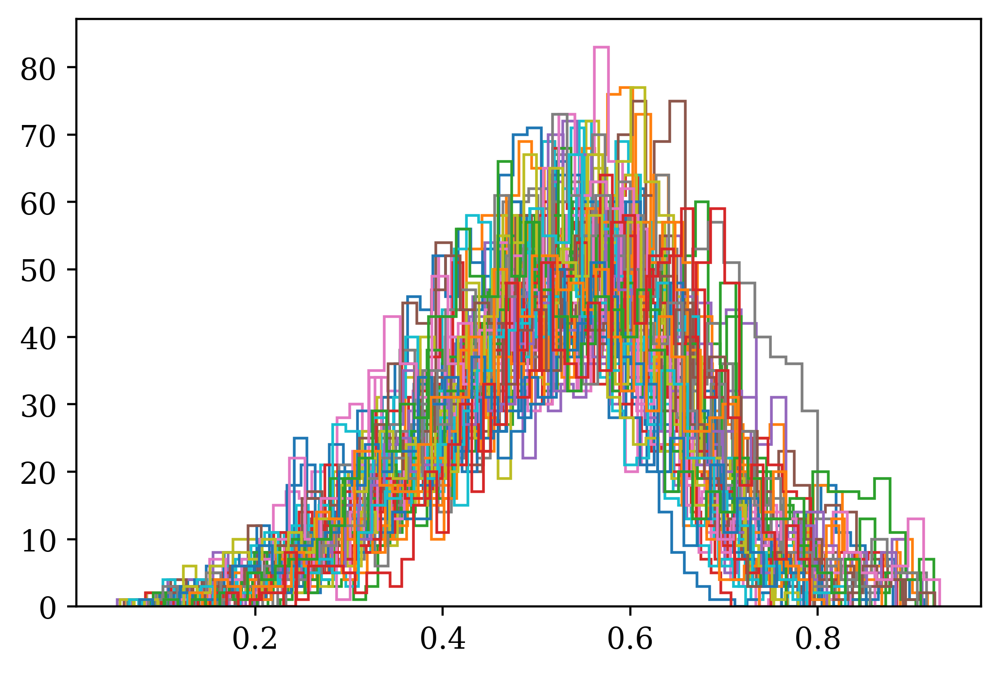

In [60]:
path_eccentricities = os.path.join(path_substrates, type_substrate, 'eccentricities')

for name in os.listdir(path_eccentricities):
    
    
    path_eccentricity = os.path.join(path_eccentricities, name)
    
    eccentricity = np.loadtxt(path_eccentricity)
    
    plt.hist(eccentricity, bins=50, histtype='step')

### PLOT: ADC AND FITS AND ECCENTRICITIES (G6 only)

In [61]:
plt.close('all')

  0%|          | 0/5 [00:00<?, ?it/s]

type_substrate:  synchrotron-G6-z_aligned


0it [00:00, ?it/s]

a, b, 180/c, d =  5.999999098628741e-05 0.0004993139917539825 199.89106743814966 -1.2135098817680834
a, b, 180/c, d =  -5.8114098229854934e-05 0.0006128713979487503 168.63846522832273 -0.00840071577076359
a, b, 180/c, d =  5.9983439033724975e-05 0.0005359219803700817 307.83396701632586 -1.0025481034844543
a, b, 180/c, d =  4.928147280197463e-05 0.0004814452368984806 171.85043792702035 -1.3788877873182401
a, b, 180/c, d =  -4.4501787766285736e-05 0.0005844695955870365 352.5281017482825 0.7253761708179876
a, b, 180/c, d =  5.999999999918527e-05 0.0005313941399437674 168.44122131364446 -1.5088591677809413


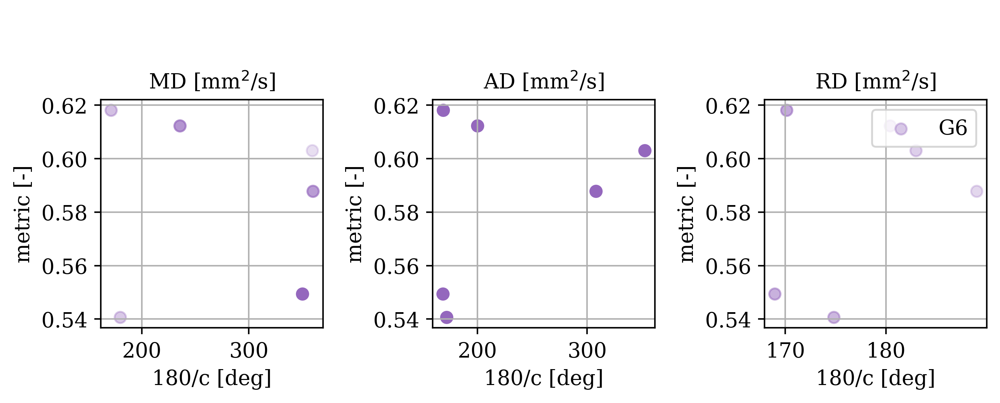

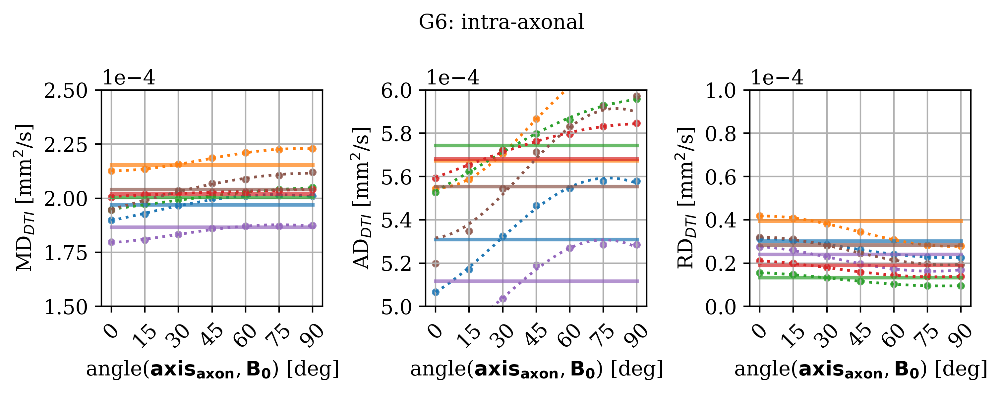

In [62]:
cmap = plt.cm.get_cmap('gnuplot2')

#### figure for fitting parameters
fig_intra_1, ax_intra_1 = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
fig_intra_1.suptitle(' ')

for ax in ax_intra_1:
    ax.grid(True)
#     ax.set_xticks(np.arange(90, 180+1, 30))
#     ax.set_xticklabels(np.arange(90, 180+1, 30), rotation=0)
    ax.set_xlabel('180/c [deg]')
    #ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))
    #ax.set_ylabel('median(e$_{\perp axon}$) [-]')
    ax.set_ylabel('metric [-]')
    #ax.set_ylim(-0.1e-5, 2.5e-5)
    
ax_intra_1[0].set_title('MD [mm$^2$/s]')
ax_intra_1[1].set_title('AD [mm$^2$/s]')
ax_intra_1[2].set_title('RD [mm$^2$/s]')

####

for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
    
    if 'G6' not in type_substrate:
        continue
    
    print('type_substrate: ', type_substrate)
    
    if len(per_name_substrate.keys()) == 0:
        continue
    
    axs_all = []
    figs = []

    if 'intra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra, ax_intra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
        axs_all.append(ax_intra)
        figs.append(fig_intra)
        if 'synchrotron' in type_substrate:
            fig_intra.suptitle(type_substrate.split('-')[1]+': intra-axonal')
        else:
            fig_intra.suptitle('intra-axonal')

    if 'extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_extra, ax_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
        axs_all.append(ax_extra)
        figs.append(fig_extra)
        fig_extra.suptitle('extra-axonal')

    if 'intra-extra' in per_name_substrate[next(iter(per_name_substrate.keys()))][path_scheme_file].keys():
        fig_intra_extra, ax_intra_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
        axs_all.append(ax_intra_extra)
        figs.append(fig_intra_extra)
        fig_intra_extra.suptitle('intra- and extra-axonal') 
        
#     path_fractions = os.path.join(path_substrates, type_substrate, 'fractions_area-res_z=0.655')
#     path_fractions = os.path.join(path_substrates, type_substrate, 'fractions_circumference-res_z=0.655')
#     path_fractions = os.path.join(path_substrates, type_substrate, 'asymmetries_abs-para-res_z=0.655')
#     path_fractions = os.path.join(path_substrates, type_substrate, 'asymmetries_rel-para-res_z=0.655')
#     path_fractions = os.path.join(path_substrates, type_substrate, 'asymmetries_abs-perp-res_z=0.655')
#     path_fractions = os.path.join(path_substrates, type_substrate, 'asymmetries_rel-perp-res_z=0.655')
    path_fractions = os.path.join(path_substrates, type_substrate, 'asymmetries_IoU-perp-res_z=0.655')
#     path_fractions = os.path.join(path_substrates, type_substrate, 'asymmetries_IoU-para-res_z=0.655')
    
    for idx_substrate, (name_substrate, per_scheme) in tqdm(enumerate(per_name_substrate.items())):
        
#         if not any([t in name_substrate for t in tags_axons_oi]):
#             continue

        
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    axs = ax_intra
                    fig_1 = fig_intra_1
                    axs_1 = ax_intra_1
                    marker = marker_intra
                elif compartment == 'extra':
                    fig = fig_extra
                    axs = ax_extra
                    marker = marker_extra
                if compartment == 'intra+extra':
                    fig = fig_intra_extra
                    axs = ax_intra_extra
                    marker = marker_intra_extra
                    
                #### coloring
                if 'helix' in name_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    color = colors[idx_substrate]
        
                #### plot including only_diffusion_gradients
                fit_dt = per_contribution['signals_only_diffusion_gradients']
                
                ADC = np.mean(fit_dt.evals)
                axs[0].plot([0, 90], [ADC, ADC], color=color, 
                            lw=lw, alpha=0.7)

                ADC_para = fit_dt.evals[0][0][0][0]
                axs[1].plot([0, 90], [ADC_para, ADC_para], color=color,
                                               lw=lw, alpha=0.7)

                ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])
                axs[2].plot([0, 90], [ADC_perp, ADC_perp], color=color,
                                               lw=lw, alpha=0.7)
            
                label_switch = True
                
                ADCs = []
                ADCs_para = []
                ADCs_perp = []
                B_z_angles = []
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                    
                    if label_switch:
                        if 'helix' in name_substrate:
                            r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
                            label = 'r$_{helix}$' + f' = {r_helix}'
                        elif 'axon' in name_substrate:
                            label = name_substrate.split('-')[0]
                        label_switch = False
                    else:
                        label = None
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
                    if B_z_angle > 90:
                        continue
                    B_z_angles.append(B_z_angle)
            
                    ADC = np.mean(fit_dt.evals)
                    ADCs.append(ADC)
                    axs[0].scatter(B_z_angle, ADC, marker=marker, color=color, alpha=0.8, s=s)

                    ADC_para = fit_dt.evals[0][0][0][0]
                    ADCs_para.append(ADC_para)
                    axs[1].scatter(B_z_angle, ADC_para, marker=marker, color=color, alpha=0.8, s=s)

                    ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])            
                    ADCs_perp.append(ADC_perp)
                    axs[2].scatter(B_z_angle, ADC_perp, marker=marker, color=color, alpha=0.8, s=s, label=label)
                    
                #### get eccentricities
                #path_metric = os.path.join(path_eccentricities, f'{name_substrate}-interval_sampling=150nm.txt')
                path_metric = os.path.join(path_fractions, f'{name_substrate}.txt')
    
                metric = np.loadtxt(path_metric)
#                 metric_mean = np.mean(metric)
#                 metric_mean = np.std(metric)
#                 metric_mean = np.median(metric)
                metric_mean = np.mean(np.sort(metric)[:int(len(metric)/4)]) # mean of lower quartile
                
                
                #### fitting
                maxfev = 5000
                #p0 = None
                p0 = (2e-5, 3e-4, 1., 0.)
                #bounds = ([-np.inf, -np.inf, -np.inf, -np.inf], [np.inf, np.inf, np.inf, np.inf])
                #bounds = ([-6e-5, -np.inf, 0.5, -np.inf], [6e-5, np.inf, np.inf, np.inf])
                bounds = ([-6e-5, -np.inf, 0.5, -np.inf], [6e-5, np.inf, 2, np.inf])
                
                
                B_z_angles_plotting = np.arange(np.min(B_z_angles), np.max(B_z_angles)+1)
                
                # ADC
                popt, pcov = curve_fit(model0, B_z_angles, ADCs, maxfev=maxfev, p0=p0,bounds=bounds)
    
                a, b, c, d = popt
                a_std, b_std, c_std, d_std = np.sqrt(np.diag(pcov))
                x_fit = np.arange(-10, 100, 1)
                #chi2, p = scipy.stats.chisquare(f_obs=ADCs, f_exp=model0(B_z_angles, a, b, c, d), ddof=4)

                axs[0].plot(B_z_angles_plotting, model0(B_z_angles_plotting, a, b, c, d), color=color, ls=':')
                
                ax_intra_1[0].scatter(180/c, metric_mean, color=plotting_specs[type_substrate]['color'], alpha=min(1, np.abs(a)/2.5e-5))
#                 ax_intra_1[0].errorbar(180/c, metric_mean, yerr=metric_std, color=plotting_specs[type_substrate]['color'], 
#                                        alpha=np.abs(a)/2.5e-5,
#                                        marker=marker,
#                                        capsize=12, elinewidth=3, markeredgewidth=3,)
                
                # ADC_para
                popt, pcov = curve_fit(model0, B_z_angles, ADCs_para, maxfev=maxfev, p0=p0,bounds=bounds)
    
                a, b, c, d = popt
                a_std, b_std, c_std, d_std = np.sqrt(np.diag(pcov))
                x_fit = np.arange(-10, 100, 1)
                #chi2, p = scipy.stats.chisquare(f_obs=ADCs_para, f_exp=model0(B_z_angles, a, b, c, d), ddof=4)

                axs[1].plot(B_z_angles_plotting, model0(B_z_angles_plotting, a, b, c, d), color=color, ls=':')
                
                print('a, b, 180/c, d = ', a, b, 180/c, d)
                ax_intra_1[1].scatter(180/c, metric_mean, color=plotting_specs[type_substrate]['color'], alpha=min(1, np.abs(a)/2.5e-5))
#                 ax_intra_1[1].scatter(180/c, metric_mean, color=color, alpha=min(1, np.abs(a)/2.5e-5))
                #ax_intra_1[1].scatter(np.rad2deg(np.pi/c), metric_mean, color=plotting_specs[type_substrate]['color'], alpha=min(1, np.abs(a)/2.5e-5))
#                 ax_intra_1[1].errorbar(180/c, eccentricity_mean, yerr=eccentricity_std, color=plotting_specs[type_substrate]['color'], 
#                                        alpha=np.abs(a)/2.5e-5,
#                                        marker=marker,
#                                        capsize=12, elinewidth=3, markeredgewidth=3,)
                
                # ADC_perp
                popt, pcov = curve_fit(model0, B_z_angles, ADCs_perp, maxfev=maxfev, p0=p0,bounds=bounds)
    
                a, b, c, d = popt
                a_std, b_std, c_std, d_std = np.sqrt(np.diag(pcov))
                x_fit = np.arange(-10, 100, 1)
                #chi2, p = scipy.stats.chisquare(f_obs=ADCs_perp, f_exp=model0(B_z_angles, a, b, c, d), ddof=4)

                axs[2].plot(B_z_angles_plotting, model0(B_z_angles_plotting, a, b, c, d), color=color, ls=':')
                
                if 'axon06' in name_substrate:
                    label = type_substrate.split('-')[1]
                else:
                    label = None
                    
                ax_intra_1[2].scatter(180/c, metric_mean, color=plotting_specs[type_substrate]['color'], alpha=min(1, np.abs(a)/2.5e-5),
                                     label=label)
#                 ax_intra_1[2].errorbar(180/c, metric_mean, yerr=metric_std, color=plotting_specs[type_substrate]['color'], 
#                                        alpha=np.abs(a)/2.5e-5,
#                                        marker=marker,
#                                        capsize=12, elinewidth=3, markeredgewidth=3,
#                                        label=label)
            

    #### fix legend
#     try:
#         _handles, _labels = ax_extra[2].get_legend_handles_labels()
#         mask_legend = np.argsort(_labels)
#         ax_extra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], loc='lower right')
#     except:
#         _handles, _labels = ax_intra[2].get_legend_handles_labels()
#         mask_legend = np.argsort(_labels)
#         ax_intra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], loc='upper right')

    for axs in axs_all:

    #     axs[0].set_ylim(1.0e-4, 5.0e-4)
    #     axs[1].set_ylim(2.5e-4, 6.5e-4)
    #     axs[2].set_ylim(0.0e-4, 4.0e-4)

        axs[0].set_ylim(1.5e-4, 2.5e-4)
        axs[1].set_ylim(5.0e-4, 6.0e-4)
        axs[2].set_ylim(0.0e-4, 1.0e-4)

        axs[0].set_ylabel('MD$_{DTI}$ [mm$^2$/s]')
        axs[1].set_ylabel('AD$_{DTI}$ [mm$^2$/s]')
        axs[2].set_ylabel('RD$_{DTI}$ [mm$^2$/s]')

        for ax in axs:

            ax.grid(True)
            ax.set_xticks(np.arange(0, 91, 15))
            ax.set_xticklabels(np.arange(0, 91, 15), rotation=45)
            #ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
            ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
            ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))

    for fig in figs:

        fig.tight_layout()

#             plt.show()
    
ax_intra_1[2].legend(loc='upper right')
fig_intra_1.tight_layout()

plt.show()

In [35]:
metric = np.loadtxt(path_metric)
np.mean(np.sort(metric)[:int(len(np.sort(metric))/4)]) # mean of lower quartile

0.5494416743775601

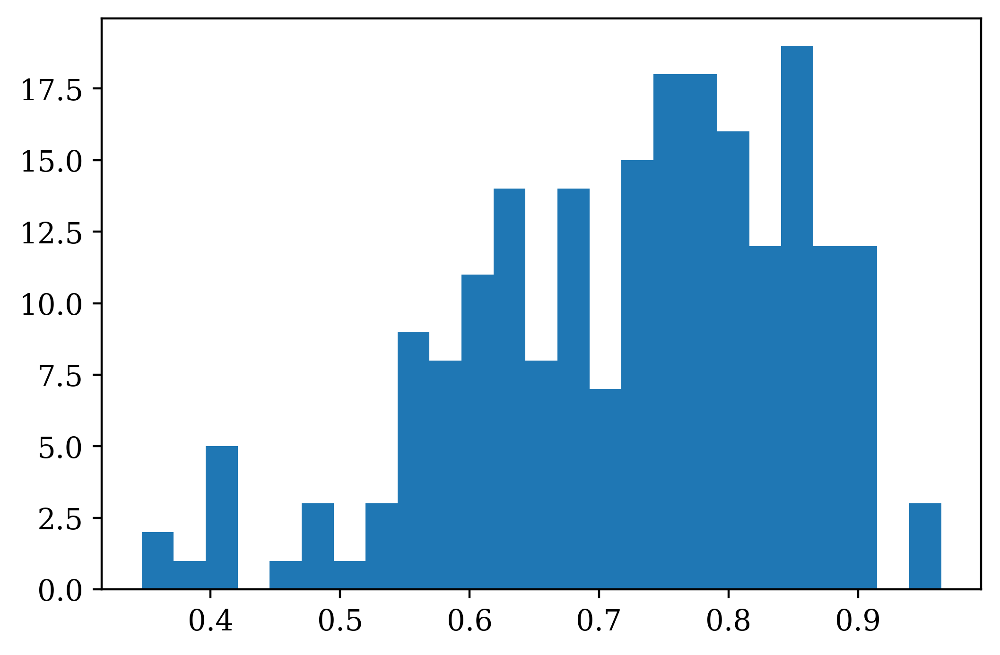

In [36]:
plt.hist(metric, bins=25)
plt.show()

In [79]:
a = set([(0, 5), (2, 3)])
b = set([(0, 1), (2, 3)])

print(a & b)
print(a | b)

{(2, 3)}
{(2, 3), (0, 5), (0, 1)}


In [71]:
a = 0.8
b = 1.2

min(a, b) / max(a, b)

0.6666666666666667

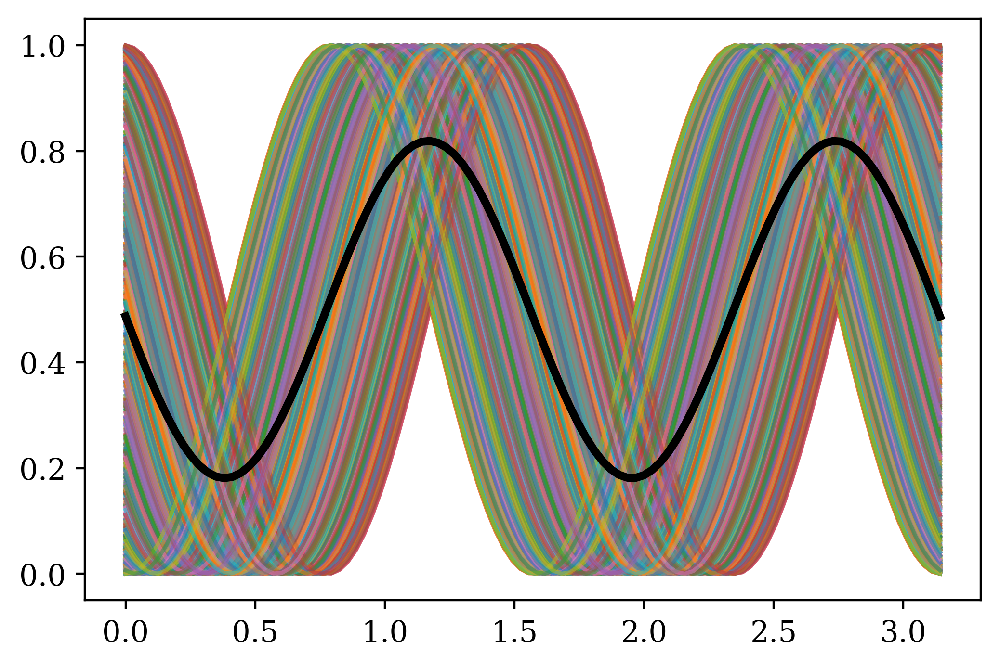

In [68]:
def some_model(angle, phase_shift):
    
    return np.cos(2*angle + phase_shift)**2

angles = np.linspace(0, np.pi, 100)

phase_shifts = np.random.uniform(0, np.pi/2, 1000)

ys = []

for phase_shift in phase_shifts:
    
    y = some_model(angles, phase_shift)
    ys.append(y)

    plt.plot(angles, y, alpha=0.5)
    
plt.plot(angles, np.mean(np.array(ys), axis=0), color='black', lw=3)

### PLOT: ADC RELATIVE

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

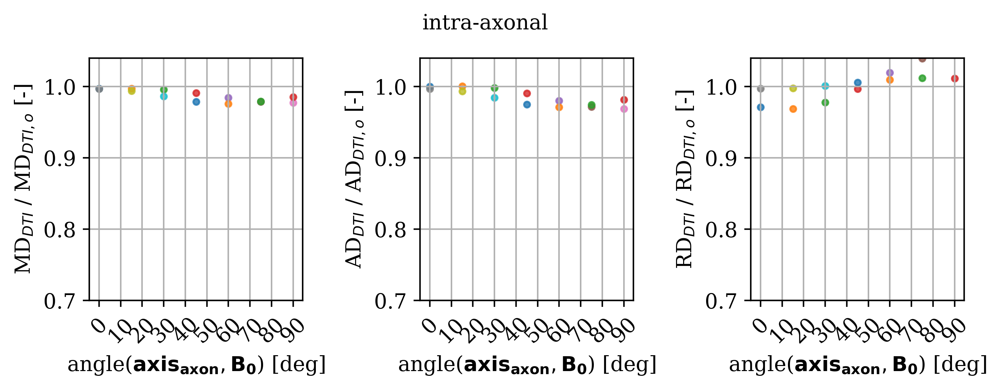

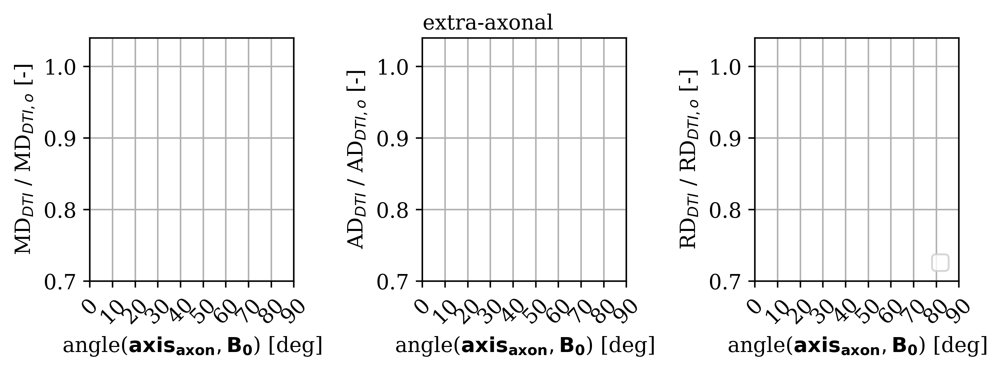

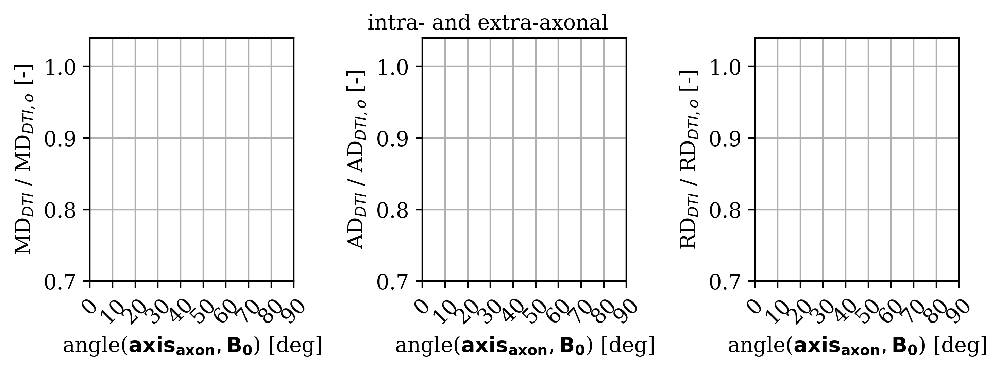

In [28]:
cmap = plt.cm.get_cmap('gnuplot2')

fig_intra, ax_intra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
fig_intra.suptitle('intra-axonal', y=0.95)

fig_extra, ax_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
fig_extra.suptitle('extra-axonal', y=0.9)

fig_intra_extra, ax_intra_extra = plt.subplots(1, 3, figsize=figsize_ADC_3x1)
fig_intra_extra.suptitle('intra- and extra-axonal', y=0.9)

for type_substrate, per_name_substrate in tqdm(tensorfits_per_substrate_type.items()):
    
    for name_substrate, per_scheme in tqdm(per_name_substrate.items()):
        
        for scheme, per_compartment in per_scheme.items():
            
            for compartment, per_contribution in per_compartment.items():
                
                if compartment == 'intra':
                    fig = fig_intra
                    axs = ax_intra
                    marker = marker_intra
                elif compartment == 'extra':
                    fig = fig_extra
                    axs = ax_extra
                    marker = marker_extra
                if compartment == 'intra+extra':
                    fig = fig_intra_extra
                    axs = ax_intra_extra
                    marker = marker_intra_extra
                    
                #### coloring
                if 'helix' in name_substrate:
                    weight_color = float(name_substrate.split('r_helix=')[-1].split('-')[0]) / 8.
                    color = cmap(weight_color)
                else:
                    color = None
        
                #### plot including only_diffusion_gradients
                fit_dt = per_contribution['signals_only_diffusion_gradients']
                
                ADC_no_field = np.mean(fit_dt.evals)
                ADC_para_no_field = fit_dt.evals[0][0][0][0]
                ADC_perp_no_field = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]])
            
                label_switch = True
            
                #### plot including susceptibility contributions
                for name_Bfield, fit_dt in per_contribution['signals_all_gradients'].items():
                    
                    if label_switch:
                        r_helix = name_substrate.split('r_helix=')[-1].split('-')[0]
                        label = 'r$_{helix}$' + f' = {r_helix}'
                        label_switch = False
                    else:
                        label = None
                    
                    B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
            
                    ADC = np.mean(fit_dt.evals) / ADC_no_field
                    axs[0].scatter(B_z_angle, ADC, marker=marker, color=color, alpha=0.8, s=s)

                    ADC_para = fit_dt.evals[0][0][0][0] / ADC_para_no_field
                    axs[1].scatter(B_z_angle, ADC_para, marker=marker, color=color, alpha=0.8, s=s)

                    ADC_perp = np.mean([fit_dt.evals[0][0][0][1], fit_dt.evals[0][0][0][2]]) / ADC_perp_no_field
                    axs[2].scatter(B_z_angle, ADC_perp, marker=marker, color=color, alpha=0.8, s=s, label=label)

#### fix legend
_handles, _labels = ax_extra[2].get_legend_handles_labels()
mask_legend = np.argsort(_labels)
ax_extra[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], loc='lower right')
                    
for axs in [ax_intra, ax_extra, ax_intra_extra]:
    
    axs[0].set_ylim(0.7, 1.04)
    axs[1].set_ylim(0.7, 1.04)
    axs[2].set_ylim(0.7, 1.04)
    
    axs[0].set_ylabel('MD$_{DTI}$ / MD$_{DTI,o}$ [-]')
    axs[1].set_ylabel('AD$_{DTI}$ / AD$_{DTI,o}$ [-]')
    axs[2].set_ylabel('RD$_{DTI}$ / RD$_{DTI,o}$ [-]')
    
    for ax in axs:
        
        ax.grid(True)
        ax.set_xticks(np.arange(0, 91, 10))
        ax.set_xticklabels(np.arange(0, 91, 10), rotation=45)
        #ax.set_xlabel(r'angle($\mathbf{axis_{axon}}, \mathbf{B_0}$) [deg]')
        ax.set_xlabel(r'angle($\mathbf{B_0}$, $\mathbf{\hat{z}}}$) [deg]')
        ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))
    
for fig in [fig_intra, fig_extra, fig_intra_extra]:
    
    fig.tight_layout()

##### RELATIVE

  0%|          | 0/5 [00:00<?, ?it/s]


 G1_zAligned


  0%|          | 0/1 [00:00<?, ?it/s]

path_config:  /dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/G1_zAligned/Axon02_straight_meanD_closed.conf

 G3_zAligned


  0%|          | 0/1 [00:00<?, ?it/s]

path_config:  /dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/G3_zAligned/G3_axon02_zAligned_closed.conf

 G4_zAligned


  0%|          | 0/1 [00:00<?, ?it/s]

path_config:  /dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/G4_zAligned/Axon02_curved_meanD_closed.conf

 G5_zAligned


  0%|          | 0/1 [00:00<?, ?it/s]

path_config:  /dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/G5_zAligned/G5_axon02_zAligned_closed.conf

 G6_zAligned


  0%|          | 0/1 [00:00<?, ?it/s]

path_config:  /dtu-compute/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/G6_zAligned/Axon02_smoothedSynch.conf


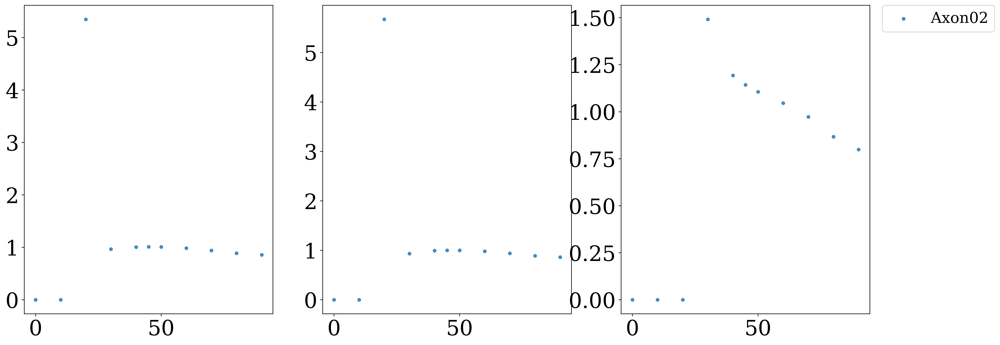

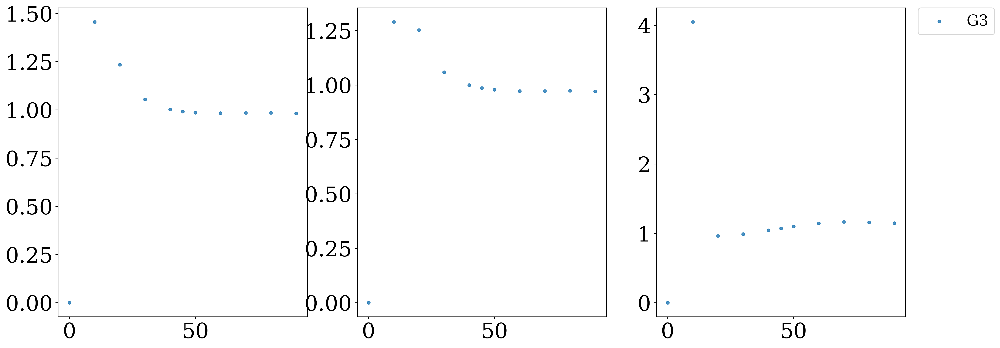

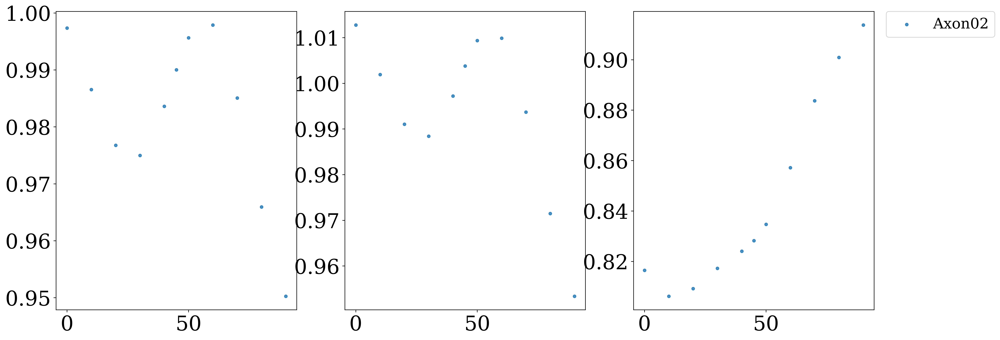

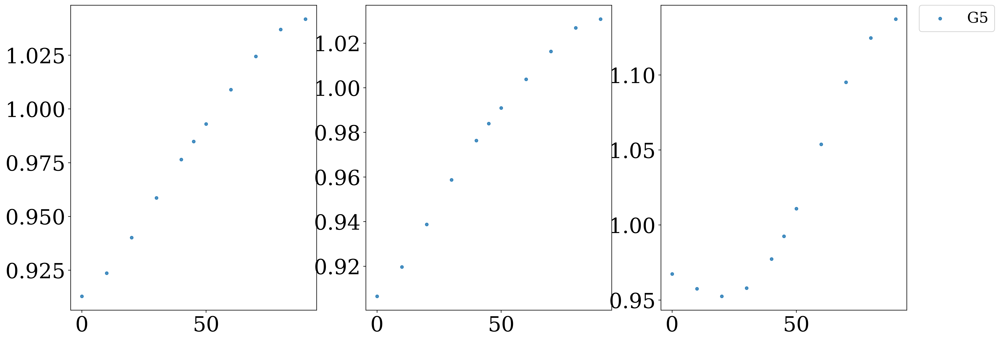

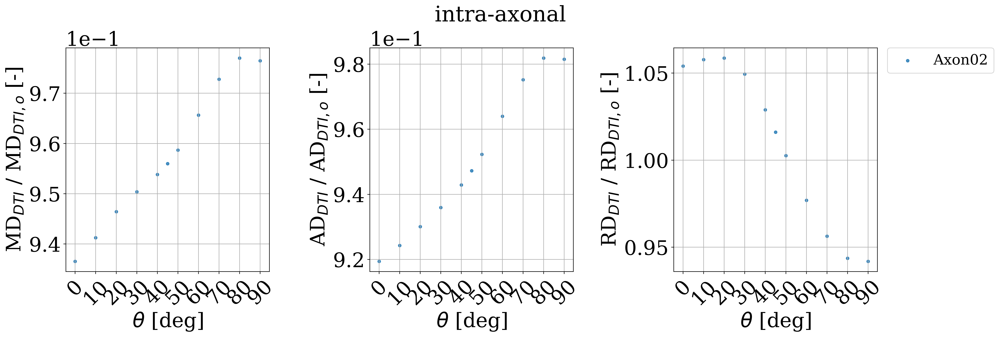

In [38]:
cmap = plt.cm.get_cmap('gnuplot2')   

scaler = 1

for name_substrate_master, d in tqdm(data.items()):
    
    fig, axs = plt.subplots(1, 3, figsize=(20, 7.5))
    
    print('\n', name_substrate_master)
    
    for (path_config, _), color in zip(tqdm(d.items()), colors):
        
        name_substrate = path_config.split('/')[-1].replace('.conf', '')
            
        print('path_config: ', path_config)
        
        experiment = d[path_config]['experiment']
        
        if 'net_contribution' not in experiment.signals.keys():
            continue
        
        DT_fit_no_field = experiment.signals['DT_fit']['no_Bfield'] #for normalization
        
        label_switch = True
        
        for name_Bfield, _ in experiment.signals['net_contribution'].items():
            
            if label_switch == True:
                label = name_substrate.split('_')[0]
                label_switch = False
            else:
                label = None
            
            B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
            
            DT_fit = experiment.signals['DT_fit'][name_Bfield]
            
            ADC = np.mean(DT_fit.evals) / np.mean(DT_fit_no_field.evals)
            axs[0].scatter(B_z_angle, ADC*scaler, marker=marker, color=color, alpha=0.8, s=s)
            
            ADC_para = DT_fit.evals[0][0][0][0] / DT_fit_no_field.evals[0][0][0][0]
            axs[1].scatter(B_z_angle, ADC_para*scaler, marker=marker, color=color, alpha=0.8, s=s)
            
            ADC_perp = np.mean([DT_fit.evals[0][0][0][1], DT_fit.evals[0][0][0][2]]) / np.mean([DT_fit_no_field.evals[0][0][0][1], DT_fit_no_field.evals[0][0][0][2]])
            axs[2].scatter(B_z_angle, ADC_perp*scaler, marker=marker, color=color, alpha=0.8, s=s,
                           label=label)

#     _handles, _labels = axs[2].get_legend_handles_labels()
#     mask_legend = np.argsort(np.array(_labels)[::len(experiment.signals['net_contribution'].items())])
#     axs[2].legend(np.array(_handles)[::len(experiment.signals['net_contribution'].items())][mask_legend], 
#                   np.array(_labels)[::len(experiment.signals['net_contribution'].items())][mask_legend], 
#                   fontsize=20, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    _handles, _labels = axs[2].get_legend_handles_labels()
    mask_legend = np.argsort(_labels)
    axs[2].legend(np.array(_handles)[mask_legend], np.array(_labels)[mask_legend], 
                  fontsize=20, bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    
for ax in axs:
    ax.ticklabel_format(axis='y', style='sci', scilimits=(0,0))
    ax.set_xlabel(r'$\theta$ [deg]')
    #ax.set_xticks([0, 30, 60, 90])
    ax.set_xticks(np.arange(0, 91, 10))
    ax.set_xticklabels(np.arange(0, 91, 10), rotation=45)
    ax.grid(True)
    
axs[0].set_ylabel('MD$_{DTI}$ / MD$_{DTI,o}$ [-]')
axs[1].set_ylabel('AD$_{DTI}$ / AD$_{DTI,o}$ [-]')
axs[2].set_ylabel('RD$_{DTI}$ / RD$_{DTI,o}$ [-]')

fig.suptitle('intra-axonal', fontsize=30, y=0.9)

# if thres_r_helix == 4.:
#     axs[0].set_ylim(0.5, 1.4)
#     axs[1].set_ylim(0.5, 1.4)
#     axs[2].set_ylim(0.5, 1.4)
# elif thres_r_helix == 0.6:
#     axs[0].set_ylim(0.895, 1.015)
#     axs[0].set_yticks([0.9, 1.0])
#     axs[1].set_ylim(0.895, 1.015)
#     axs[1].set_yticks([0.9, 1.0])
#     axs[2].set_ylim(0.75, 1.4)

# axs[0].set_ylim(0.5, 1.4)
# axs[1].set_ylim(0.5, 1.4)
# axs[2].set_ylim(0.5, 1.4)
    
plt.grid(True)
        
fig.tight_layout()

# PLOT: MD

In [82]:
import matplotlib.ticker as mtick
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 400

  0%|          | 0/1 [00:00<?, ?it/s]


 G6_zAligned


  0%|          | 0/12 [00:00<?, ?it/s]

ValueError: could not convert string to float: '/dtu'

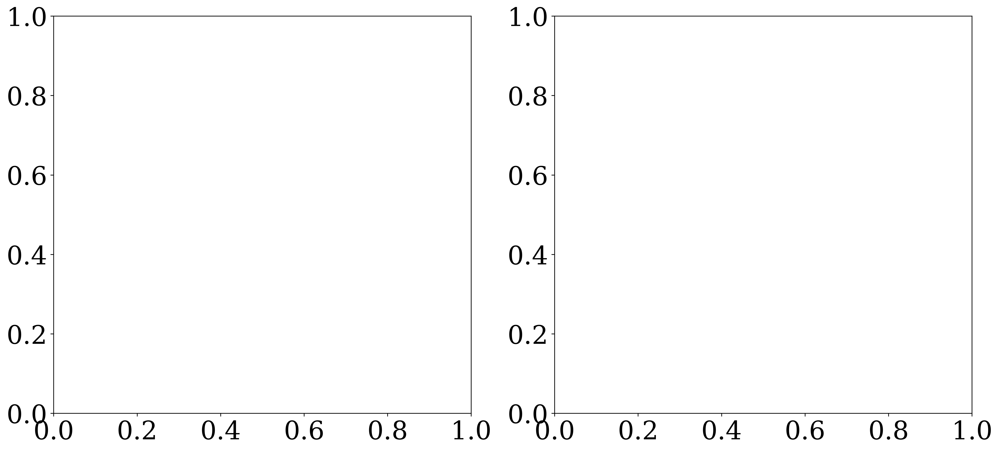

In [83]:
cmap = plt.cm.get_cmap('gnuplot2')   

scaler = 1e3

for name_substrate_master, d in tqdm(data.items()):
    
    fig, axs = plt.subplots(1, 2, figsize=(18, 8))
    
    print('\n', name_substrate_master)
    
    for path_config, _ in tqdm(d.items()):
        
        if ('experiment' not in _) or (len(_['paths_Bfields']) == 0):
#         if ('r_helix=0.0' not in path_config) or ('experiment' not in _) or (len(_['paths_Bfields']) == 0):
            continue
            
        r_helix = path_config.split('r_helix=')[-1].split('-')[0]
        
        if '-inner' in path_config:
            marker = 'o'
            ls = '-'
            idx_axs = 1
            axs[idx_axs].set_ylabel('MD$_{intra}$ [$\mu$m$^2$/ms]')
        elif '-outer' in path_config:
            marker = 'o'
            ls = '-'
            idx_axs = 0
            axs[idx_axs].set_ylabel('MD$_{extra}$ [$\mu$m$^2$/ms]')
            
        weight_color = float(path_config.split('r_helix=')[-1].split('-')[0]) / 4.
        color = cmap(weight_color)
            
        print('path_config: ', path_config)
        
        experiment = d[path_config]['experiment']
        
        if 'net_contribution' not in experiment.signals.keys():
            continue
        
        for name_Bfield, _ in experiment.signals['net_contribution'].items():
            
            B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
            
            DT_fit = experiment.signals['DT_fit'][name_Bfield]
            
            axs[idx_axs].scatter(B_z_angle, DT_fit.md[0][0][0]*scaler, 
                        marker=marker, color=color, alpha=0.8
                       )
            
        #### no field
        DT_fit = experiment.signals['DT_fit']['no_Bfield']
        
        axs[idx_axs].plot([0, 90], [DT_fit.md[0][0][0]*scaler, DT_fit.md[0][0][0]*scaler],
                 color=color, ls=ls, label=r'r$_{helix}$ = ' + f'{r_helix} $\mu$m',
                          lw=2, alpha=0.7
                )
        
    for ax in axs:
        #ax.set_ylim(-0.05, 1.05)
        ax.set_xticks(np.arange(0, 91, 10))
        ax.set_xticklabels(np.arange(0, 91, 10), rotation=45)
        ax.yaxis.set_major_formatter(mtick.FormatStrFormatter('%.4f'))
        ax.grid(True)
        ax.set_xlabel('angle($\mathbf{axis_{tube}}$, $\mathbf{B_0}$) [deg]')
    
    axs[1].legend(fontsize=19, loc='lower center', ncol=2)
    #axs[0].legend(fontsize=19, loc='lower center', ncol=2)
    
    axs[1].set_ylim(0.06, 0.22)
    axs[0].set_ylim(0.26, 0.42)
    
fig.tight_layout()


  0%|          | 0/1 [00:00<?, ?it/s]


 hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50


  0%|          | 0/8 [00:00<?, ?it/s]

path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=0.00-n_tube_segments=45-length_circ_segments=0.08-outer.conf
path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=0.00-n_tube_segments=45-length_circ_segments=0.08-inner.conf


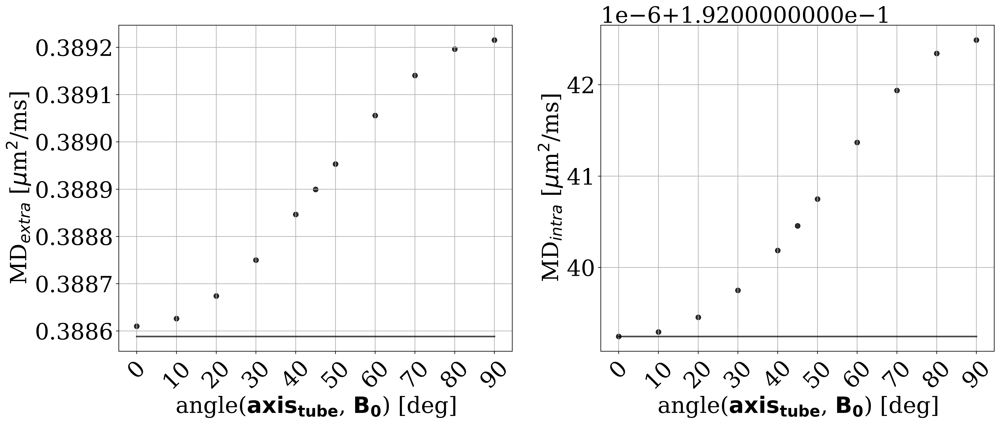

In [22]:
cmap = plt.cm.get_cmap('gnuplot2')   

scaler = 1e3

for name_substrate_master, d in tqdm(data.items()):
    
    fig, axs = plt.subplots(1, 2, figsize=(18, 8))
    
    print('\n', name_substrate_master)
    
    for path_config, _ in tqdm(d.items()):
        
#         if ('experiment' not in _) or (len(_['paths_Bfields']) == 0):
        if ('r_helix=0.0' not in path_config) or ('experiment' not in _) or (len(_['paths_Bfields']) == 0):
            continue
            
        r_helix = path_config.split('r_helix=')[-1].split('-')[0]
        
        if '-inner' in path_config:
            marker = 'o'
            ls = '-'
            idx_axs = 1
            axs[idx_axs].set_ylabel('MD$_{intra}$ [$\mu$m$^2$/ms]')
        elif '-outer' in path_config:
            marker = 'o'
            ls = '-'
            idx_axs = 0
            axs[idx_axs].set_ylabel('MD$_{extra}$ [$\mu$m$^2$/ms]')
            
        weight_color = float(path_config.split('r_helix=')[-1].split('-')[0]) / 4.
        color = cmap(weight_color)
            
        print('path_config: ', path_config)
        
        experiment = d[path_config]['experiment']
        
        for name_Bfield, _ in experiment.signals['net_contribution'].items():
            
            B_z_angle = int(np.round(np.rad2deg(float(name_Bfield.split('B_z_angle=')[-1].replace('.pt', '')))))
            
            DT_fit = experiment.signals['DT_fit'][name_Bfield]
            
            axs[idx_axs].scatter(B_z_angle, DT_fit.md[0][0][0]*scaler, 
                        marker=marker, color=color, alpha=0.8
                       )
            
        #### no field
        DT_fit = experiment.signals['DT_fit']['no_Bfield']
        
        axs[idx_axs].plot([0, 90], [DT_fit.md[0][0][0]*scaler, DT_fit.md[0][0][0]*scaler],
                 color=color, ls=ls, label=r'r$_{helix}$ = ' + f'{r_helix} $\mu$m',
                          lw=2, alpha=0.7
                )
        
    for ax in axs:
        #ax.set_ylim(-0.05, 1.05)
        ax.set_xticks(np.arange(0, 91, 10))
        ax.set_xticklabels(np.arange(0, 91, 10), rotation=45)
        ax.grid(True)
        ax.set_xlabel('angle($\mathbf{axis_{tube}}$, $\mathbf{B_0}$) [deg]')
    
    #axs[1].legend(fontsize=19, loc='lower center', ncol=2)
    #axs[0].legend(fontsize=19, loc='lower center', ncol=2)
    
    #axs[1].set_ylim(0.202-0.003, 0.202)
    #axs[0].set_ylim(0.3985, 0.4005)
    
fig.tight_layout()


# PLOT: PA

  0%|          | 0/1 [00:00<?, ?it/s]


 hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50

path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=0.00-n_tube_segments=45-length_circ_segments=0.08-outer.conf


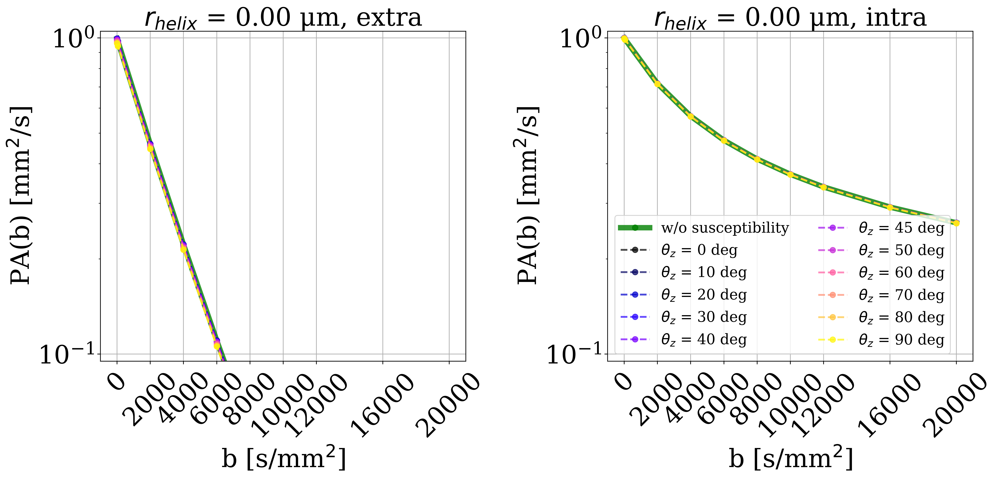


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=1.00-n_tube_segments=45-length_circ_segments=0.08-outer.conf


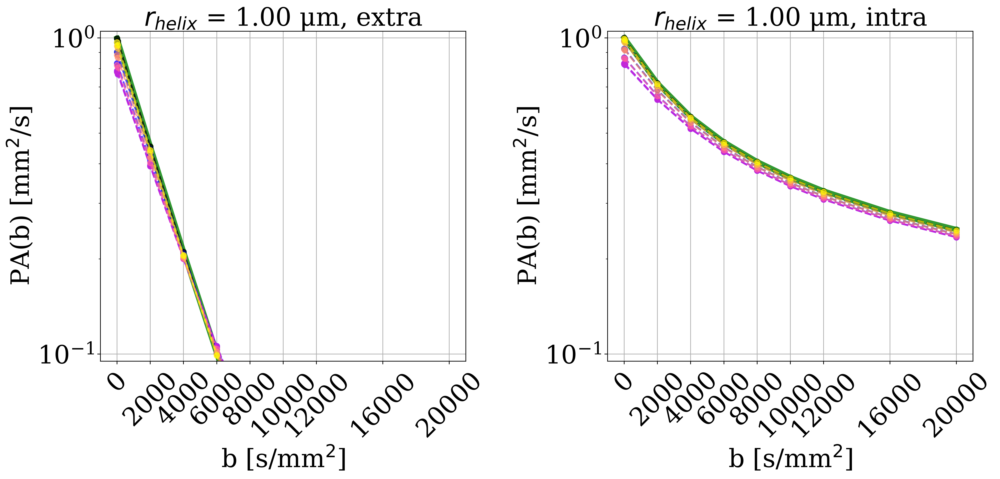


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=2.00-n_tube_segments=45-length_circ_segments=0.08-outer.conf


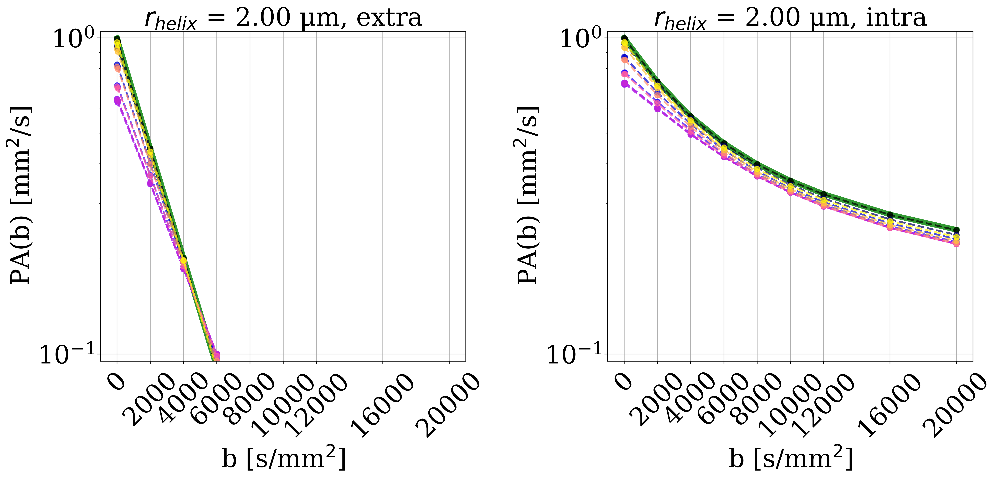


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=3.00-n_tube_segments=45-length_circ_segments=0.08-outer.conf


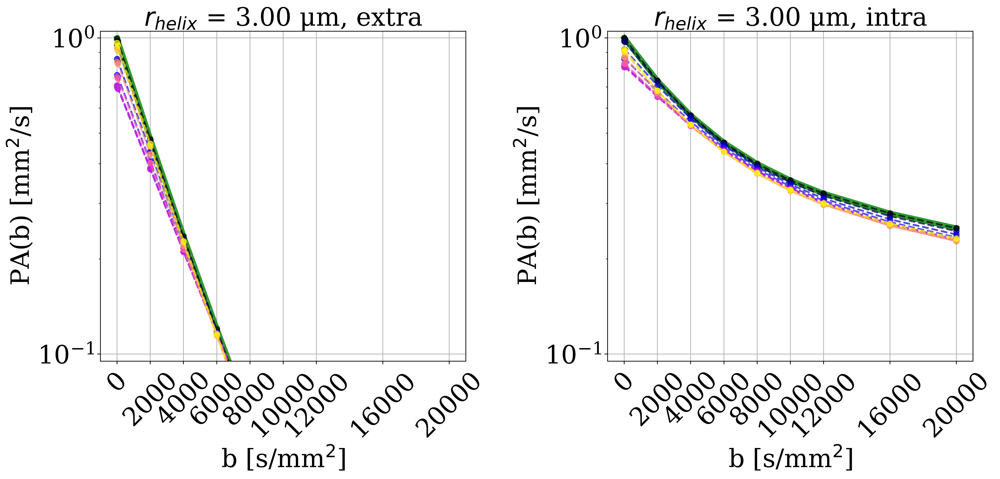

In [23]:
# cmap = plt.cm.get_cmap('viridis')
cmap = plt.cm.get_cmap('gnuplot2')

ms = 6

for name_substrate_master, d in tqdm(data.items()):
    
    print('\n', name_substrate_master)
    
    for path_config, _ in d.items():
        
        if ('-outer' not in path_config) or ('experiment' not in _) or (len(_['paths_Bfields']) == 0):
            continue
            
        print('\npath_config: ', path_config)
    
        experiment_outer = d[path_config]['experiment']
        experiment_inner = d[path_config.replace('-outer', '-inner')]['experiment']
        paths_Bfields = np.sort(d[path_config]['paths_Bfields'])
#         for path in paths_Bfields:
#             print(path)

        fig, axs = plt.subplots(1, 2, figsize=(16, 8))
        
    #     fig, ax = plt.subplots(1, 1, figsize=(14, 14))
    
        for idx_axs, experiment in enumerate([experiment_outer, experiment_inner]):

            #### MY
            PAs = []
            for b_value_oi in experiment.b_values_unique:
                #signals_oi_gc = experiment.signals['gradient_contribution'][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_my_gradient[b_values == b_values_unique[0]]
                signals_oi_gc = experiment.signals['gradient_contribution'][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] / experiment.N
                PAs.append(torch.mean(signals_oi_gc).to('cpu'))

            axs[idx_axs].plot(experiment.b_values_unique.to('cpu'), PAs, 
                    ls='-', lw=6,
                    marker='o', c='green', alpha=0.8, ms=ms, 
                              label='w/o susceptibility')

            for i, path_Bfield in enumerate(paths_Bfields):
                
                B_z_angle = np.rad2deg(float(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0]))
                
                # coloring
                weight_color = np.rad2deg(float(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0])) / 100.
                color = cmap(weight_color)

                #### SUSCEPTIBILITY

                PAs = []

                for b_value_oi in experiment.b_values_unique:
                    
                    #b0 = experiment.signals['susceptibility_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == 0]
                    b0 = experiment.signals['net_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == 0]

                    # signals
                    #signals_oi_sus = experiment.signals['susceptibility_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_my_susceptibility[b_values == b_values_unique[0]]
                    #signals_oi_sus = experiment.signals['net_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_my_susceptibility[b_values == b_values_unique[0]]
                    signals_oi_sus = torch.mean(experiment.signals['net_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] / experiment.N).to('cpu')
                    PAs.append(signals_oi_sus)
    #                 bs_sus = np.ones(np.shape(signals_oi_sus)) * b_value_oi.to('cpu').numpy()
                    # normalize
        #             signals_oi_sus = signals_oi_sus / b0
                    # plotting

                axs[idx_axs].plot(experiment.b_values_unique.to('cpu'), PAs, 
                        marker='o', 
                        ls='--', lw=2,
                        color=color, alpha=0.7, ms=ms, 
                        label=r'$\theta_z$ = '+f'{int(np.round(B_z_angle))} deg')

    # #             if b_value_oi == 0:
    # #                 print('signals_oi_sus: ', signals_oi_sus)

        for ax in axs:
            ax.set_ylabel('PA(b) [mm$^2$/s]')
            ax.set_xlabel('b [s/mm$^2$]')
            #ax.set_ylim(-0.05, 1.05)
            #ax.set_ylim(0.0015, 1.05)
            ax.set_ylim(0.095, 1.05)
            ax.grid(True)
            # xticks
            xticks = experiment.b_values_unique.cpu()[np.append(0, np.arange(2, len(experiment.b_values_unique.cpu())))]
            xtick_labels = np.round(xticks  * 1e-6 / 10) * 10 # round to nearest 10
            ax.set_xticks(xticks)
            ax.set_xticklabels(xtick_labels.numpy().astype(int), rotation=45)
            ax.set_yscale('log')
            
        if 'r_helix=0.0' in path_config:
            axs[1].legend(loc='lower left', fontsize=16, ncol=2)
            
        r_helix = path_config.split('r_helix=')[-1].split('-')[0]
        axs[0].set_title(r'$r_{helix}$ = ' + f'{r_helix} μm, extra')
        axs[1].set_title(r'$r_{helix}$ = ' + f'{r_helix} μm, intra')

        B_z_angles = [int(np.round(np.rad2deg(float(path_Bfield.split('B_z_angle=')[-1].split('.pt')[0])))) for path_Bfield in paths_Bfields]
        #axs[0].legend(['MCDC', 'gradient contribution'] + ['gradient contribution + susceptibility (%s)' %(tag.split('/')[-1]) for tag in paths_Bfields], bbox_to_anchor=(0., 1.02, 1., .102), loc='lower left', ncol=1, mode="expand", borderaxespad=0.)
#         ax.legend(#['MCDC', 'gradient contribution'] + \
#                   #['gradient contribution + susceptibility (%s)' %(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0]) for i, tag in enumerate(paths_Bfields)], 
#                   ['gradient contribution'] + \
#                   [r'gradient contribution + susceptibility: $\theta_z$ = '+f'{B_z_angle} deg' for B_z_angle in B_z_angles],
#                   bbox_to_anchor=(0., 1.02, 1., .102), loc='lower left', ncol=1, mode="expand", borderaxespad=0.,
#                   fontsize=24
#         )

        #xs[0].set_title(key.split('/')[-2:])

        

        #### add true S(b=0)
#         ax.scatter([0.0], [experiment.N], marker='o', facecolor='None', edgecolor='red', 
#                    s=80)

#         ax.set_title(path_config.split('/')[-1], fontsize=13, pad=260)
        plt.tight_layout()
        plt.show()

#         break

# SCATTER

  0%|          | 0/1 [00:00<?, ?it/s]


 hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50

path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=0.00-n_tube_segments=45-length_circ_segments=0.08-outer.conf


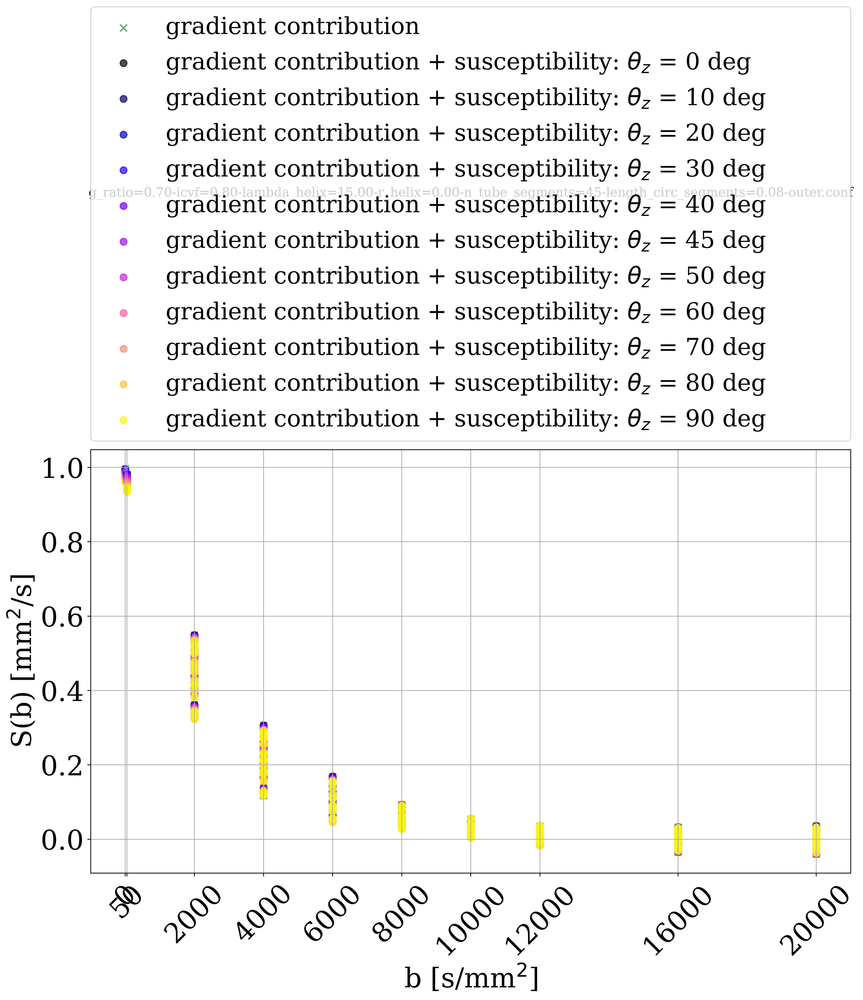


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=0.00-n_tube_segments=45-length_circ_segments=0.08-inner.conf


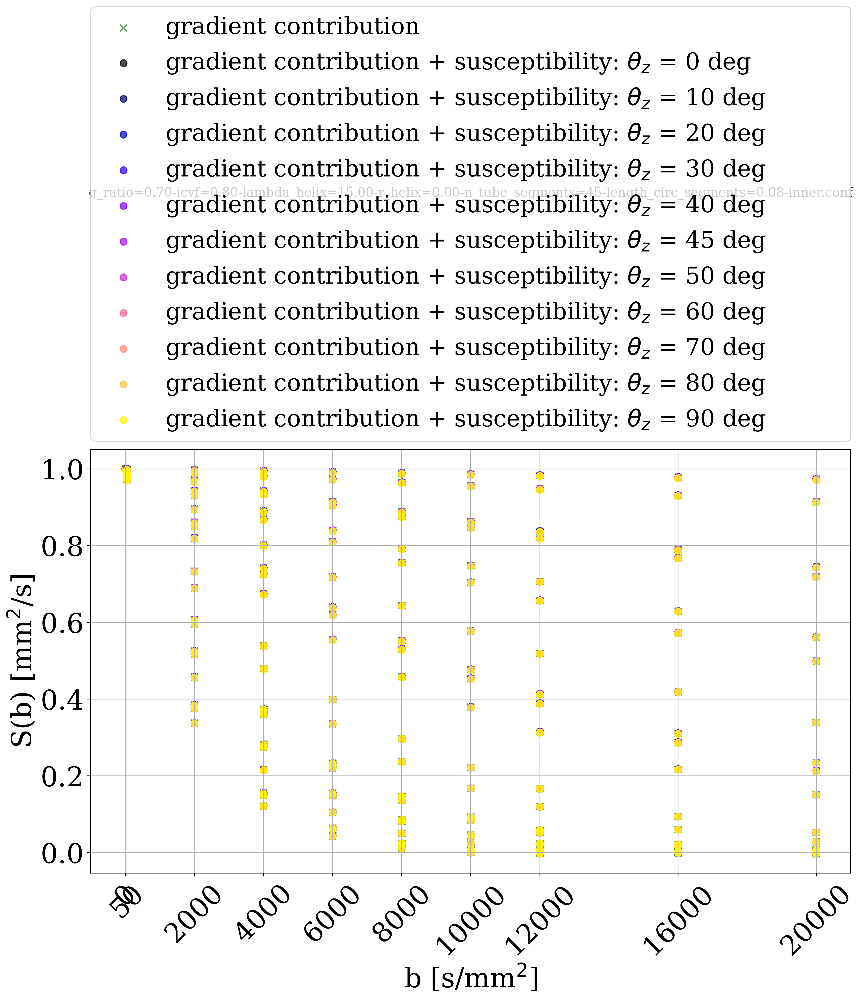


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=1.00-n_tube_segments=45-length_circ_segments=0.08-outer.conf


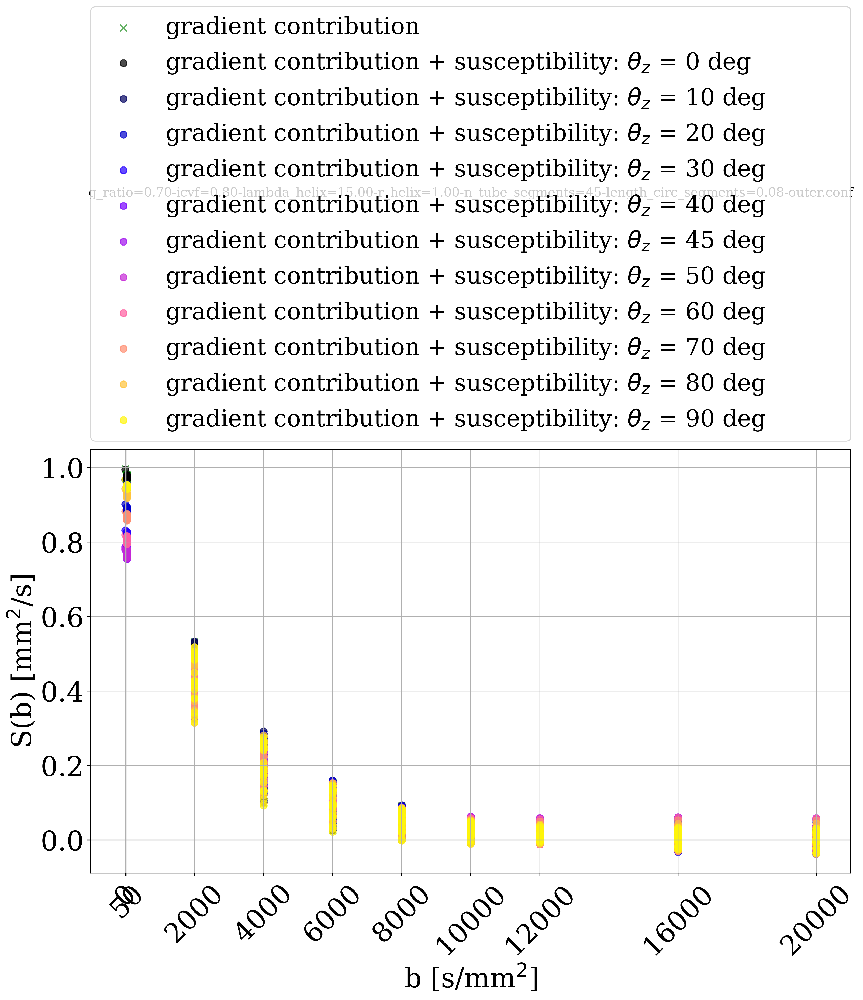


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=1.00-n_tube_segments=45-length_circ_segments=0.08-inner.conf


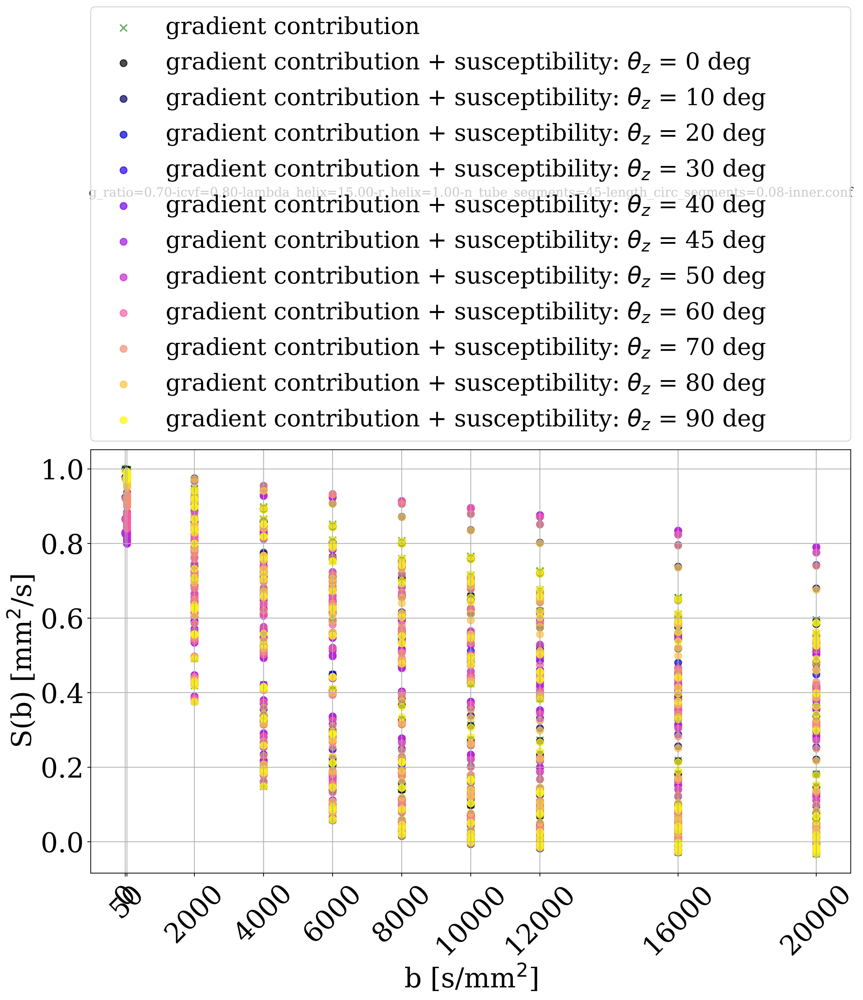


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=2.00-n_tube_segments=45-length_circ_segments=0.08-outer.conf


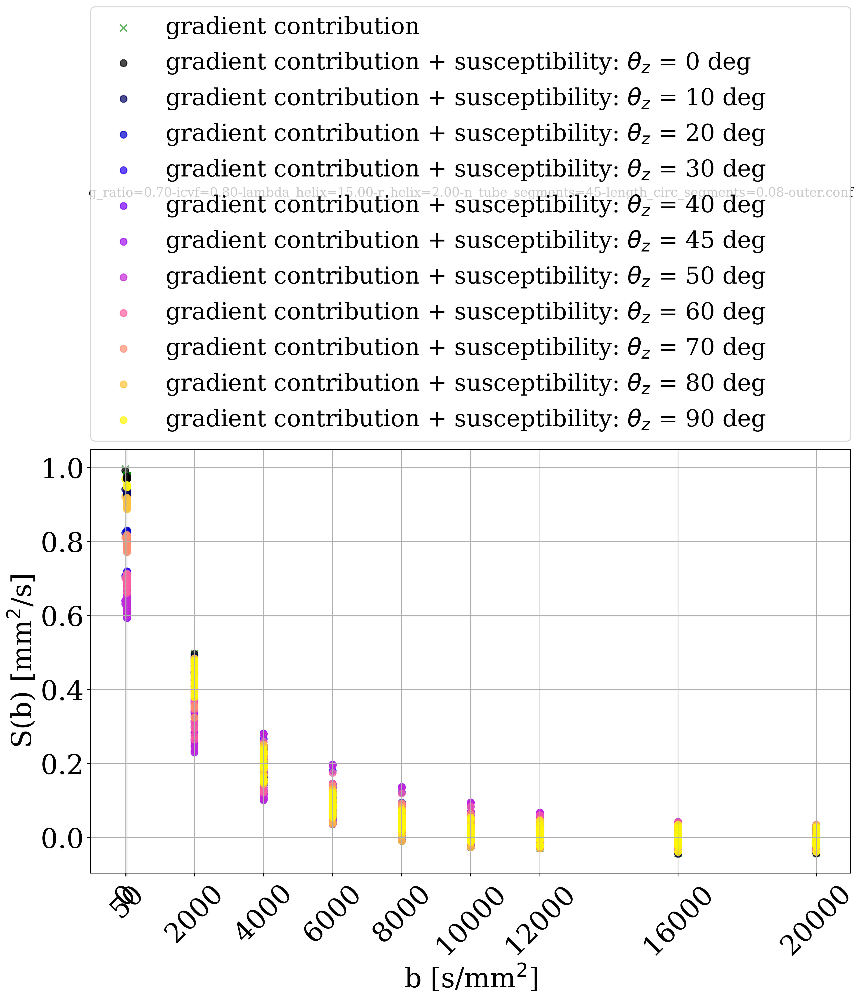


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=2.00-n_tube_segments=45-length_circ_segments=0.08-inner.conf


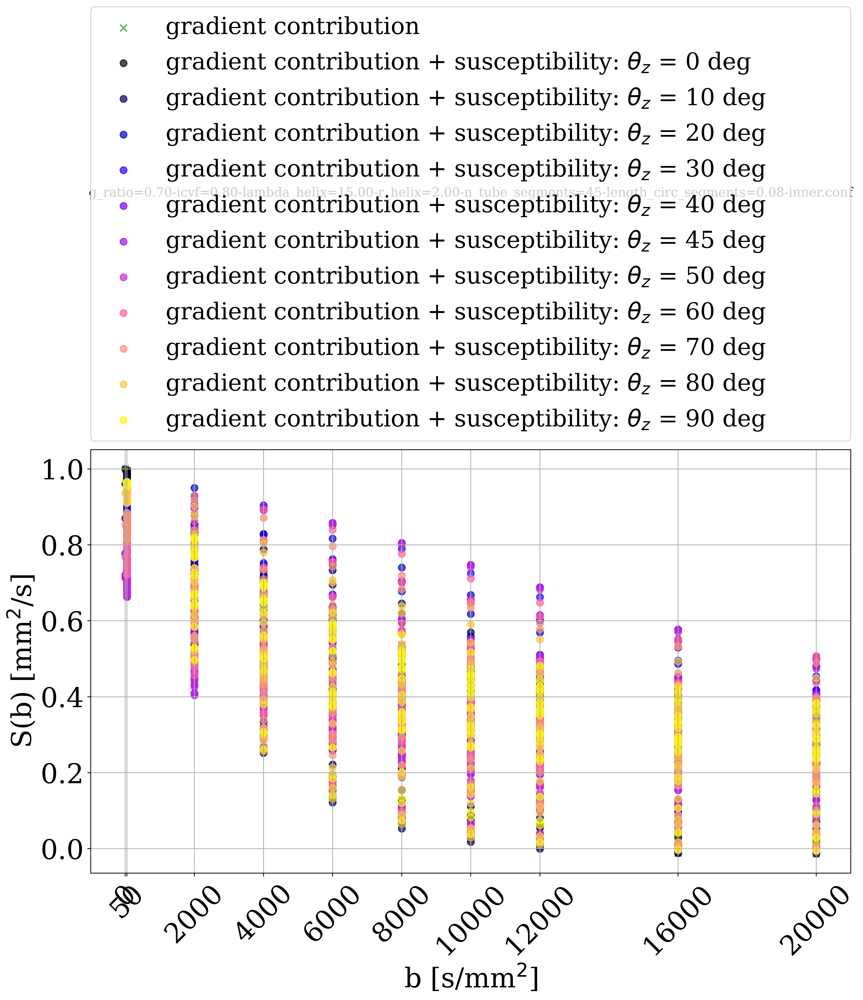


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=3.00-n_tube_segments=45-length_circ_segments=0.08-outer.conf


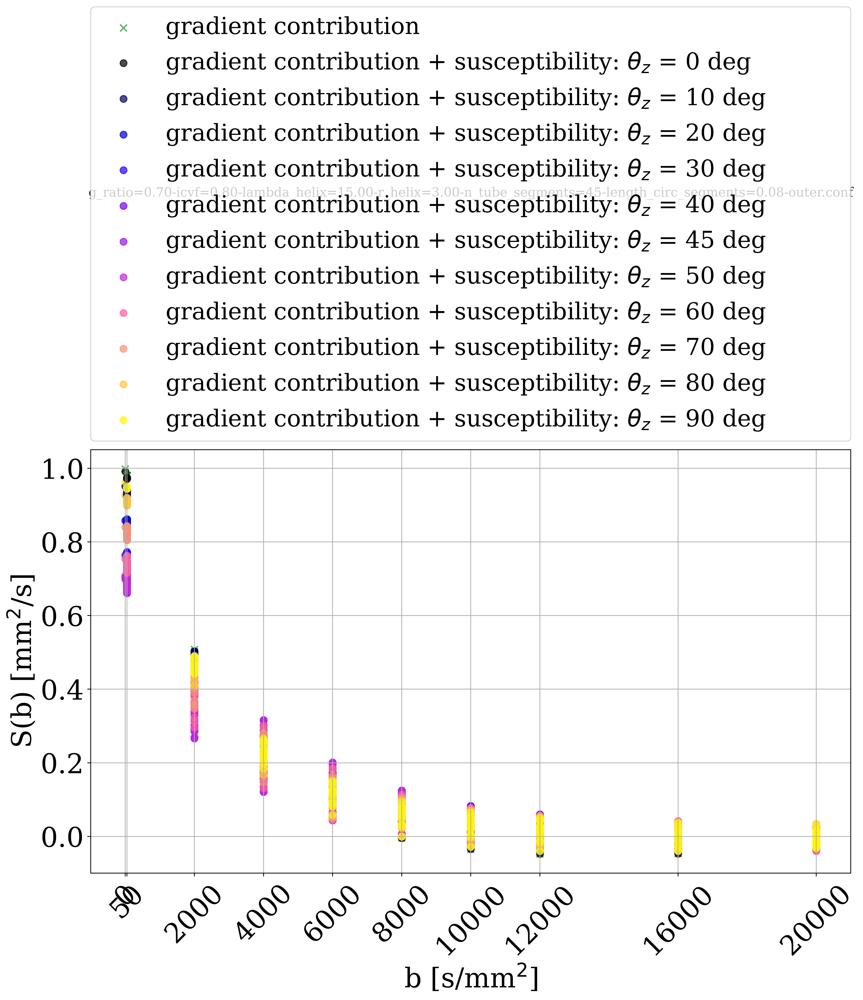


path_config:  /scratch/siwin/projects/susceptibility_in_silico/data/MCDC/microdispersion/hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=3.00-n_tube_segments=45-length_circ_segments=0.08-inner.conf


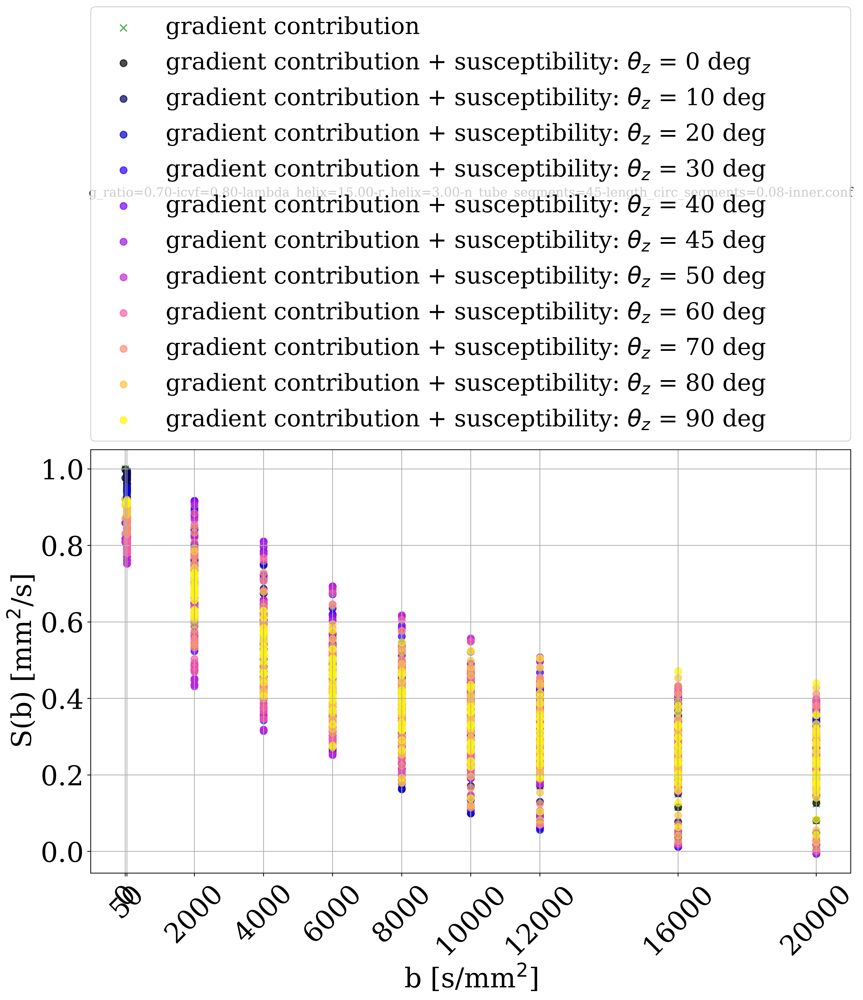

In [24]:
# cmap = plt.cm.get_cmap('viridis')
cmap = plt.cm.get_cmap('gnuplot2')

for name_substrate_master, d in tqdm(data.items()):
    
    print('\n', name_substrate_master)
    
    for path_config, _ in d.items():
        
        if ('experiment' not in _) or (len(_['paths_Bfields']) == 0):
            continue
            
        print('\npath_config: ', path_config)
    
        experiment = d[path_config]['experiment']
        paths_Bfields = np.sort(d[path_config]['paths_Bfields'])
#         for path in paths_Bfields:
#             print(path)

        fig, ax = plt.subplots(1, 1, figsize=(14, 8))
    #     fig, ax = plt.subplots(1, 1, figsize=(14, 14))

        for b_value_oi in experiment.b_values_unique:

            #### MCDC
#             signals_oi_MCDC = experiment.signals_MCDC[experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_MCDC[b_values == b_values_unique[0]]
#     #         # normalize
#     #         signals_oi_MCDC = signals_oi_MCDC / signals_oi_MCDC[0]
#             bs_MCDC = np.ones(np.shape(signals_oi_MCDC)) * b_value_oi.to('cpu').numpy()
#             ax.scatter(bs_MCDC, signals_oi_MCDC, marker='x', c='black', alpha=0.7, s=85, label='MCDC')
#             #ax.scatter(bs_MCDC[:1], [np.mean(signals_oi_MCDC)], marker='x', c='red', alpha=0.7, s=85, label='MCDC')

            #### MY
            #signals_oi_gc = experiment.signals['gradient_contribution'][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_my_gradient[b_values == b_values_unique[0]]
            signals_oi_gc = experiment.signals['gradient_contribution'][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] / experiment.N
            bs_gc = np.ones(np.shape(signals_oi_gc)) * b_value_oi.to('cpu').numpy()
            ax.scatter(bs_gc, signals_oi_gc.to('cpu').numpy(), marker='x', c='green', alpha=0.6, s=50, label='gradient contribution')

            #### SUSCEPTIBILITY
            for i, path_Bfield in enumerate(paths_Bfields):

                #b0 = experiment.signals['susceptibility_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == 0]
                b0 = experiment.signals['net_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == 0]

                # coloring
                weight_color = np.rad2deg(float(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0])) / 100.
                color = cmap(weight_color)
#                 color = 'black'
                # signals
                #signals_oi_sus = experiment.signals['susceptibility_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_my_susceptibility[b_values == b_values_unique[0]]
                #signals_oi_sus = experiment.signals['net_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_my_susceptibility[b_values == b_values_unique[0]]
                signals_oi_sus = experiment.signals['net_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] / experiment.N
                bs_sus = np.ones(np.shape(signals_oi_sus)) * b_value_oi.to('cpu').numpy()
                # normalize
    #             signals_oi_sus = signals_oi_sus / b0
                # plotting
                ax.scatter(bs_sus, signals_oi_sus.to('cpu').numpy(), marker='o', 
                               color=color, alpha=0.7, s=50, 
                               label='gradient contribution + susceptibility')

# #             if b_value_oi == 0:
# #                 print('signals_oi_sus: ', signals_oi_sus)

        ax.set_ylabel('S(b) [mm$^2$/s]')
        ax.set_xlabel('b [s/mm$^2$]')

        ax.grid(True)

        B_z_angles = [int(np.round(np.rad2deg(float(path_Bfield.split('B_z_angle=')[-1].split('.pt')[0])))) for path_Bfield in paths_Bfields]
        #axs[0].legend(['MCDC', 'gradient contribution'] + ['gradient contribution + susceptibility (%s)' %(tag.split('/')[-1]) for tag in paths_Bfields], bbox_to_anchor=(0., 1.02, 1., .102), loc='lower left', ncol=1, mode="expand", borderaxespad=0.)
        ax.legend(#['MCDC', 'gradient contribution'] + \
                  #['gradient contribution + susceptibility (%s)' %(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0]) for i, tag in enumerate(paths_Bfields)], 
                  ['gradient contribution'] + \
                  [r'gradient contribution + susceptibility: $\theta_z$ = '+f'{B_z_angle} deg' for B_z_angle in B_z_angles],
                  bbox_to_anchor=(0., 1.02, 1., .102), loc='lower left', ncol=1, mode="expand", borderaxespad=0.,
                  fontsize=24
        )

        #xs[0].set_title(key.split('/')[-2:])

        # xticks
        xticks = experiment.b_values_unique.cpu()
        xtick_labels = np.round(xticks  * 1e-6 / 10) * 10 # round to nearest 10
        ax.set_xticks(xticks)
        ax.set_xticklabels(xtick_labels.numpy().astype(int), rotation=45)

        #### add true S(b=0)
#         ax.scatter([0.0], [experiment.N], marker='o', facecolor='None', edgecolor='red', 
#                    s=80)

        #ax.set_yscale('log')

        ax.set_title(path_config.split('/')[-1], fontsize=13, pad=260)
        plt.show()

#         break

# HISTOGRAM: ANGLE(TUBE, B)

In [25]:
import pytorch3d.io

In [26]:
def get_angles_between_vectors(vecs, vec, symmetry_around_90=False):

    dot = np.sum(vecs*vec, axis=-1)

    radians = np.arccos(dot / (np.linalg.norm(vecs, axis=-1) * np.linalg.norm(vec)))

    angles = radians * 180. / np.pi

    if symmetry_around_90:
        angles[angles > 90.] = 180. - angles[angles > 90.]

    return angles

In [27]:
# angles_oi = np.linspace(0, 180, 10)
# angles_oi = np.linspace(0, 180, 21)
angles_oi = np.arange(0, 180+1, 5)
angles_oi

array([  0,   5,  10,  15,  20,  25,  30,  35,  40,  45,  50,  55,  60,
        65,  70,  75,  80,  85,  90,  95, 100, 105, 110, 115, 120, 125,
       130, 135, 140, 145, 150, 155, 160, 165, 170, 175, 180])

In [28]:
# bins = np.arange(-5, 180+10, 10)
bins = np.arange(-2.5, 180+5, 5)
bins

array([ -2.5,   2.5,   7.5,  12.5,  17.5,  22.5,  27.5,  32.5,  37.5,
        42.5,  47.5,  52.5,  57.5,  62.5,  67.5,  72.5,  77.5,  82.5,
        87.5,  92.5,  97.5, 102.5, 107.5, 112.5, 117.5, 122.5, 127.5,
       132.5, 137.5, 142.5, 147.5, 152.5, 157.5, 162.5, 167.5, 172.5,
       177.5, 182.5])

In [29]:
bin_centers = bins[1:] - (bins[1] - bins[0]) / 2
bin_centers

array([  0.,   5.,  10.,  15.,  20.,  25.,  30.,  35.,  40.,  45.,  50.,
        55.,  60.,  65.,  70.,  75.,  80.,  85.,  90.,  95., 100., 105.,
       110., 115., 120., 125., 130., 135., 140., 145., 150., 155., 160.,
       165., 170., 175., 180.])

  0%|          | 0/1 [00:00<?, ?it/s]


 hexagonal_helix_undulated-n_trims=2-r_tube_outer=0.50


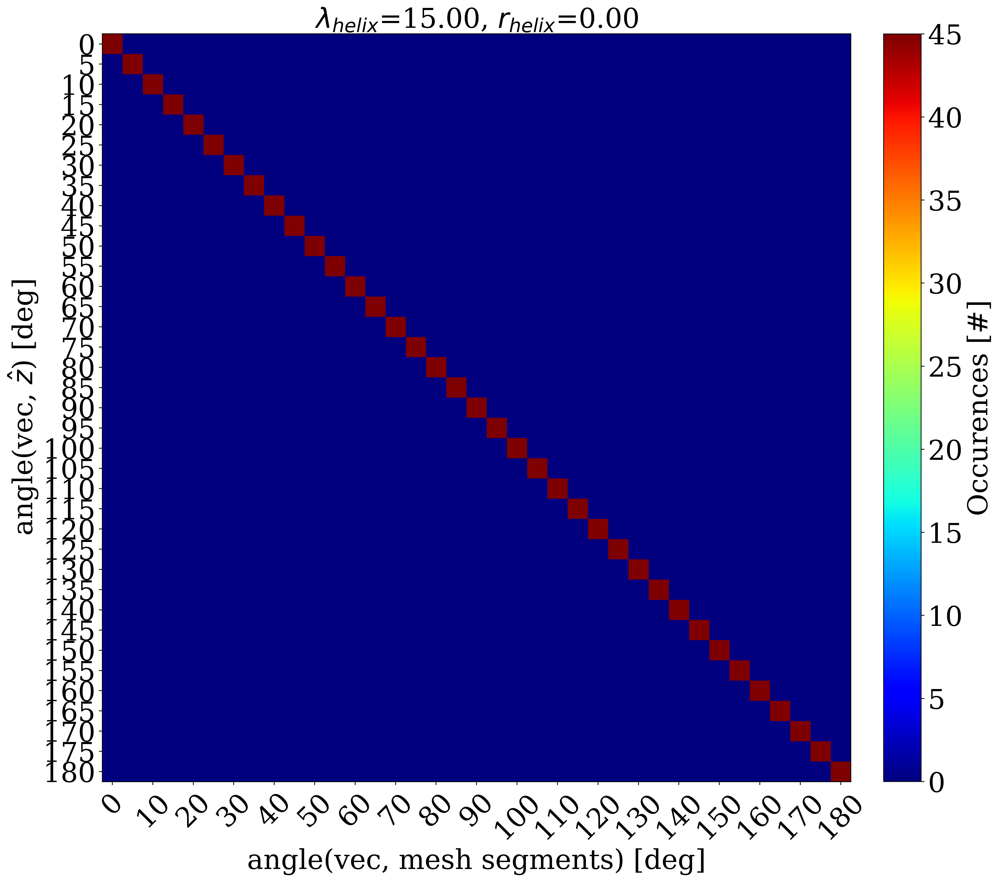

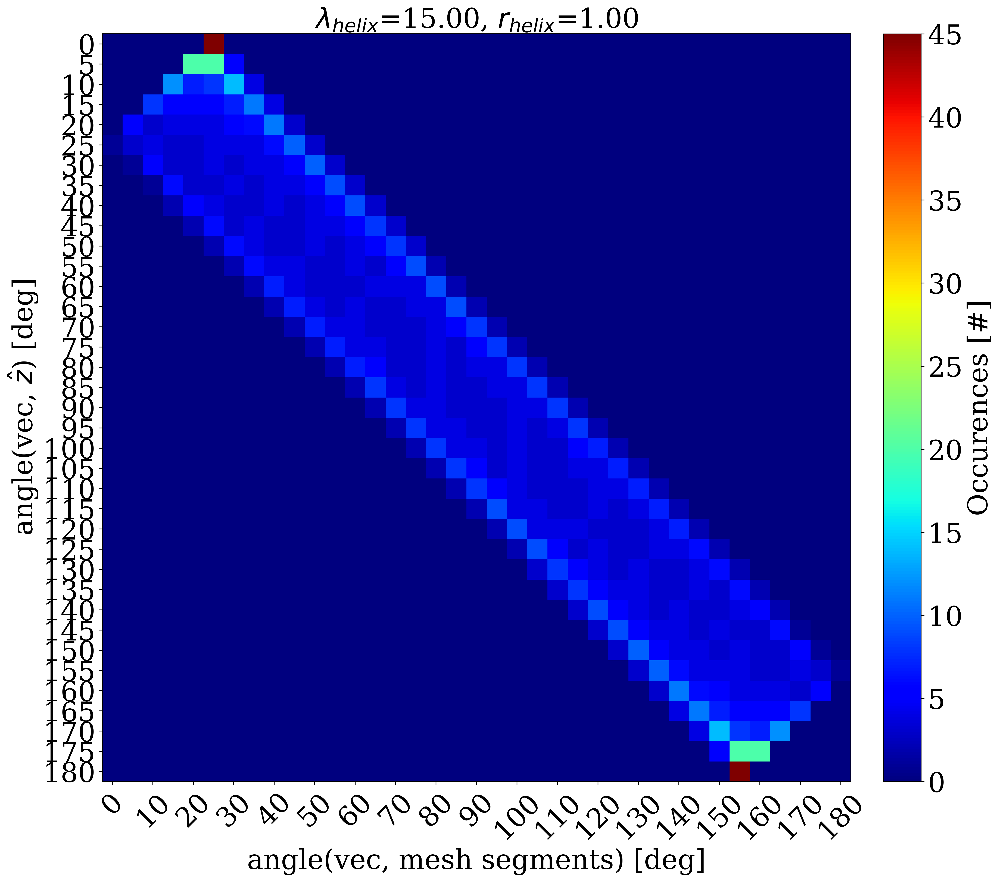

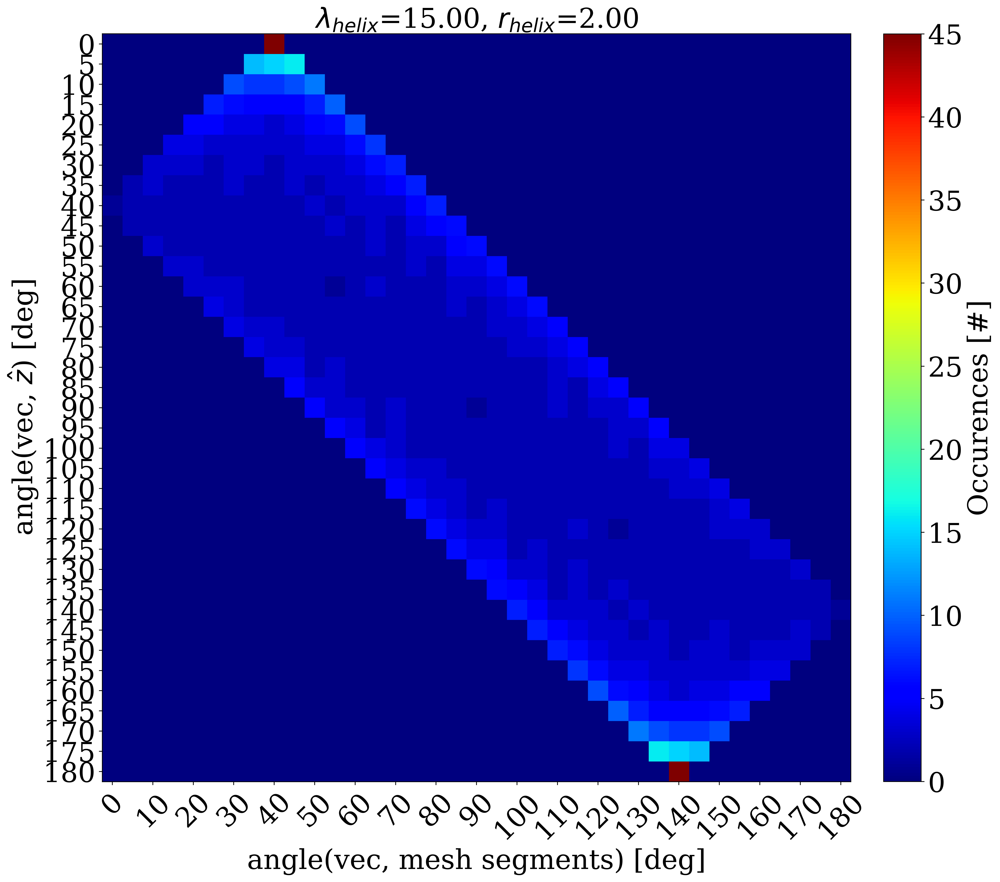

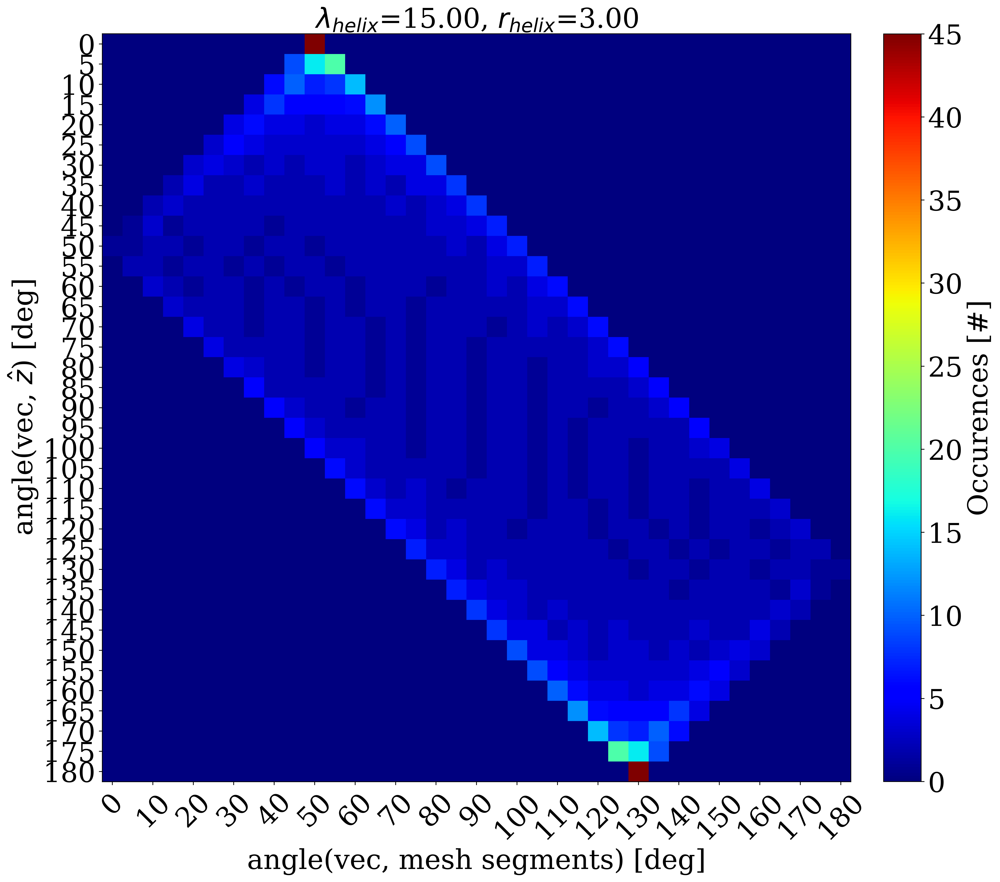

In [30]:
for name_substrate_master, d in tqdm(data.items()):
    
    print('\n', name_substrate_master)
    
    for path_config, _ in d.items():
        
        if ('experiment' not in _) or (len(_['paths_Bfields']) == 0):
            continue
            
        experiment = d[path_config]['experiment']
        
        if '-outer' not in experiment.path_ply:
            continue
            
        lambda_helix = experiment.path_ply.split('lambda_helix=')[-1].split('-')[0]
        r_helix = experiment.path_ply.split('r_helix=')[-1].split('-')[0]

        verts, faces = pytorch3d.io.load_ply(experiment.path_ply)

        length_circ_segments = float(experiment.path_ply.split('length_circ_segments=')[-1].split('-')[0])
        n_tube_segments = int(experiment.path_ply.split('n_tube_segments=')[-1].split('-')[0])
        r_tube_outer = float(experiment.path_ply.split('r_tube_outer=')[-1].split('/')[0])
        n_circ_points_outer = np.ceil(2*np.pi*r_tube_outer / length_circ_segments).astype(int)

        #### pick verts corresponding to one tube. discard the patching.
        # pick a line
        #verts_oi = verts[::n_circ_points_outer, :][1:n_tube_segments+3-1, :]
        # be on the safe side and take the mean of each ring and use that.
        verts_oi = verts[n_circ_points_outer:n_circ_points_outer*(n_tube_segments+3-1), :]
        verts_oi = verts_oi.reshape((n_tube_segments+1, n_circ_points_outer, 3))
        verts_oi = torch.mean(verts_oi, dim=1)
        
        vecs_oi = np.diff(verts_oi.numpy(), axis=0)
        
        ns = []
        
        for angle_oi in angles_oi:
            
            z_comp = np.cos(np.deg2rad(angle_oi))
            x_comp = np.sin(np.deg2rad(angle_oi))
            
            vec_oi = torch.Tensor([x_comp, 0., z_comp])
        
            angles = get_angles_between_vectors(vecs_oi, vec_oi.numpy(), 
                                                #symmetry_around_90=True,
                                                symmetry_around_90=False,
                                               )

            n, bins, _ = plt.hist(angles, bins=bins, histtype='step')
            plt.close('all')
            ns.append(n)
    
        ns = np.array(ns)
        
        plt.figure(figsize=(15, 15))
        im = plt.imshow(ns, cmap='jet')
        plt.xticks(np.arange(len(bin_centers))[::2], bin_centers.astype(int)[::2],
                   rotation=45)
        #plt.yticks(np.arange(len(angles_oi))[::2], angles_oi.astype(int)[::2])
        plt.yticks(np.arange(len(angles_oi)), angles_oi.astype(int))
        plt.xlabel('angle(vec, mesh segments) [deg]')
        plt.ylabel('angle(vec, $\hat{z}$) [deg]')
        plt.title(r'$\lambda_{helix}$=' + f'{lambda_helix}, ' + r'$r_{helix}$'+f'={r_helix}')
        #cbar = plt.colorbar(im, fraction=0.0247, pad=0.04)
        cbar = plt.colorbar(im, fraction=0.0457, pad=0.04)
        cbar.set_label('Occurences [#]')
        plt.show()
        
        #break

In [41]:
for i, path_Bfield in enumerate(paths_Bfields):
    
    print('path_Bfield', path_Bfield)
    
#     signals_oi_MCDC = experiment.signals_MCDC[experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_MCDC[b_values == b_values_unique[0]]
            
    b0 = experiment.signals['susceptibility_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == 0]

    # coloring
    weight_color = float(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0]) / (np.pi/2)
    color = cmap(weight_color)
    # signals
    signals_oi_sus = experiment.signals['susceptibility_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_my_susceptibility[b_values == b_values_unique[0]]
    bs_sus = np.ones(np.shape(signals_oi_sus)) * b_value_oi.to('cpu').numpy()
    # normalize
#             signals_oi_sus = signals_oi_sus / b0
    # plotting
#     ax.scatter(bs_sus, signals_oi_sus.to('cpu').numpy(), marker='o', 
#                    color=color, alpha=0.7, s=50, 
#                    label='gradient contribution + susceptibility')
    print(signals_oi_MCDC)
    print(signals_oi_sus.to('cpu').numpy())

path_Bfield /scratch/siwin/projects/susceptibility_in_silico/substrates/hexagonal_helix_undulated_higher_res-r_tube_outer=0.50/Bfields/g_ratio=0.70-icvf=0.80-lambda_helix=15.00-r_helix=1.00-n_tube_segments=40-length_circ_segments=0.10-res_desired=0.01-res_actual_x=0.0122381389194910-res_actual_y=0.0122128862296826-res_actual_z=0.0121951219512195-B_x_angle=0.00-B_z_angle=0.00.pt


NameError: name 'signals_oi_MCDC' is not defined

In [16]:
import scipy.linalg

def M(axis_rotation, theta):
    return -scipy.linalg.expm(np.cross(np.eye(3), axis_rotation/scipy.linalg.norm(axis_rotation)*theta))

v, axis_rotation, theta = [1, 0, 0], [0, 1, 0], np.pi/2
M0 = M(axis_rotation, theta)

np.dot(M0,v)

array([0., 0., 1.])

dir_fiber [1, 0, 0]
dir_b [1, 0, 0]
bvecs_oi[idx_min_angle] [-0.984414 -0.077222  0.158003]
hello
[[-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]
 [-0.984414 -0.077222  0.158003]]
signals_oi[:idx_max_oi] [1.         0.80414667 0.6140509  0.47011108 0.36064785 0.12684012]
signals_oi[:idx_max_oi] [1.         0.80587155 0.61674036 0.47305541 0.36346844 0.12832403]
signals_oi[:idx_max_oi] [1.         0.81438212 0.63187126 0.49151245 0.38312623 0.14435857]
signals_oi[:idx_max_oi] [1.         0.81978773 0.64171575 0.50360288 0.39599895 0.1544979 ]
dir_fiber [1, 0, 0]
dir_b [0, 1, 0]
bvecs_oi[idx_min_angle] [ 0.103765 

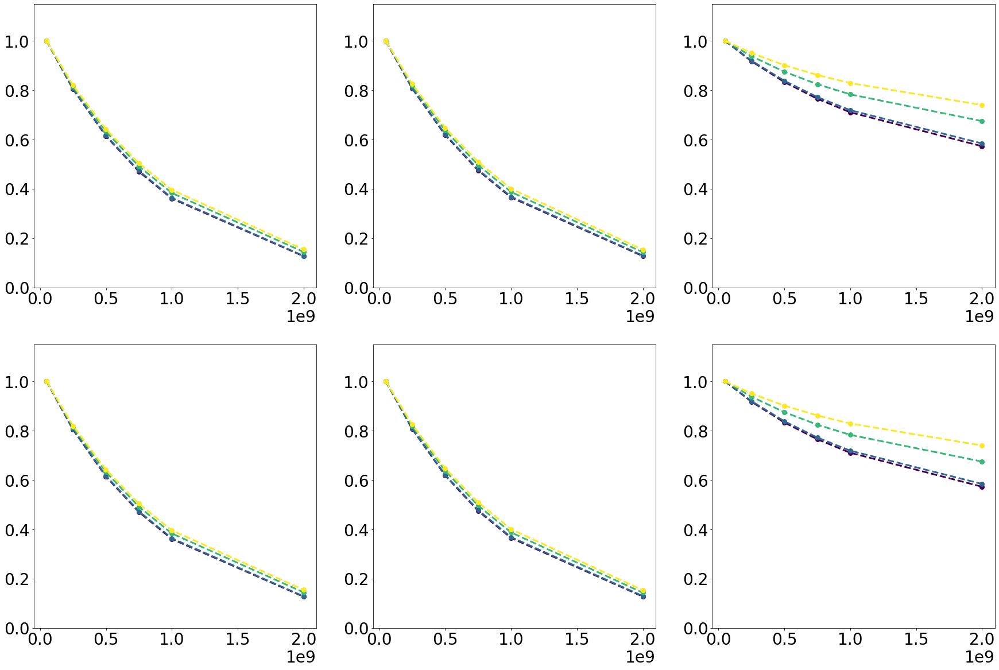

In [17]:
def plot_for_individual_bvecs(dirs_bs, dirs_fibers):
    
    idx_max_oi = 6
        
    fig, axs = plt.subplots(2, 3, figsize=(30, 20))
    
    # to cpu
    bvecs_oi = experiment.b_vectors.to('cpu').numpy()[1:] # discard [0, 0, 0]
    bvals = experiment.b_values_unique.to('cpu').numpy()[1:]
    
    for i_f, dir_fiber in enumerate(dirs_fibers):
        
        for i_b, dir_b in enumerate(dirs_bs):
            
            print('dir_fiber', dir_fiber)
            print('dir_b', dir_b)
            
            idx_min_angle = np.argmin(get_angles_between_vectors(bvecs_oi, dir_b, symmetry_around_90=True))

            print('bvecs_oi[idx_min_angle]', bvecs_oi[idx_min_angle])
            #print('here', np.argwhere(bvecs_oi == bvecs_oi[idx_min_angle]))
    
            idxs_signals_oi = np.argwhere(bvecs_oi == bvecs_oi[idx_min_angle])[:, 0][::3]
        
            print('hello')
            print(bvecs_oi[idxs_signals_oi, :])

            for i, path_Bfield in enumerate(paths_Bfields):

                # color
                deg = float(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0])
                weight_color = deg / (np.pi/2)
                color = cmap(weight_color)

                signals_oi = experiment.signals['susceptibility_contribution'][path_Bfield][idxs_signals_oi].to('cpu').numpy()
                
                #### normalize
                #signals_oi = signals_oi / experiment.N
                signals_oi = signals_oi / signals_oi[0]
                #print('HEREEEEEEE', signals_oi)
                ####
                
                #print('bvals[:idx_max_oi]', bvals[:idx_max_oi])
                print('signals_oi[:idx_max_oi]', signals_oi[:idx_max_oi])

                axs[i_f, i_b].plot(bvals[:idx_max_oi], signals_oi[:idx_max_oi], 
                                 c=color, marker='o', ls='--', lw=3, markeredgewidth=3,
                                 label=r'$\theta$ ='+f'{np.round(np.degrees(deg)).astype(int)} deg'
                                )
            
    for ax in np.ravel(axs):
        ax.set_ylim(0, 1.15)
    
plot_for_individual_bvecs([[1, 0, 0], [0, 1, 0], [0, 0, 1]],
                          [[1, 0, 0], [0, 1, 0]]
                         )

dir_b_x:  [0. 0. 1.]
[0.141982 0.181087 0.973164]
[9768.48790564 8961.10635795 8135.7063976  7473.01634629 6937.49113964
 5594.12307875 4890.87071455 4438.24693101]
[9463.5316296  8703.93769882 7928.71245291 7305.80825366 6801.36439182
 5525.52352912 4845.97893347 4403.62410536]
[7663.42866599 7185.22549003 6702.94828782 6315.23271918 5999.13466292
 5169.37358552 4674.78954382 4307.77913652]
[6721.62790611 6389.33833436 6057.57124684 5790.29684001 5570.67658916
 4971.66402628 4575.95680597 4251.13468372]
dir_b_x:  [0. 1. 0.]
[ 0.103765 -0.980428  0.167311]
[9468.76728906 7638.31942474 5854.79037993 4496.43344223 3456.79809695
 1206.66345154  416.38258941  148.00041132]
[9181.05473792 7422.44022961 5701.54115432 4388.30099673 3381.43296459
 1188.14363899  402.22193852  128.12122765]
[7441.07252731 6088.70731876 4739.15781877 3693.99497513 2882.25858067
 1063.97935114  375.29566738  118.82627667]
[6523.3752461  5378.89848484 4223.7854961  3320.37128263 2612.58890448
  998.98120965  367.8

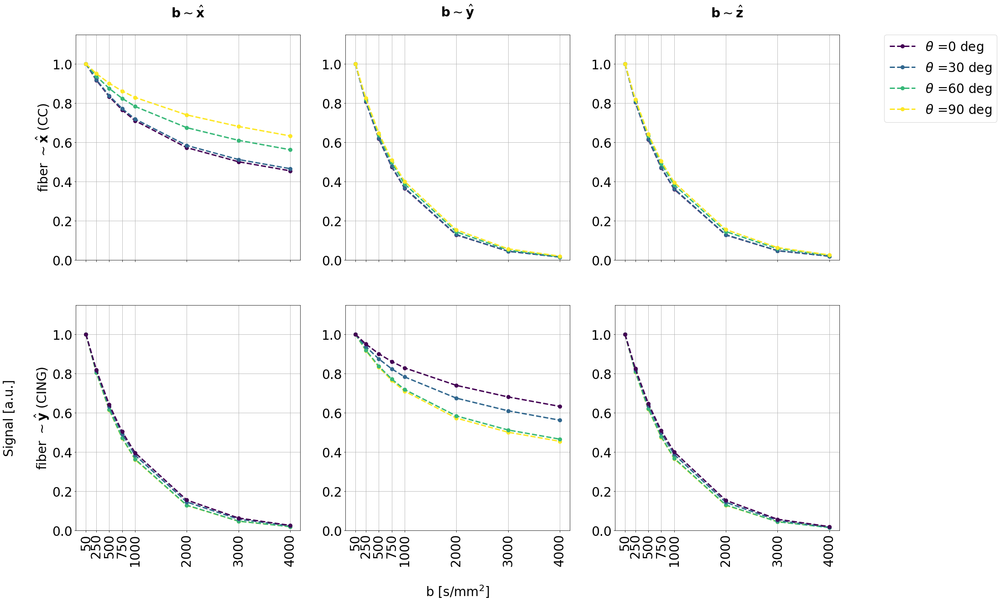

In [18]:
def plot_for_individual_bvecs(dirs_bs):
    
    idx_max_oi = 8

    #fig, axs = plt.subplots(2, 3, figsize=(23, 17))
    fig, axs = plt.subplots(2, 3, figsize=(30, 20))

    # to cpu
    bvecs_oi = experiment.b_vectors.to('cpu').numpy()[1:] # discard [0, 0, 0]
    bvals = experiment.b_values_unique.to('cpu').numpy()[1:]
    
    for i_b, dir_b in enumerate(dirs_bs):

        #### as if fiber ~ x
        #bvecs_oi_x = np.dot(M(axis_rotation=[0, 1, 0], theta=np.pi/2), bvecs_oi.T).T
        dir_b_x = np.abs(np.dot(M(axis_rotation=[0, 1, 0], theta=np.pi/2), dir_b).T)
        print('dir_b_x: ', dir_b_x)

        idx_min_angle = np.argmin(get_angles_between_vectors(bvecs_oi, dir_b_x, symmetry_around_90=True))
#         print(idx_min_angle)
#         print(get_angles_between_vectors(bvecs_oi, dir_b_x, symmetry_around_90=True))
#         print(bvecs_oi)
        print(bvecs_oi[idx_min_angle])

        idxs_signals_oi = np.argwhere(bvecs_oi == bvecs_oi[idx_min_angle])[:, 0][::3]
#         print('idxs_signals_oi: ', idxs_signals_oi)

        for i, path_Bfield in enumerate(paths_Bfields):

            # color
            deg = float(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0])
            weight_color = deg / (np.pi/2)
            color = cmap(weight_color)

            signals_oi = experiment.signals['susceptibility_contribution'][path_Bfield][idxs_signals_oi].to('cpu').numpy()
            print(signals_oi[:idx_max_oi])
            
            #### normalize
            #signals_oi = signals_oi / experiment.N
            signals_oi = signals_oi / signals_oi[0]
            #print('HEREEEEEEE', signals_oi)
            ####

            axs[0, i_b].plot(bvals[:idx_max_oi], signals_oi[:idx_max_oi], 
                             c=color, marker='o', ls='--', lw=3, markeredgewidth=3,
                             label=r'$\theta$ ='+f'{np.round(np.degrees(deg)).astype(int)} deg'
                            )

        #### as if fiber ~ y
        #bvecs_oi_y = np.dot(M(axis_rotation=[1, 0, 0], theta=np.pi/2), bvecs_oi.T).T
        dir_b_y = np.abs(np.dot(M(axis_rotation=[1, 0, 0], theta=np.pi/2), dir_b).T)

        idx_min_angle = np.argmin(get_angles_between_vectors(bvecs_oi, dir_b_y, symmetry_around_90=True))

        idxs_signals_oi = np.argwhere(bvecs_oi == bvecs_oi[idx_min_angle])[:, 0][::3]

        for i, path_Bfield in enumerate(paths_Bfields):

            # color
            weight_color = (np.abs(np.pi/2 - float(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0])) / (np.pi/2))
            color = cmap(weight_color)

            signals_oi = experiment.signals['susceptibility_contribution'][path_Bfield][idxs_signals_oi].to('cpu').numpy()
            #print(signals_oi)
            
            #### normalize
            #signals_oi = signals_oi / experiment.N
            signals_oi = signals_oi / signals_oi[0]
            #print('HEREEEEEEE', signals_oi)
            ####

            axs[1, i_b].plot(bvals[:idx_max_oi], signals_oi[:idx_max_oi], c=color, marker='o', ls='--', lw=3, markeredgewidth=3)

        #### fiber ~ z
        
        #
        
        for ax in np.ravel(axs):
            ax.set_ylim(0, 1.15)
            ax.grid(True)
        #     ax.set_yscale('log')
        
        if dir_b == [1, 0, 0]:
            axs[0, i_b].set_title('$\mathbf{b} \sim \hat{\mathbf{x}}$\n')
        if dir_b == [0, 1, 0]:
            axs[0, i_b].set_title('$\mathbf{b} \sim \hat{\mathbf{y}}$\n')
        if dir_b == [0, 0, 1]:
            axs[0, i_b].set_title('$\mathbf{b} \sim \hat{\mathbf{z}}$\n')
        if (i_b == 1):
            axs[1, i_b].set_xlabel('\nb [s/mm$^2$]')
        if i_b == 0:
            axs[0, i_b].set_ylabel('fiber $\sim \hat{\mathbf{x}}$ (CC)')
            axs[1, i_b].set_ylabel('Signal [a.u.]\n\nfiber $\sim \hat{\mathbf{y}}$ (CING)')
            #axs[2, i_b].set_ylabel('fiber $\sim \hat{\mathbf{z}}$ (IC)')
#         if i_b > 0:
#             for i_f in range(3):
#                 axs[i_f, i_b].minorticks_off()
#                 axs[i_f, i_b].set_yticklabels([])
        
        for i_f in range(2):
            axs[i_f, i_b].set_xticks(np.round(bvals[:idx_max_oi]).astype(int))
               
            if i_f == 1:
                axs[i_f, i_b].set_xticklabels(np.round(bvals[:idx_max_oi]*1e-6).astype(int), rotation=90)
            else:
                axs[i_f, i_b].set_xticklabels([])

#         for i_f in range(2):
#             axs[i_f, i_b].set_xticklabels([])
            

    axs[0, -1].legend(bbox_to_anchor=(1.2, 1), loc='upper left', borderaxespad=0.)
    
plot_for_individual_bvecs([[1, 0, 0], [0, 1, 0], [0, 0, 1]], 
                          )

mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)
mask_bvals.shape (281,)


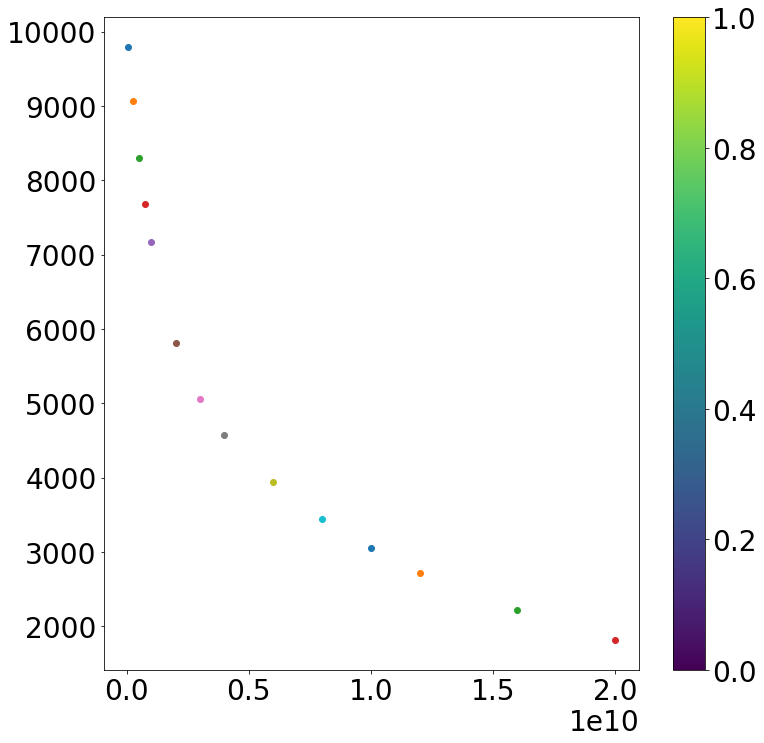

In [19]:
def plot_for_individual_bvecs(dirs_bs):

    fig = plt.figure(figsize=(12, 12))

    # to cpu
    bvecs_oi = experiment.b_vectors.to('cpu').numpy()#[1:] # discard [0, 0, 0]
    bvals = experiment.b_values_unique.to('cpu').numpy()#[1:]

    dir_fiber = [0, 0, 1]

    for i, path_Bfield in enumerate(paths_Bfields[:1]):
        
        for bval in bvals:
            
            mask_bvals = (experiment.b_values == bval).to('cpu').numpy()
            print('mask_bvals.shape', mask_bvals.shape)
            
            if np.sum(mask_bvals) == 1:
                continue
            
            angles_bvecs = get_angles_between_vectors(bvecs_oi[mask_bvals, :], dir_fiber, symmetry_around_90=True)

            # color
    #         deg = float(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0])
    #         weight_color = deg / (np.pi/2)
    #         color = cmap(weight_color)
    
            # mask bvecs
            mask_bvec0 = np.argwhere(bvecs_oi == np.array([-0.984414, -0.077222,  0.158003]))[:, 0][::3]
            mask_bvec1 = np.argwhere(bvecs_oi == np.array([ 0.103765, -0.980428,  0.167311]))[:, 0][::3]
            mask_bvec2 = np.argwhere(bvecs_oi == np.array([0.141982, 0.181087, 0.973164]))[:, 0][::3]
            
            #print('mask_bvec0', mask_bvec0)
            #print('mask_bvals', mask_bvals)
            mask_net = np.intersect1d(np.argwhere(mask_bvals == True), mask_bvec0)
            #print('mask_net', mask_net)

            signals_oi = experiment.signals['susceptibility_contribution'][path_Bfield][mask_net].to('cpu').numpy()
            #print(signals_oi.shape)

            #### normalize
            #signals_oi = signals_oi / experiment.N
            #signals_oi = signals_oi / signals_oi[0]
            #print('HEREEEEEEE', signals_oi)
            ####
            
            plt.scatter([bval, ]*len(signals_oi), signals_oi, 
                             #c=angles_bvecs[mask_net], marker='o', #ls='--', lw=3, markeredgewidth=3,
                             #label=r'$\theta$ ='+f'{np.round(np.degrees(deg)).astype(int)} deg'
                            )
    plt.colorbar()

    
plot_for_individual_bvecs([[1, 0, 0], [0, 1, 0], [0, 0, 1]], 
                          )

mask_bvals.shape (281,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)
mask_bvals.shape (281,)
(20,)


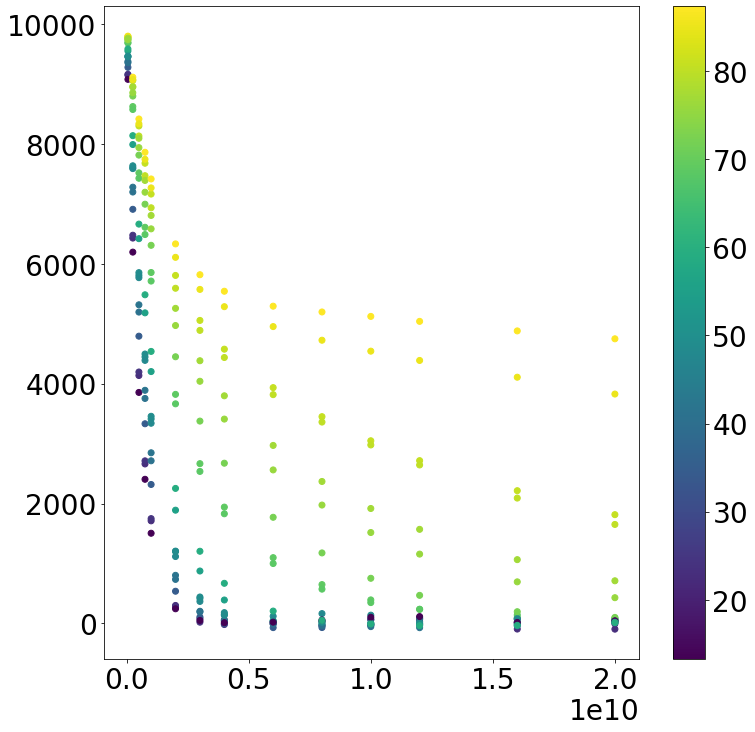

In [20]:
def plot_for_individual_bvecs(dirs_bs):

    fig = plt.figure(figsize=(12, 12))

    # to cpu
    bvecs_oi = experiment.b_vectors.to('cpu').numpy()#[1:] # discard [0, 0, 0]
    bvals = experiment.b_values_unique.to('cpu').numpy()#[1:]

    dir_fiber = [0, 0, 1]

    for i, path_Bfield in enumerate(paths_Bfields[:1]):
        
        for bval in bvals:
            
            mask_bvals = (experiment.b_values == bval).to('cpu').numpy()
            print('mask_bvals.shape', mask_bvals.shape)
            
            if np.sum(mask_bvals) == 1:
                continue
            
            angles_bvecs = get_angles_between_vectors(bvecs_oi[mask_bvals, :], dir_fiber, symmetry_around_90=True)

            signals_oi = experiment.signals['susceptibility_contribution'][path_Bfield][mask_bvals].to('cpu').numpy()
            print(signals_oi.shape)

            #### normalize
            #signals_oi = signals_oi / experiment.N
            #signals_oi = signals_oi / signals_oi[0]
            #print('HEREEEEEEE', signals_oi)
            ####
            
            plt.scatter([bval, ]*len(signals_oi), signals_oi, 
                             c=angles_bvecs, marker='o', #ls='--', lw=3, markeredgewidth=3,
                             #label=r'$\theta$ ='+f'{np.round(np.degrees(deg)).astype(int)} deg'
                            )
    plt.colorbar()

    
plot_for_individual_bvecs([[1, 0, 0], [0, 1, 0], [0, 0, 1]], 
                          )

In [18]:
bvecs_oi

NameError: name 'bvecs_oi' is not defined

In [ ]:
xs = np.linspace(0, np.pi/2, 100)
plt.plot(xs, np.cos(xs))

xticks = np.linspace(0, np.pi/2, 4)
xticklabels = np.round(np.degrees(xticks)).astype(int)
plt.xticks(xticks, xticklabels)
plt.xlabel(r'$\theta$ [deg]')

yticks = np.cos(xticks)
yticklabels = ['%.2f' %tick for tick in yticks]#np.round(yticks, 2)
plt.yticks(yticks, yticklabels)
plt.ylabel(r'cos($\theta$) [-]')

plt.grid(True)

In [130]:
bvecs_oi_y = np.dot(M(axis_rotation=[1, 0, 0], theta=np.pi/2), bvecs_oi.T).T
bvecs_oi_y

array([[-0.162906,  0.653943,  0.738796],
       [ 0.984414,  0.158003,  0.077222],
       [ 0.137451,  0.919784,  0.367565],
       [-0.638312,  0.744762, -0.194649],
       [-0.620031,  0.357083,  0.698608],
       [ 0.396767,  0.910881, -0.113453],
       [ 0.891948,  0.04643 , -0.449748],
       [-0.470959,  0.822129,  0.319846],
       [ 0.013626,  0.369296, -0.929212],
       [ 0.75748 ,  0.562697, -0.331054],
       [ 0.241207,  0.752476, -0.612861],
       [ 0.693352,  0.666104,  0.274896],
       [-0.835332,  0.307063, -0.455997],
       [-0.367183,  0.654826, -0.66059 ],
       [-0.103765,  0.167311,  0.980428],
       [-0.141982,  0.973164, -0.181087],
       [-0.452135,  0.086367, -0.887758],
       [ 0.782846,  0.222354,  0.581129],
       [ 0.532281,  0.244364, -0.810533],
       [ 0.364391,  0.515077,  0.775832],
       [-0.162906,  0.653943,  0.738796],
       [ 0.984414,  0.158003,  0.077222],
       [ 0.137451,  0.919784,  0.367565],
       [-0.638312,  0.744762, -0.1

In [131]:
bvecs_oi

array([[ 0.162906, -0.738796,  0.653943],
       [-0.984414, -0.077222,  0.158003],
       [-0.137451, -0.367565,  0.919784],
       [ 0.638312,  0.194649,  0.744762],
       [ 0.620031, -0.698608,  0.357083],
       [-0.396767,  0.113453,  0.910881],
       [-0.891948,  0.449748,  0.04643 ],
       [ 0.470959, -0.319846,  0.822129],
       [-0.013626,  0.929212,  0.369296],
       [-0.75748 ,  0.331054,  0.562697],
       [-0.241207,  0.612861,  0.752476],
       [-0.693352, -0.274896,  0.666104],
       [ 0.835332,  0.455997,  0.307063],
       [ 0.367183,  0.66059 ,  0.654826],
       [ 0.103765, -0.980428,  0.167311],
       [ 0.141982,  0.181087,  0.973164],
       [ 0.452135,  0.887758,  0.086367],
       [-0.782846, -0.581129,  0.222354],
       [-0.532281,  0.810533,  0.244364],
       [-0.364391, -0.775832,  0.515077],
       [ 0.162906, -0.738796,  0.653943],
       [-0.984414, -0.077222,  0.158003],
       [-0.137451, -0.367565,  0.919784],
       [ 0.638312,  0.194649,  0.7

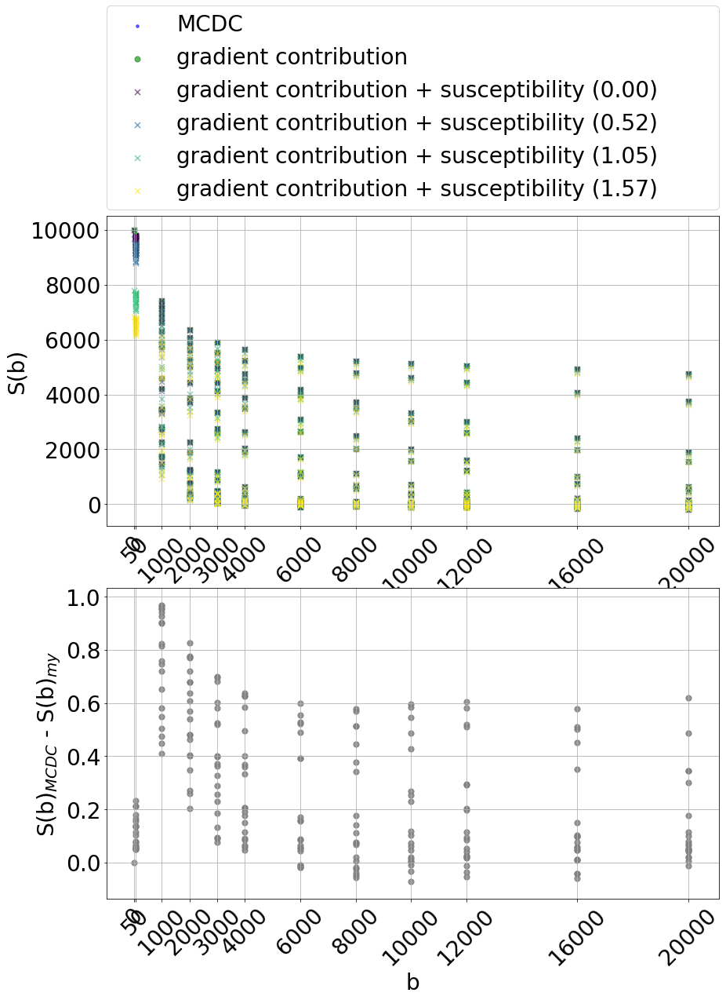

In [18]:
cmap = plt.cm.get_cmap('viridis')

for key, experiment in experiments.items():

    fig, axs = plt.subplots(2, 1, figsize=(14, 16))

    for b_value_oi in experiment.b_values_unique:

        signals_oi_MCDC = experiment.signals_MCDC[experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_MCDC[b_values == b_values_unique[0]]
        bs_MCDC = np.ones(np.shape(signals_oi_MCDC)) * b_value_oi.to('cpu').numpy()
        axs[0].scatter(bs_MCDC, signals_oi_MCDC, marker='.', c='blue', alpha=0.6, s=50, label='MCDC')

        signals_oi_gc = experiment.signals['gradient_contribution'][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_my_gradient[b_values == b_values_unique[0]]
        bs_gc = np.ones(np.shape(signals_oi_gc)) * b_value_oi.to('cpu').numpy()
        axs[0].scatter(bs_gc, signals_oi_gc.to('cpu').numpy(), marker='o', c='green', alpha=0.6, s=50, label='gradient contribution')

        residuals = signals_oi_MCDC - signals_oi_gc.to('cpu').numpy()
        axs[1].scatter(bs_MCDC, residuals, marker='o', c='gray', alpha=0.6, s=50)
        axs[1].scatter(bs_gc, residuals, marker='o', c='gray', alpha=0.6, s=50)

        for i, path_Bfield in enumerate(paths_Bfields):
            # coloring
            weight_color = float(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0]) / (np.pi/2)
            color = cmap(weight_color)
            # signals
            signals_oi_sus = experiment.signals['susceptibility_contribution'][path_Bfield][experiment.b_values.to('cpu').numpy() == b_value_oi.to('cpu').numpy()] #/ signals_my_susceptibility[b_values == b_values_unique[0]]
            bs_sus = np.ones(np.shape(signals_oi_sus)) * b_value_oi.to('cpu').numpy()
            # plotting
            axs[0].scatter(bs_sus, signals_oi_sus.to('cpu').numpy(), marker='x', 
                           color=color, alpha=0.6, s=50, 
                           label='gradient contribution + susceptibility')

    axs[0].set_ylabel('S(b)')
    axs[1].set_ylabel('S(b)$_{MCDC}$ - S(b)$_{my}$')
    axs[1].set_xlabel('b')

    axs[0].grid(True)
    axs[1].grid(True)

    #axs[0].legend(['MCDC', 'gradient contribution'] + ['gradient contribution + susceptibility (%s)' %(tag.split('/')[-1]) for tag in paths_Bfields], bbox_to_anchor=(0., 1.02, 1., .102), loc='lower left', ncol=1, mode="expand", borderaxespad=0.)
    axs[0].legend(['MCDC', 'gradient contribution'] + ['gradient contribution + susceptibility (%s)' %(paths_Bfields[i].split('B_z_angle=')[-1].split('.pt')[0]) for i, tag in enumerate(paths_Bfields)], 
                  bbox_to_anchor=(0., 1.02, 1., .102), loc='lower left', ncol=1, mode="expand", borderaxespad=0.)
    
    #xs[0].set_title(key.split('/')[-2:])
    
    # xticks
    xticks = experiment.b_values_unique.cpu()
    xtick_labels = np.round(xticks  * 1e-6 / 10) * 10 # round to nearest 10
    for ax in axs:
        ax.set_xticks(xticks)
        ax.set_xticklabels(xtick_labels.numpy().astype(int), rotation=45)
    
    break

In [69]:
xticks = experiment.b_values_unique.cpu() * 1e-6

tensor([    0.0000,    49.9972,  3999.7217,  7999.4578, 11999.1485, 19998.6480])

In [72]:
xtick_labels = np.round(experiment.b_values_unique.cpu() * 1e-6 / 10) * 10
xtick_labels

tensor([    0.,    50.,  4000.,  8000., 12000., 20000.])